# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [22]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    #see video 1-lipschitz-continuity-enforcement 3.45
    penalty = torch.pow(gradient_norm.mean()-1.0, 2)
    #### END CODE HERE ####
    return penalty

In [23]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [26]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [27]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [46]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = (crit_fake_pred-crit_real_pred).mean() + gp*c_lambda
    #### END CODE HERE ####
    return crit_loss

In [47]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: 0.016191140357404946, critic loss: 0.5695869584251199


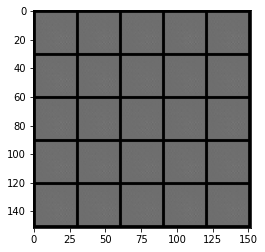

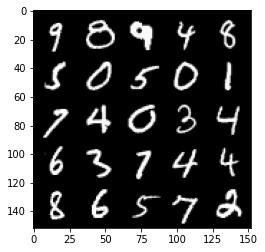

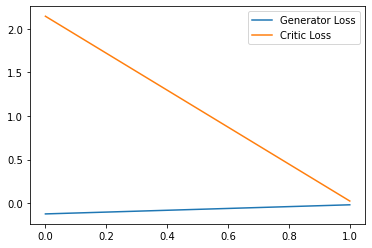

Step 100: Generator loss: 2.206559028029442, critic loss: -4.3174995740652085


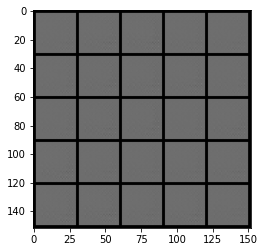

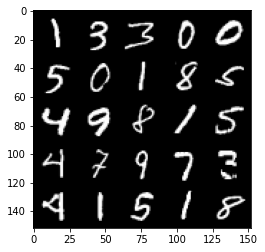

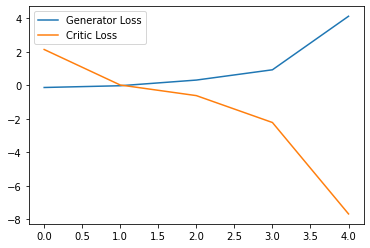

Step 150: Generator loss: 3.544680848121643, critic loss: -14.602911411285397


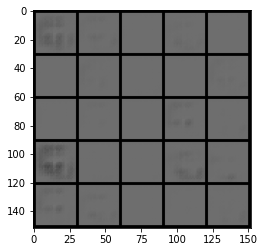

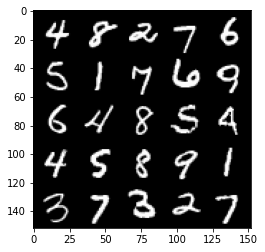

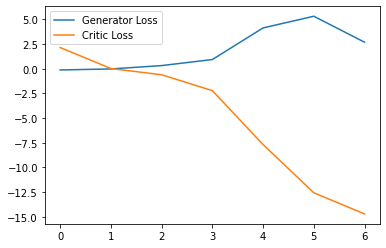

Step 200: Generator loss: 2.5278989267349243, critic loss: -29.488894294738767


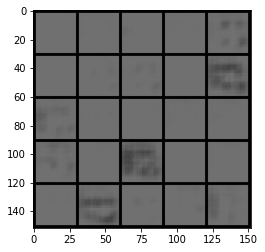

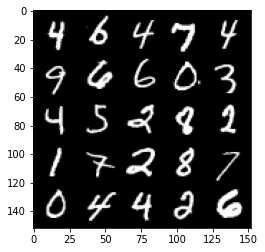

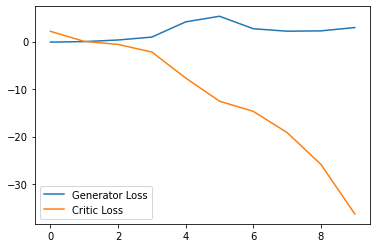

Step 250: Generator loss: 5.1176166915893555, critic loss: -60.21714056396484


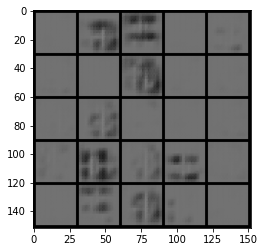

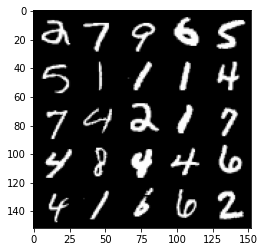

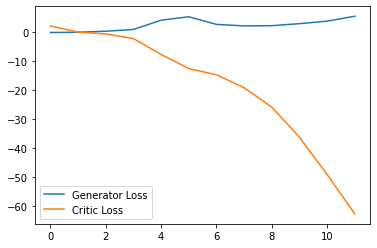

Step 300: Generator loss: 7.44852993965149, critic loss: -99.16382051086423


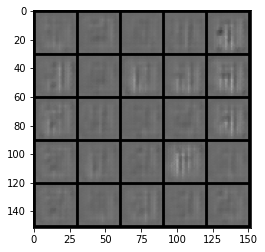

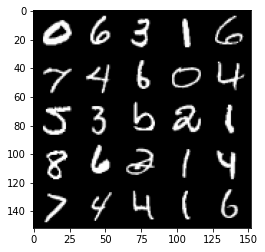

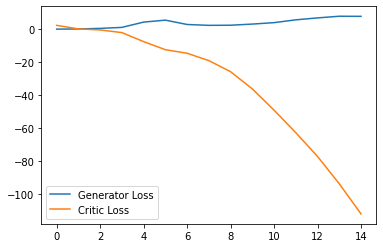

Step 350: Generator loss: 7.0805238699913025, critic loss: -138.72136953735352


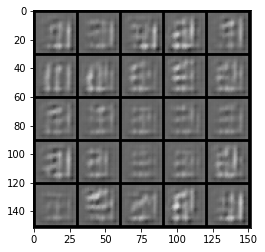

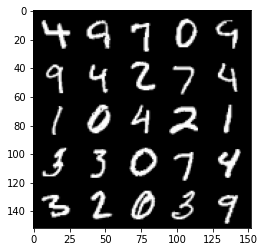

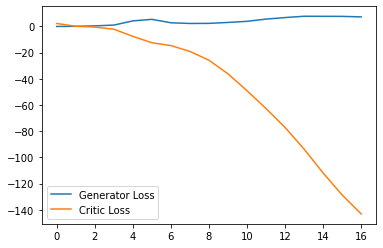

Step 400: Generator loss: -0.5581922686100006, critic loss: -140.69818276977534


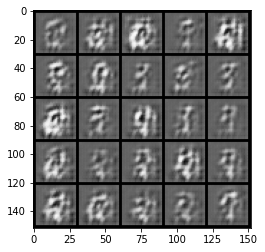

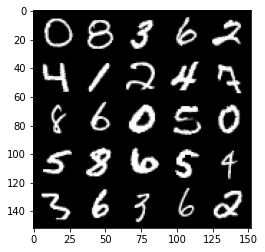

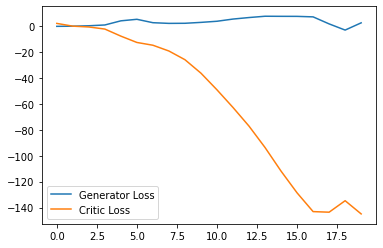

Step 450: Generator loss: -8.181879816055298, critic loss: -144.9672757110596


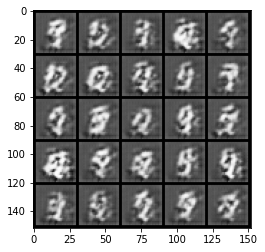

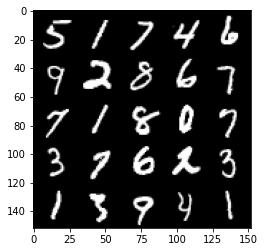

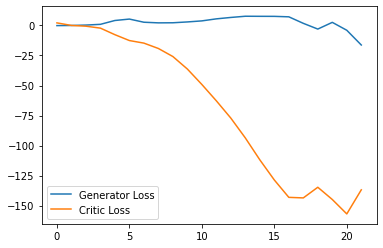

Step 500: Generator loss: -13.169082837104797, critic loss: -135.79328434753418


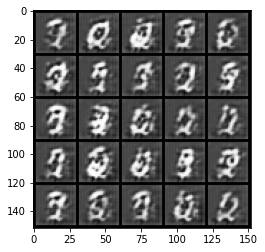

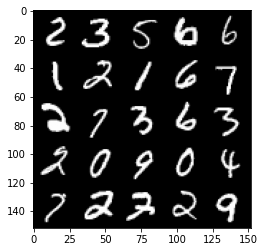

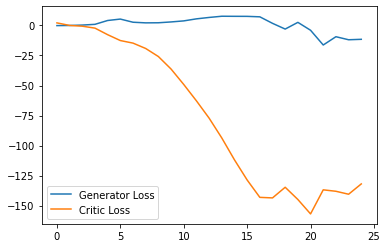

Step 550: Generator loss: -23.58185758113861, critic loss: -110.0499132385254


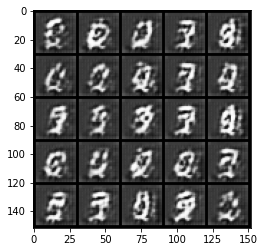

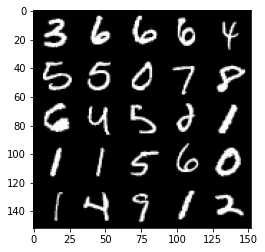

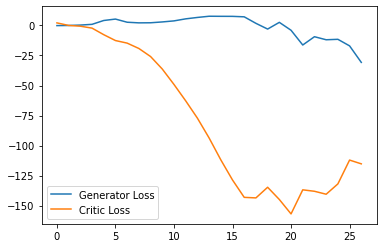

Step 600: Generator loss: -32.77590042710304, critic loss: -86.67692796325684


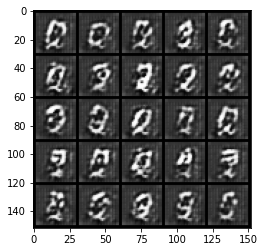

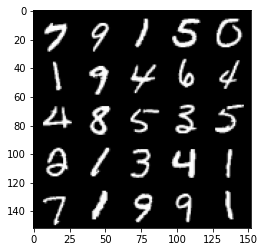

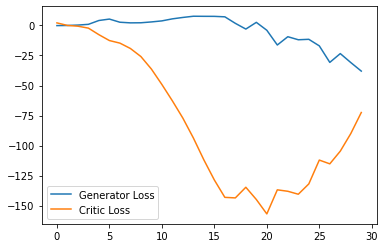

Step 650: Generator loss: -21.979530105590822, critic loss: -161.80421096801757


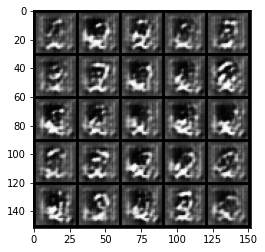

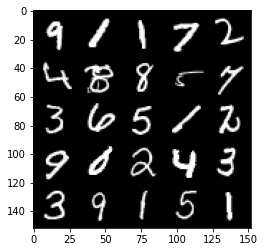

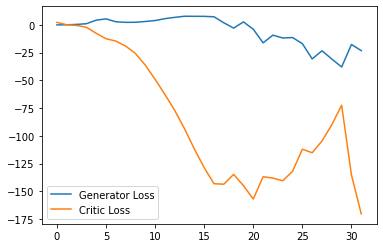

Step 700: Generator loss: -32.998157272338865, critic loss: -181.83423716735848


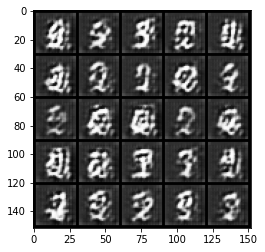

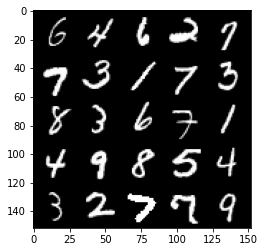

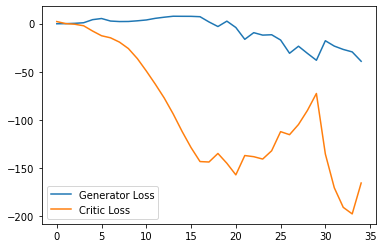

Step 750: Generator loss: -32.53817138671875, critic loss: -4.523983385562895


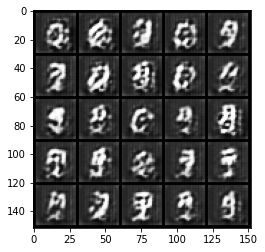

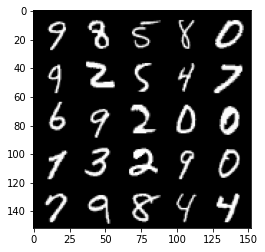

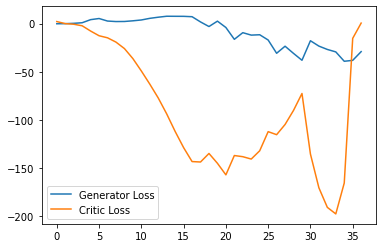

Step 800: Generator loss: -29.07199073791504, critic loss: -3.027299945354463


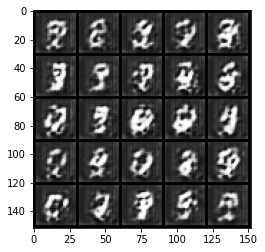

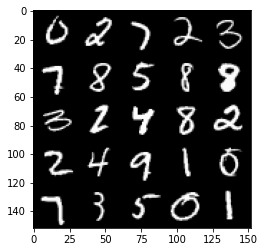

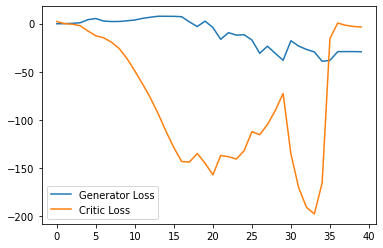

Step 850: Generator loss: -30.374586944580077, critic loss: -2.3646043787002564


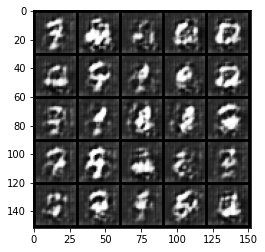

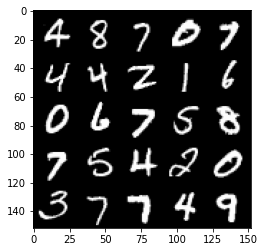

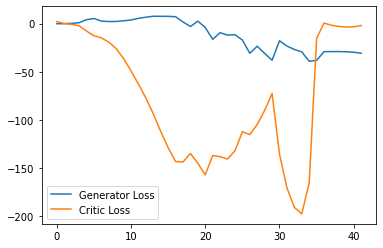

Step 900: Generator loss: -30.817902030944825, critic loss: -1.1794699048995965


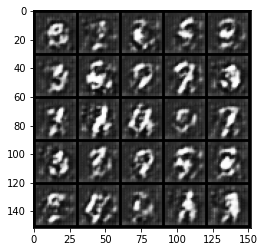

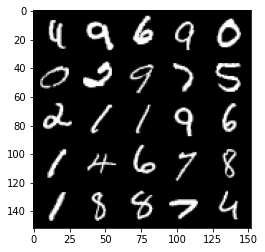

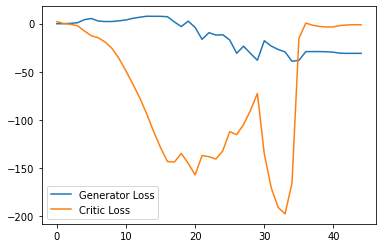

Step 950: Generator loss: -31.233047828674316, critic loss: -2.389288022518158


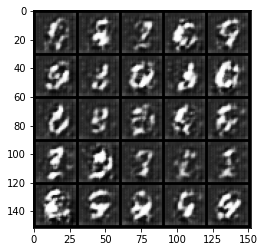

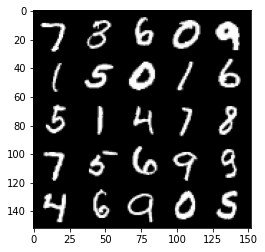

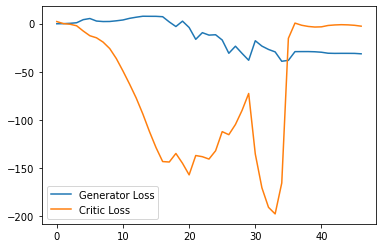

Step 1000: Generator loss: -32.20305145263672, critic loss: -3.7345494756698603


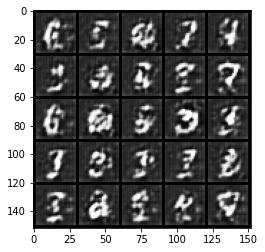

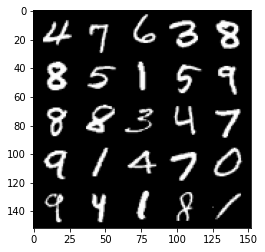

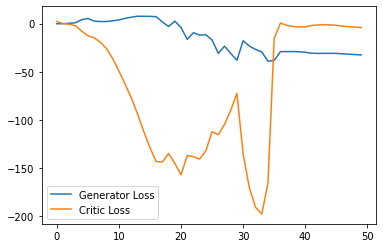

Step 1050: Generator loss: -32.90237602233887, critic loss: -5.67442122364044


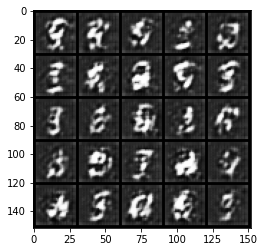

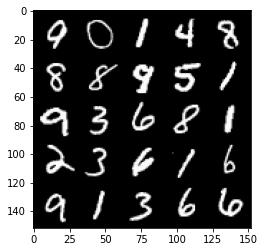

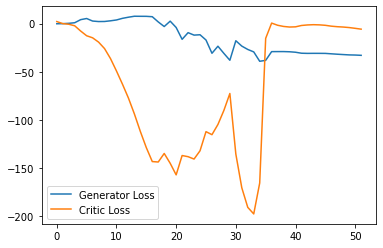

Step 1100: Generator loss: -35.61893898010254, critic loss: -13.342327333450312


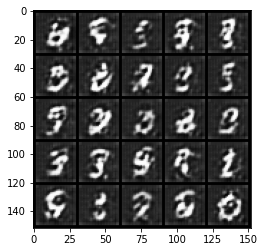

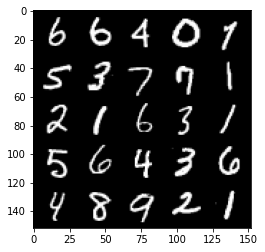

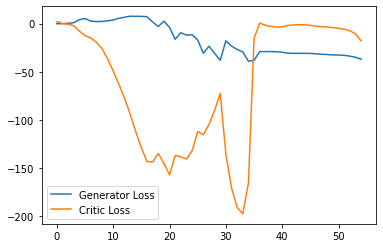

Step 1150: Generator loss: -41.509910621643066, critic loss: -32.19303824996948


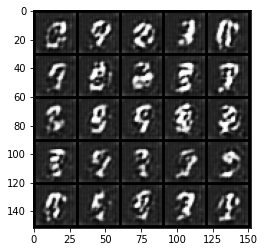

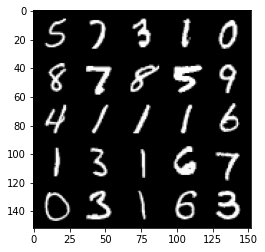

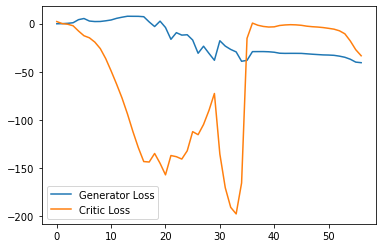

Step 1200: Generator loss: -38.324728751182555, critic loss: -19.253895933628083


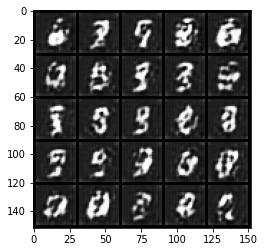

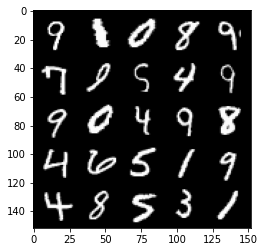

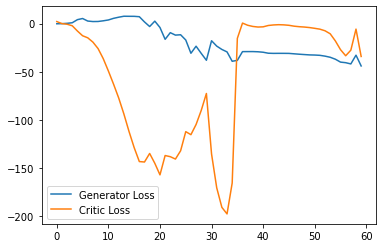

Step 1250: Generator loss: -45.47316783905029, critic loss: -30.442776166915895


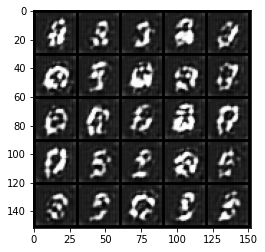

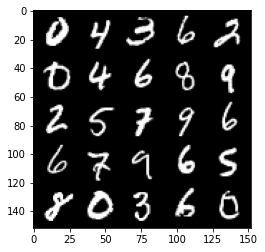

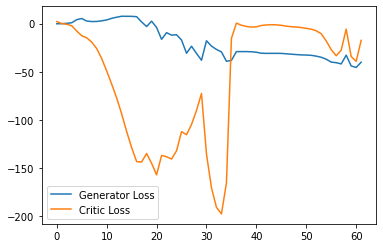

Step 1300: Generator loss: -33.23237106323242, critic loss: 1.838034365177157


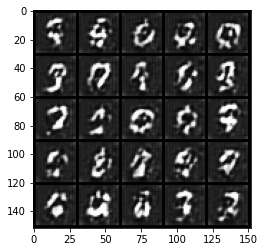

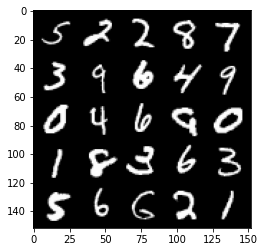

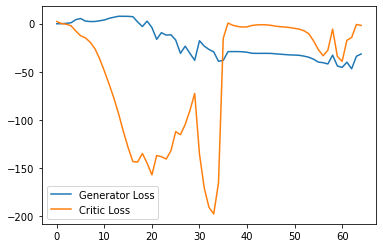

Step 1350: Generator loss: -33.67551849365234, critic loss: -4.027836024284362


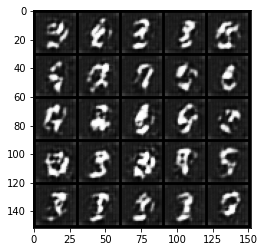

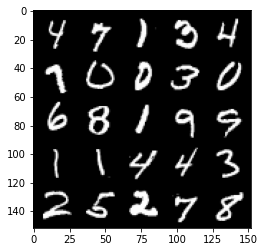

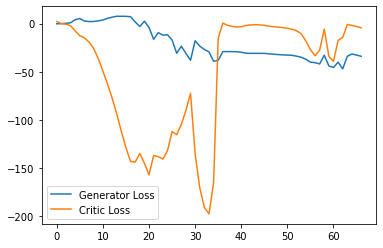

Step 1400: Generator loss: -45.476360397338865, critic loss: -24.910649505615233


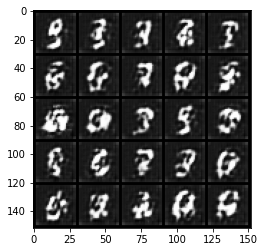

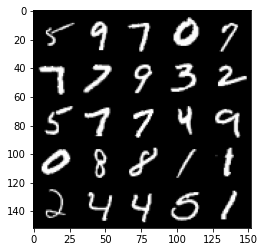

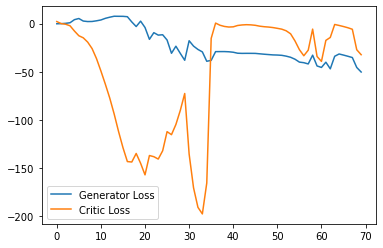

Step 1450: Generator loss: -54.19551727294922, critic loss: -37.70367483520508


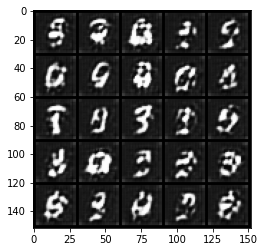

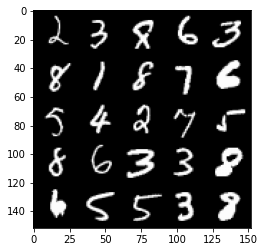

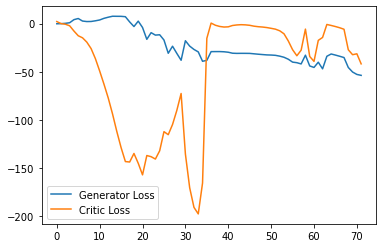

Step 1500: Generator loss: -40.52973648071289, critic loss: -8.989855503082277


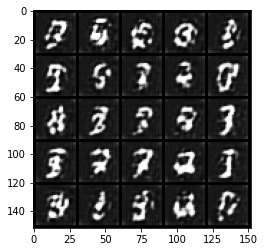

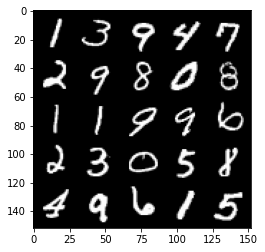

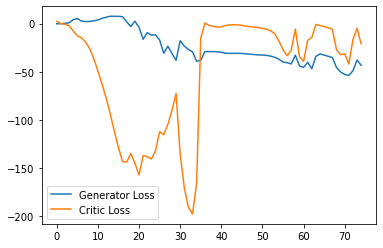

Step 1550: Generator loss: -40.124832229614256, critic loss: -5.9984698772430445


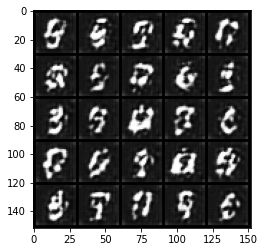

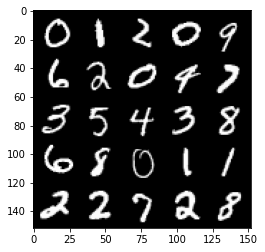

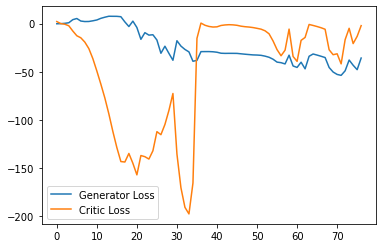

Step 1600: Generator loss: -35.59058464050293, critic loss: -3.132000397682191


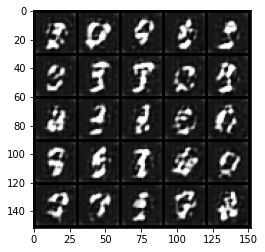

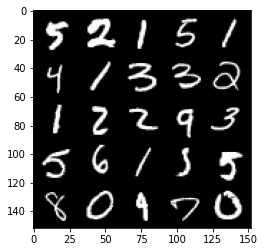

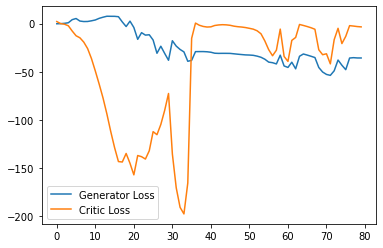

Step 1650: Generator loss: -36.278251037597656, critic loss: -4.072840517997741


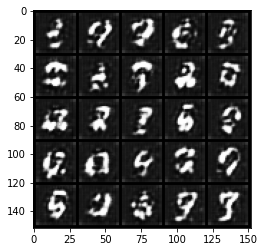

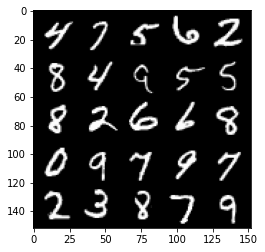

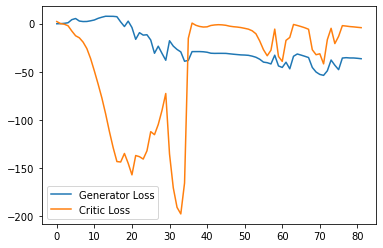

Step 1700: Generator loss: -36.92319946289062, critic loss: -4.805438622474671


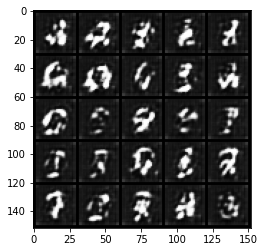

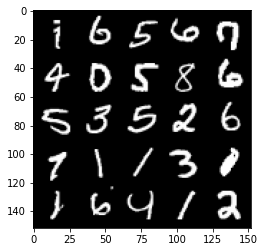

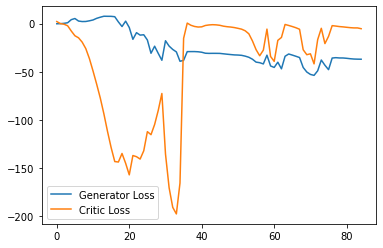

Step 1750: Generator loss: -42.05850357055664, critic loss: -8.976022518634796


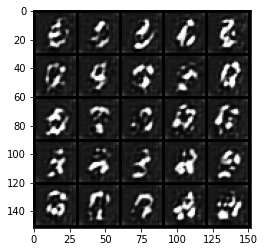

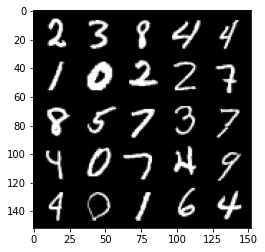

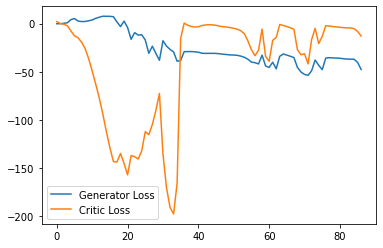

Step 1800: Generator loss: -38.61460754394531, critic loss: -11.595278298854826


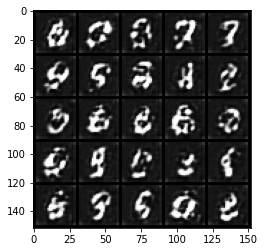

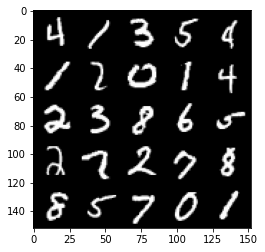

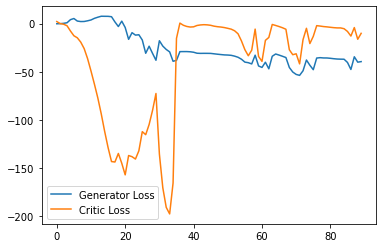

Step 1850: Generator loss: -44.78058540344238, critic loss: -21.04741793632507


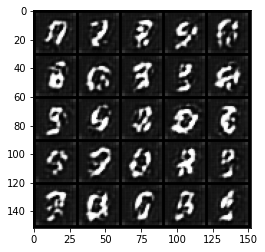

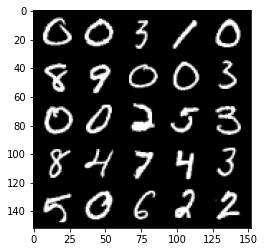

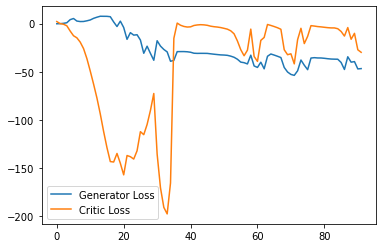

Step 1900: Generator loss: -33.10624328613281, critic loss: -3.7271185436248775


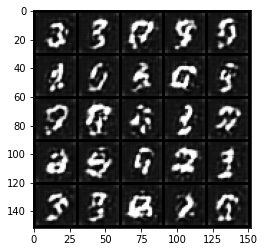

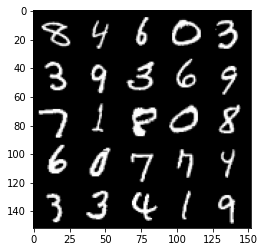

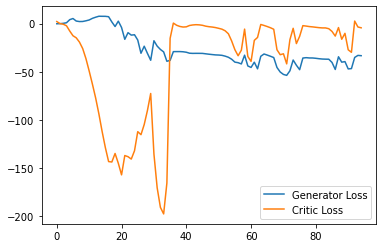

Step 1950: Generator loss: -40.923496856689454, critic loss: -17.89556149673462


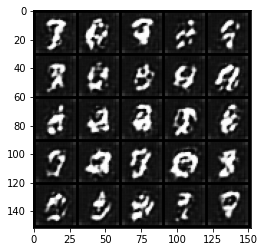

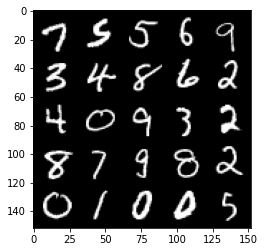

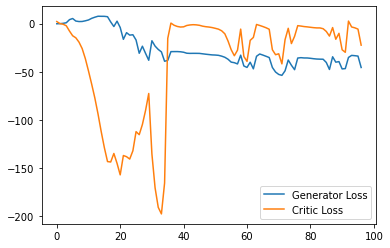

Step 2000: Generator loss: -45.652197265625, critic loss: -28.966601703643796


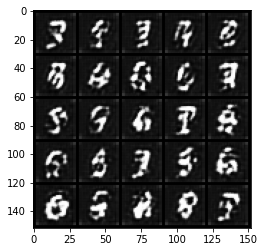

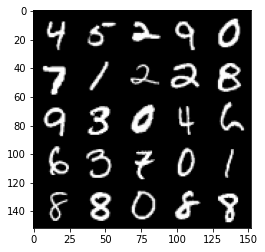

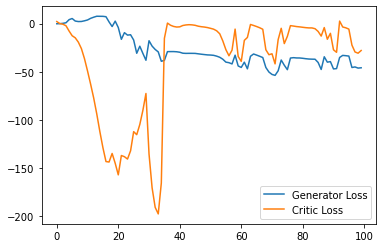

Step 2050: Generator loss: -32.730220336914066, critic loss: -7.8808431749343875


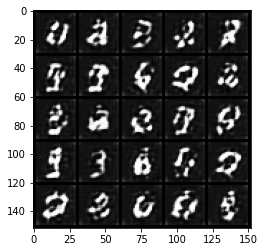

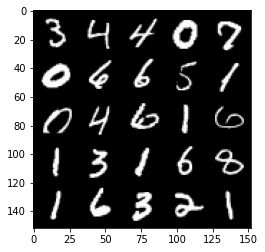

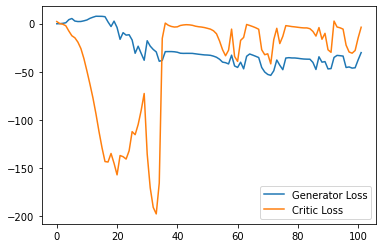

Step 2100: Generator loss: -36.23303085327149, critic loss: -15.782458274841309


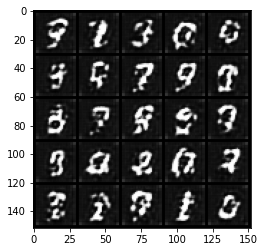

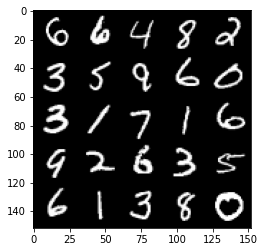

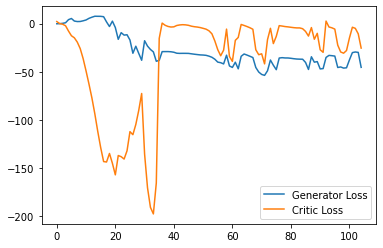

Step 2150: Generator loss: -37.074140014648435, critic loss: -17.570344190597535


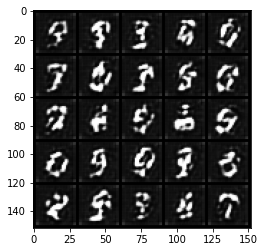

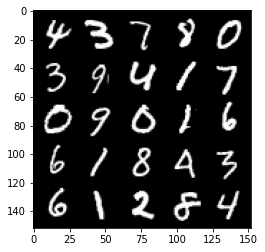

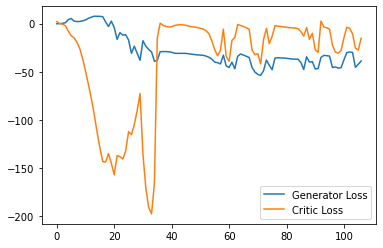

Step 2200: Generator loss: -33.94233963012695, critic loss: -19.111056204795833


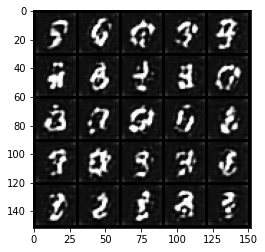

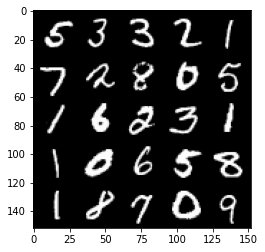

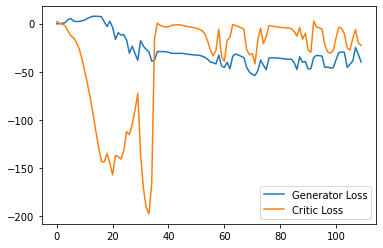

Step 2250: Generator loss: -29.81484380722046, critic loss: -18.2056321849823


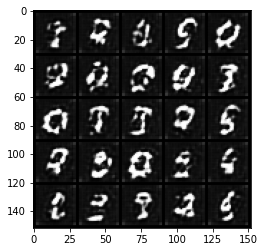

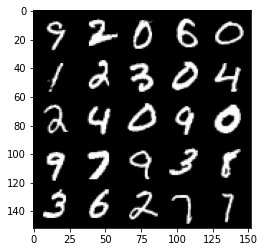

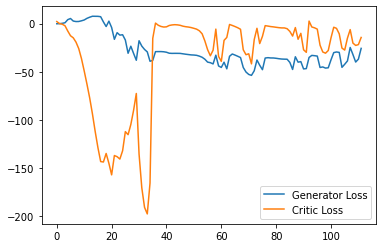

Step 2300: Generator loss: -34.05817878723145, critic loss: -6.7255707740783714


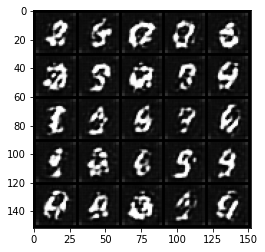

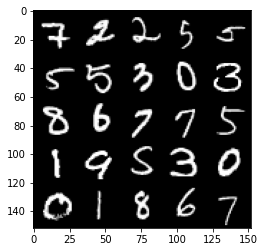

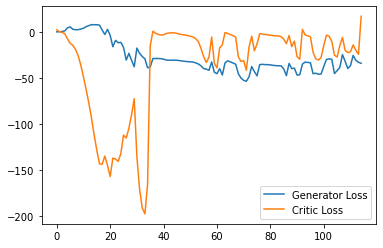

Step 2350: Generator loss: -22.193877906799315, critic loss: -1.954329634189606


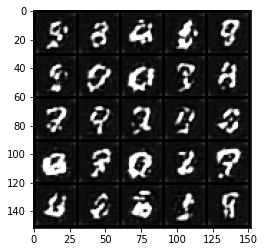

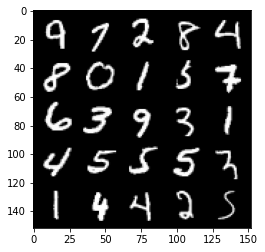

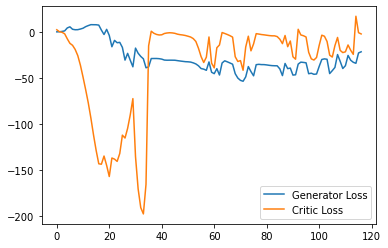

Step 2400: Generator loss: -22.97611644744873, critic loss: -2.9176901941299445


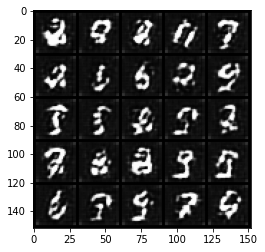

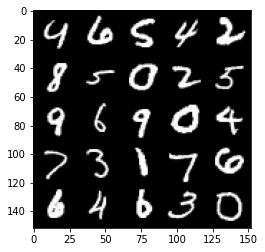

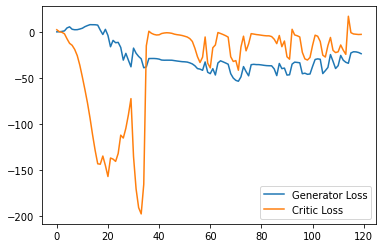

Step 2450: Generator loss: -27.151439399719237, critic loss: -3.0109290304183975


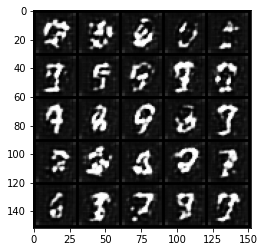

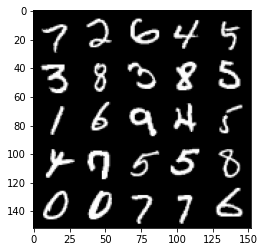

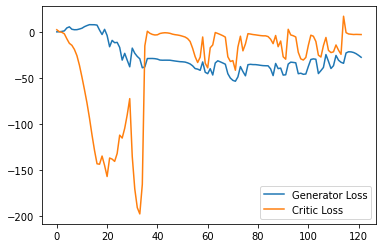

Step 2500: Generator loss: -30.628026695251464, critic loss: -3.2536161708831783


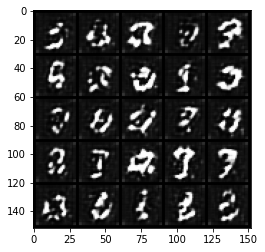

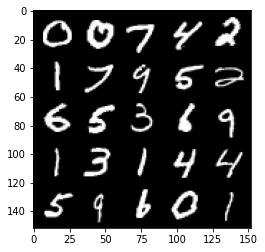

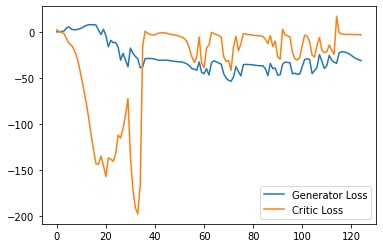

Step 2550: Generator loss: -31.948814849853516, critic loss: -4.4280023307800285


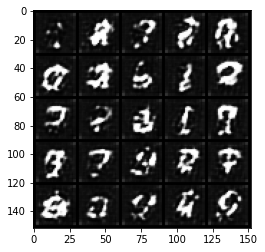

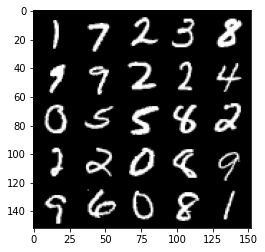

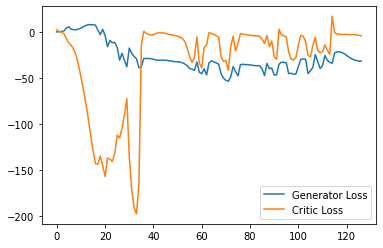

Step 2600: Generator loss: -38.51726245880127, critic loss: -18.028730356216435


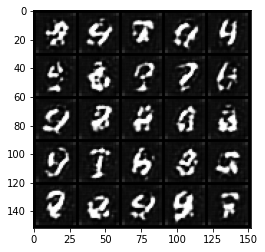

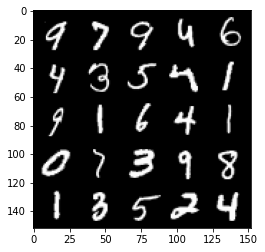

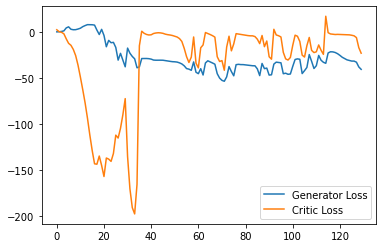

Step 2650: Generator loss: -36.94481735229492, critic loss: -20.668491353034973


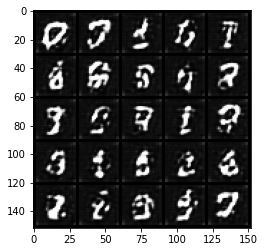

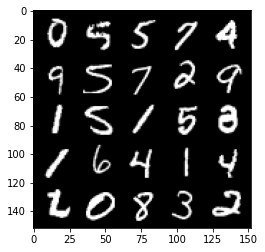

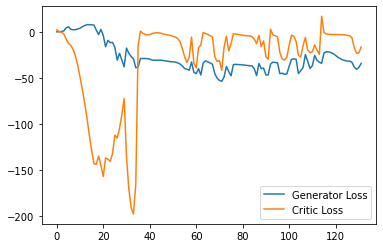

Step 2700: Generator loss: -37.49843450546265, critic loss: -24.248339251518246


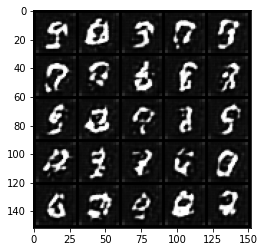

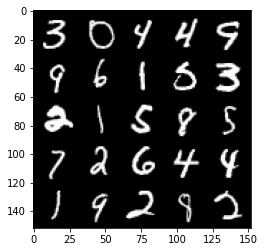

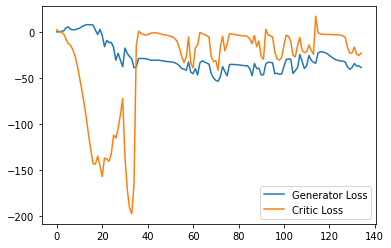

Step 2750: Generator loss: -32.82350727081299, critic loss: -22.640835188865662


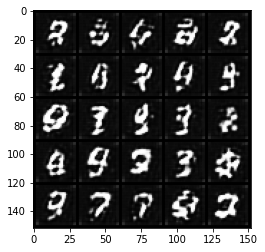

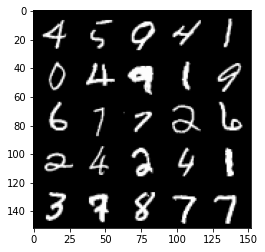

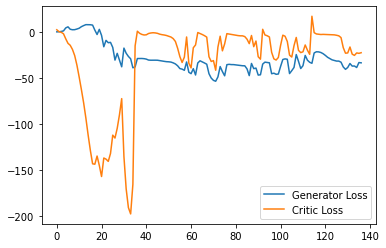

Step 2800: Generator loss: -32.17980422973633, critic loss: -24.668645586013803


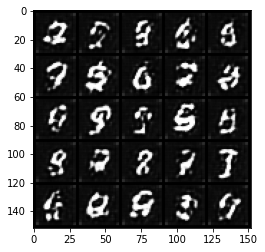

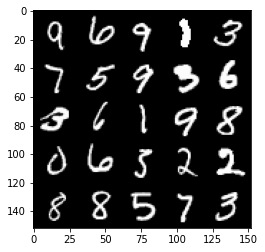

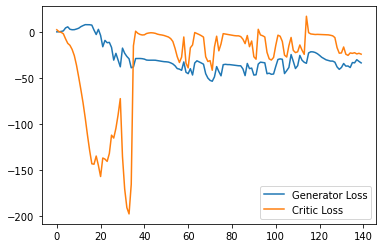

Step 2850: Generator loss: -30.9082412815094, critic loss: -24.246269755363468


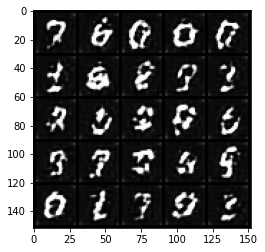

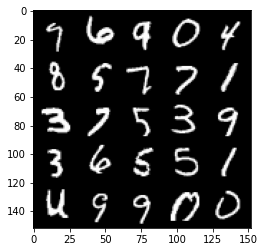

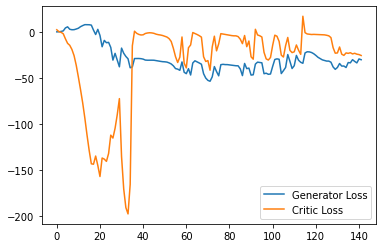

Step 2900: Generator loss: -25.90230068206787, critic loss: -9.90147016048431


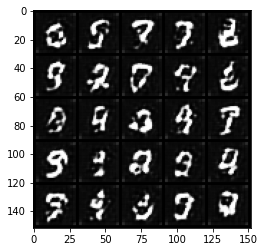

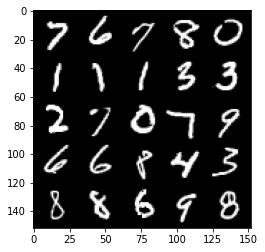

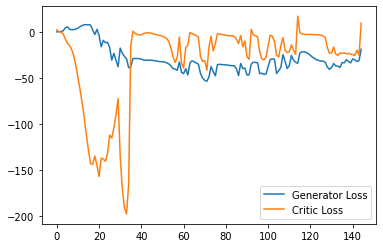

Step 2950: Generator loss: -14.480817279815675, critic loss: -2.640002596855163


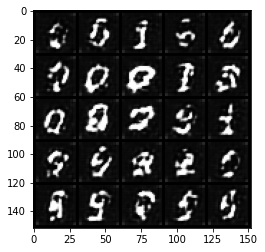

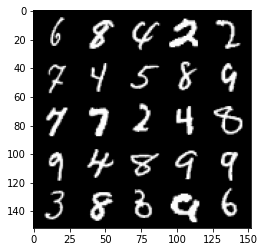

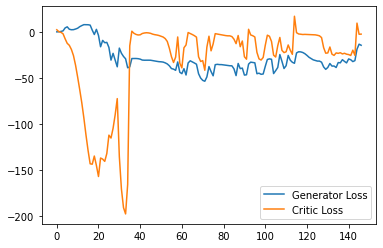

Step 3000: Generator loss: -17.116263847351075, critic loss: -2.691524103164673


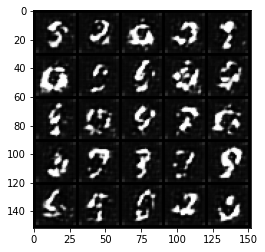

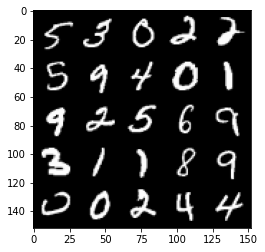

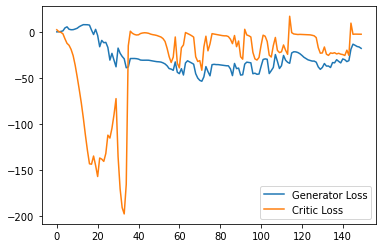

Step 3050: Generator loss: -26.855594940185547, critic loss: -2.660535643100739


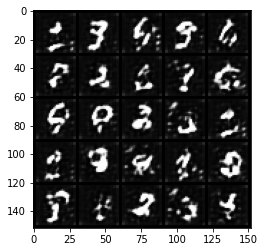

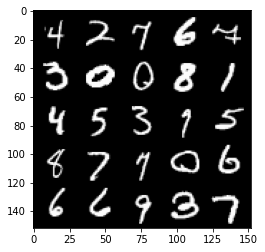

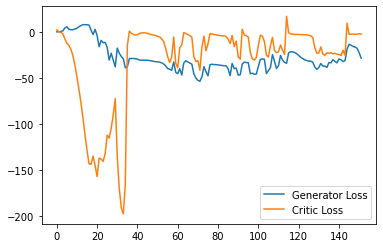

Step 3100: Generator loss: -31.944202728271485, critic loss: -9.685526032447815


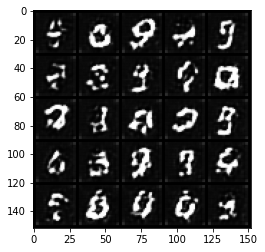

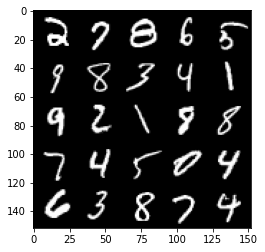

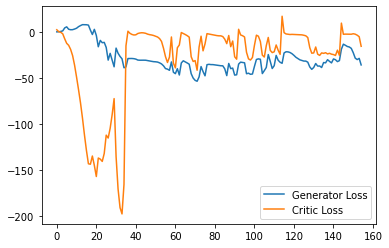

Step 3150: Generator loss: -31.016251106262207, critic loss: -11.905498620986936


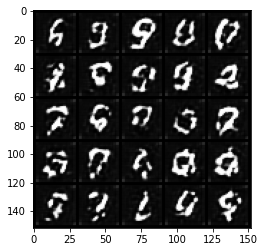

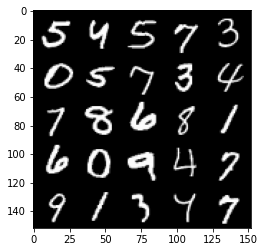

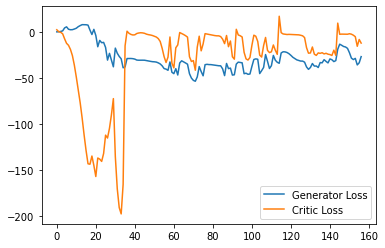

Step 3200: Generator loss: -31.97828104019165, critic loss: -19.55558533096313


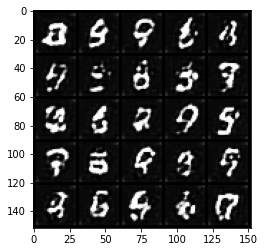

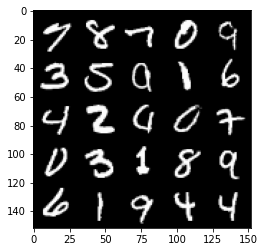

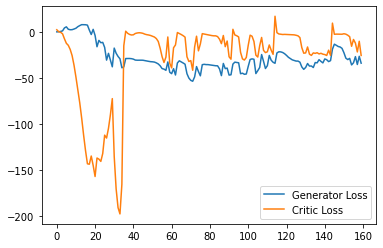

Step 3250: Generator loss: -31.761955347061157, critic loss: -24.78430492210388


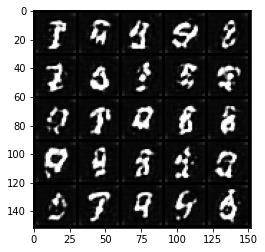

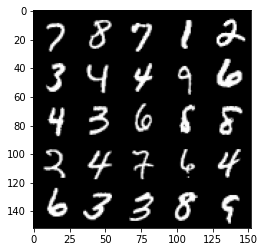

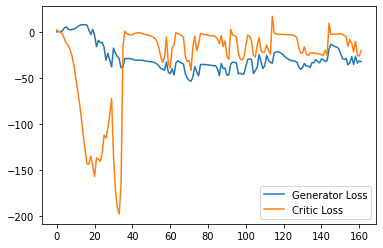

Step 3300: Generator loss: -18.958481101989747, critic loss: -0.7588246469497679


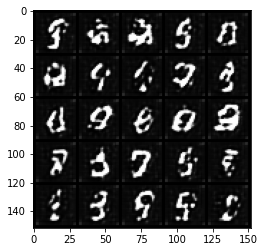

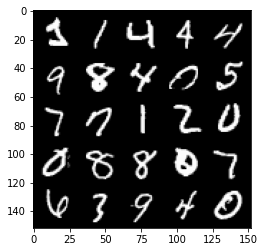

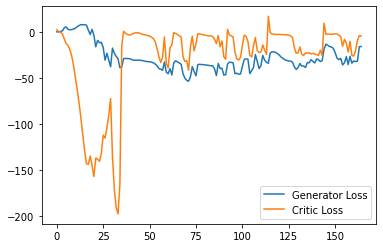

Step 3350: Generator loss: -17.26630220413208, critic loss: -7.761017406463622


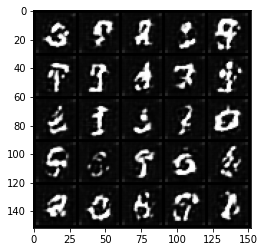

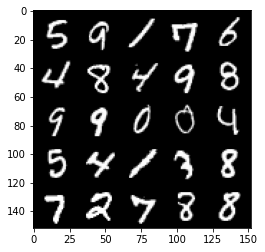

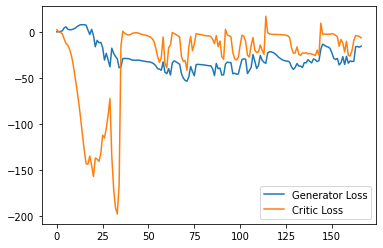

Step 3400: Generator loss: -30.633432273864745, critic loss: -23.853917328834523


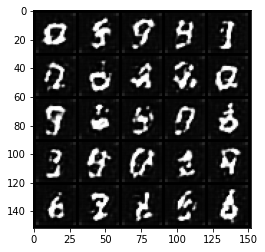

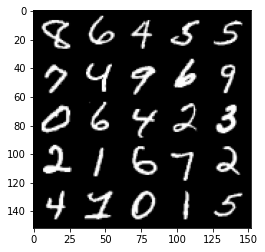

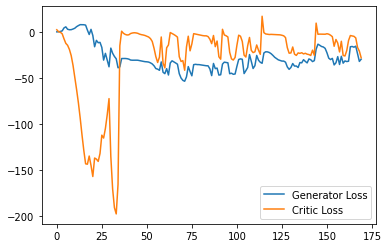

Step 3450: Generator loss: -22.73433777332306, critic loss: -18.816454764366146


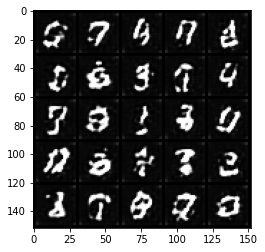

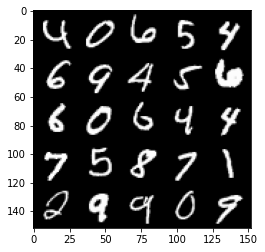

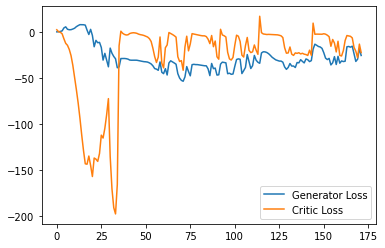

Step 3500: Generator loss: -30.20919599533081, critic loss: -23.871377203464508


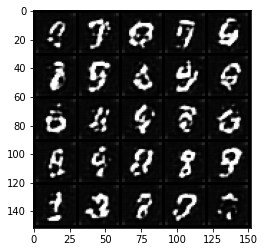

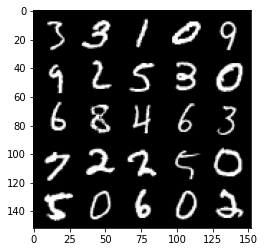

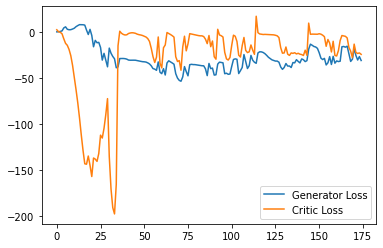

Step 3550: Generator loss: -17.69810560464859, critic loss: -9.856621505737303


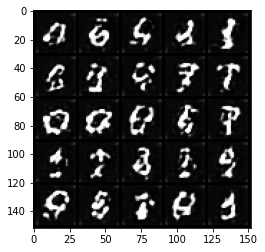

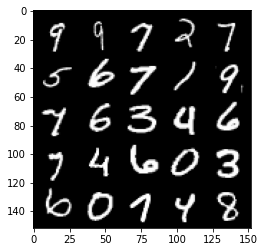

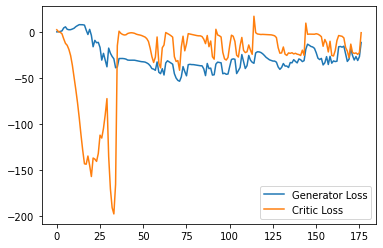

Step 3600: Generator loss: -17.43074529647827, critic loss: -9.865957757949829


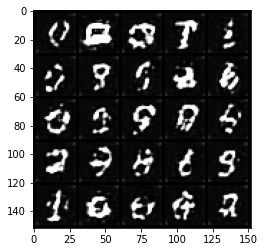

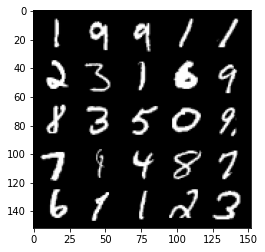

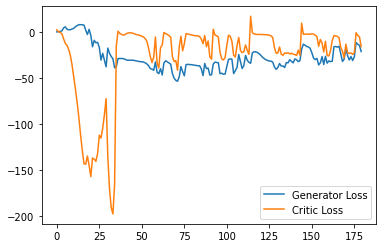

Step 3650: Generator loss: -26.40074188709259, critic loss: -23.096109013557438


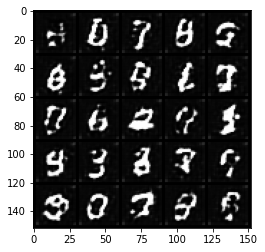

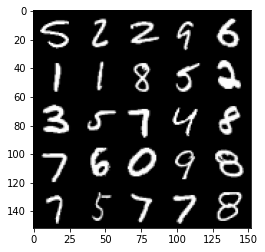

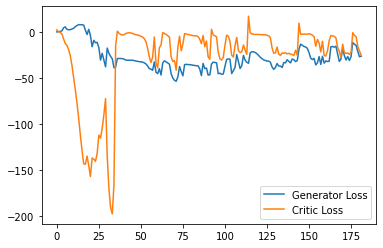

Step 3700: Generator loss: -22.60810770750046, critic loss: -21.95712408781052


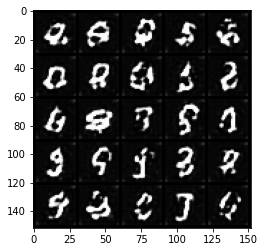

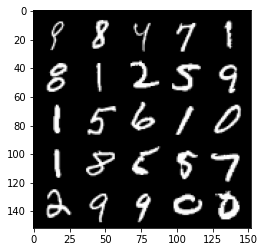

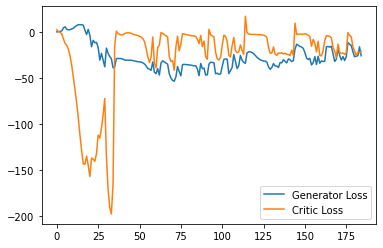

Step 3750: Generator loss: -24.7571711063385, critic loss: -22.387323600769047


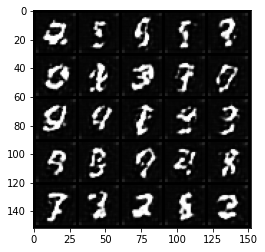

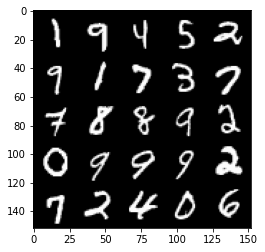

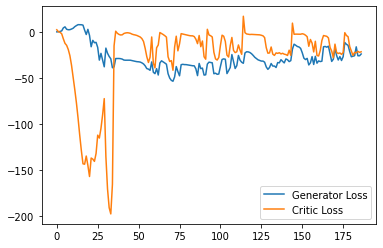

Step 3800: Generator loss: -13.760813865661621, critic loss: -6.4321547718048135


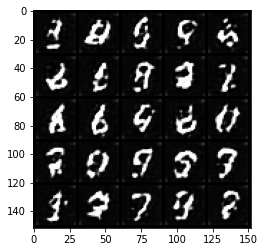

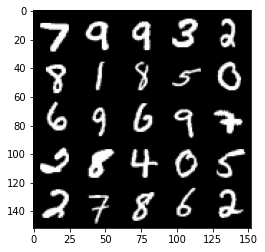

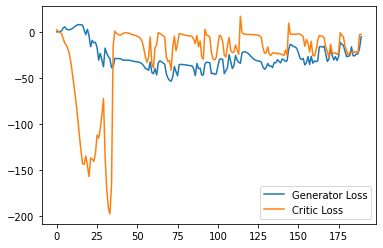

Step 3850: Generator loss: -5.468630771636963, critic loss: -3.5106319952011114


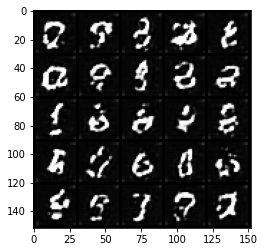

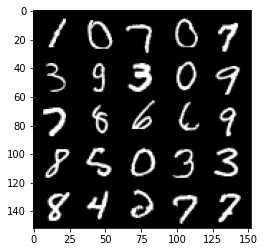

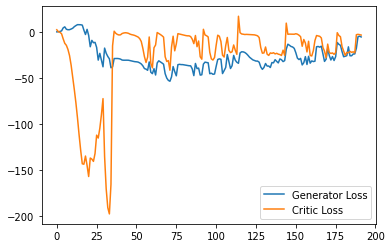

Step 3900: Generator loss: -7.306020593643188, critic loss: -4.414935320854187


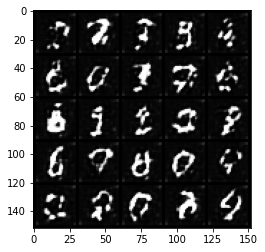

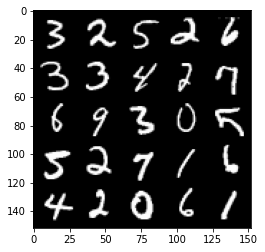

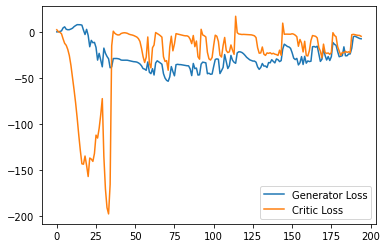

Step 3950: Generator loss: -17.209916849136352, critic loss: -16.90141243171692


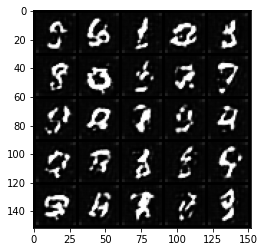

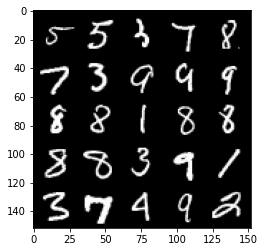

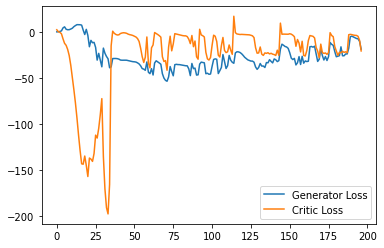

Step 4000: Generator loss: -18.260545318126677, critic loss: -20.461197542190554


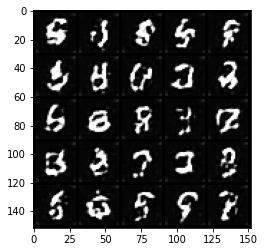

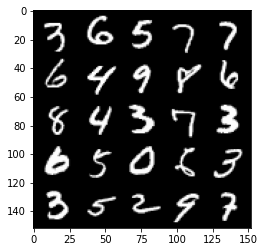

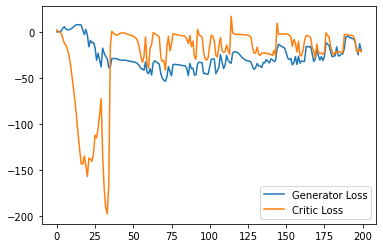

Step 4050: Generator loss: -12.132935477495193, critic loss: -15.842981387138368


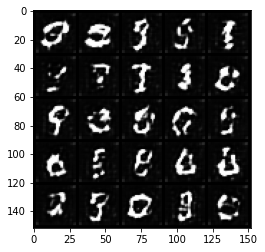

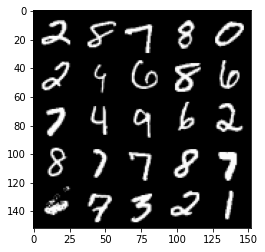

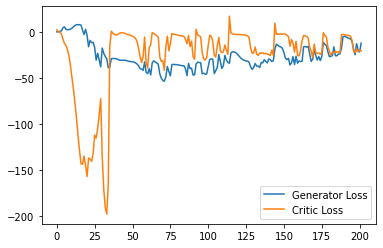

Step 4100: Generator loss: -18.62269909620285, critic loss: -19.83408440971374


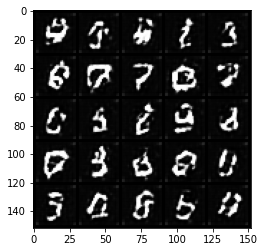

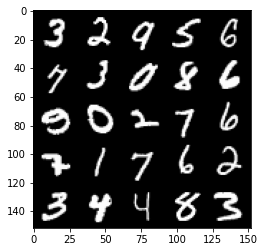

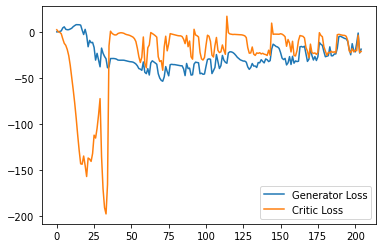

Step 4150: Generator loss: -13.030812387466431, critic loss: -12.955566715955738


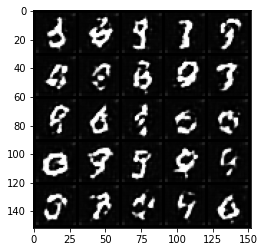

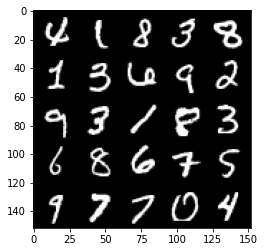

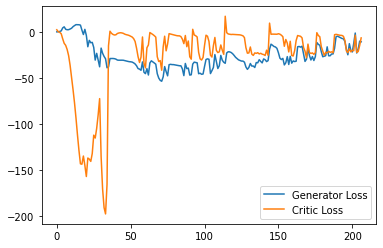

Step 4200: Generator loss: -15.496326901912688, critic loss: -25.003701489925383


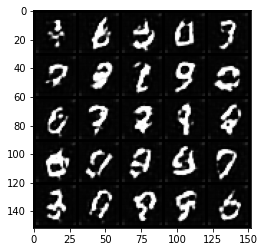

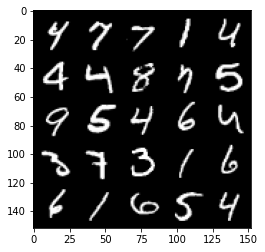

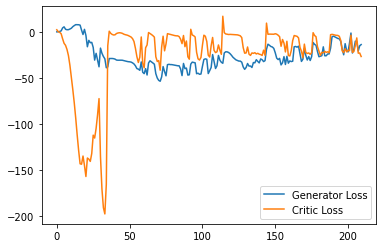

Step 4250: Generator loss: -9.884319248199462, critic loss: -18.263618218421932


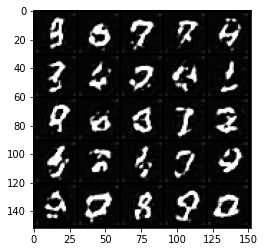

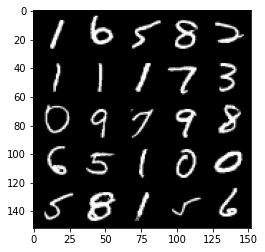

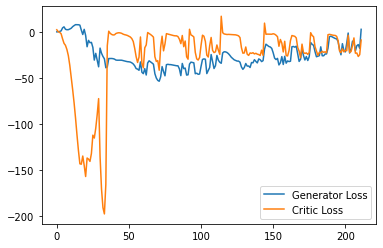

Step 4300: Generator loss: -9.137917304039002, critic loss: -17.160362349510194


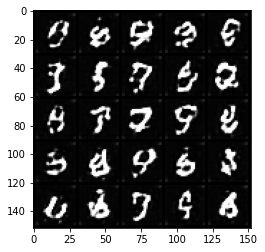

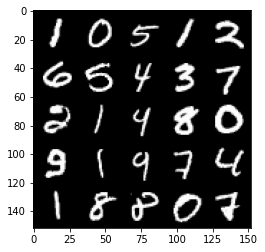

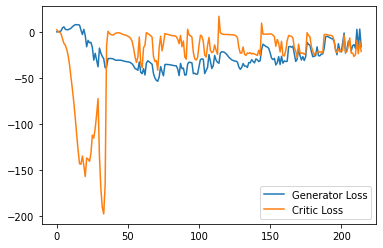

Step 4350: Generator loss: -10.969874734282493, critic loss: -23.021271517753597


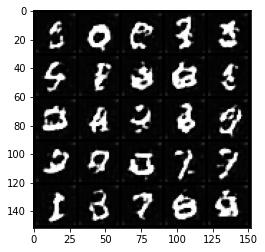

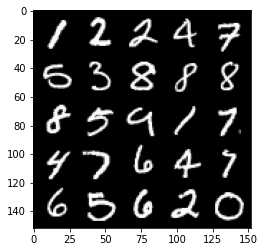

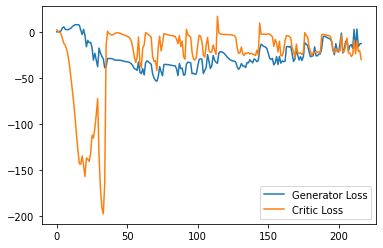

Step 4400: Generator loss: -10.237226541638375, critic loss: -20.458545090675358


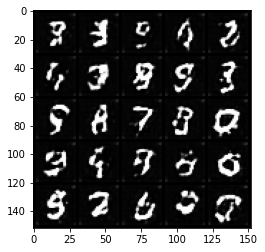

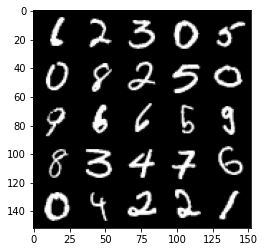

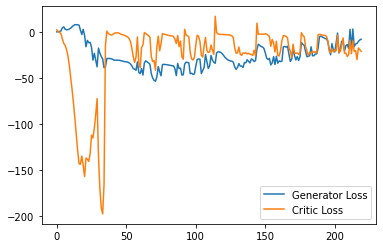

Step 4450: Generator loss: -11.045211106538773, critic loss: -17.55164015102387


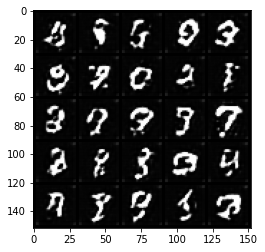

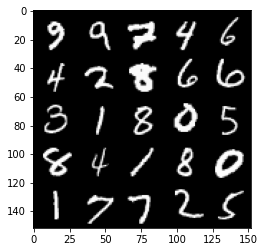

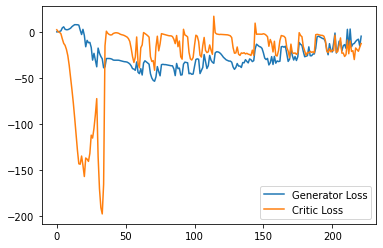

Step 4500: Generator loss: -1.1988916686177253, critic loss: -10.975465480804443


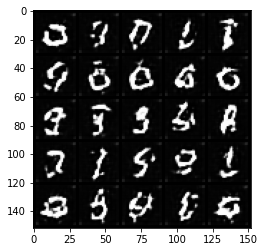

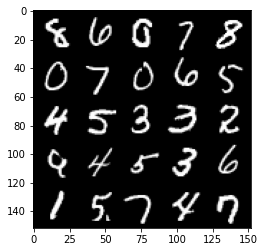

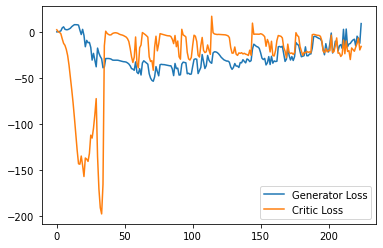

Step 4550: Generator loss: -0.2577087023854256, critic loss: -20.044245309352874


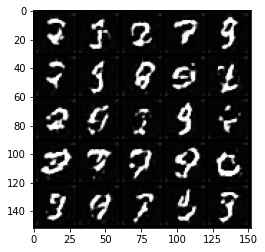

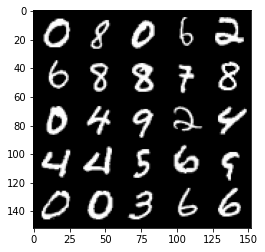

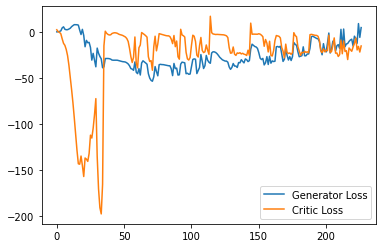

Step 4600: Generator loss: -7.284845454096794, critic loss: -27.803407997608186


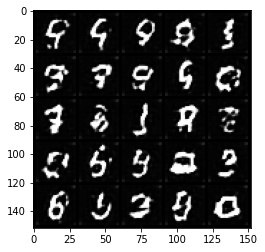

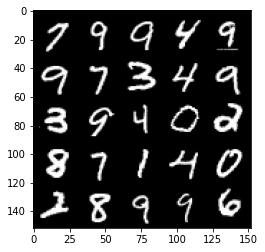

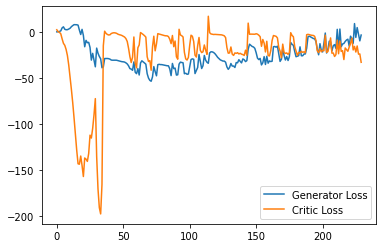

Step 4650: Generator loss: 0.05865760445594788, critic loss: -19.971888118267064


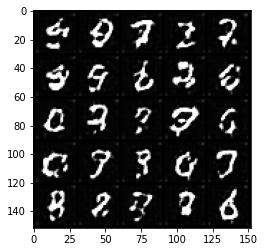

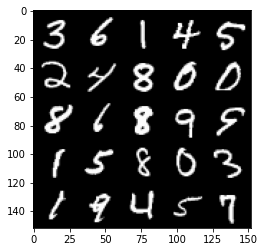

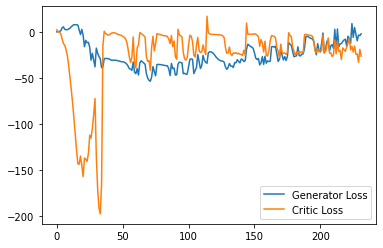

Step 4700: Generator loss: -2.2022830909490585, critic loss: -19.489399203300476


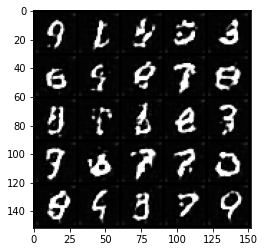

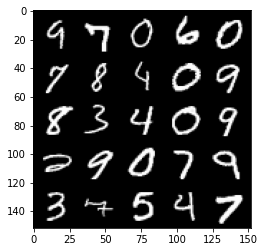

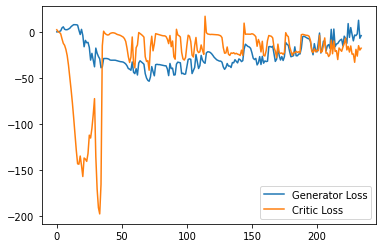

Step 4750: Generator loss: -3.4026762866973876, critic loss: -21.87976633405685


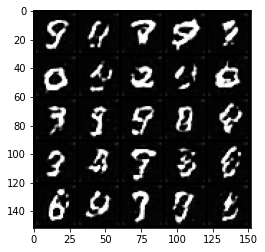

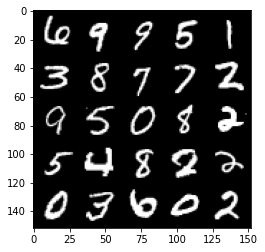

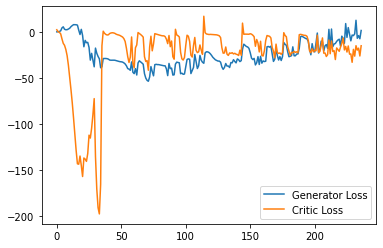

Step 4800: Generator loss: -5.5906297196447845, critic loss: -27.25187228417396


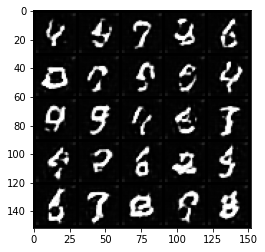

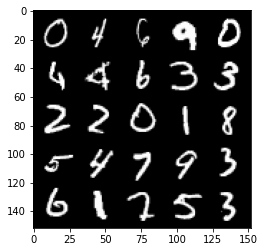

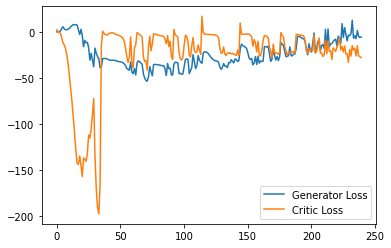

Step 4850: Generator loss: 3.4833574503660203, critic loss: -10.583704151630405


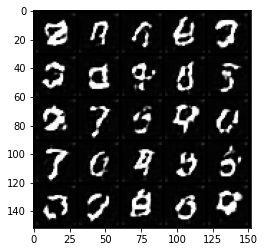

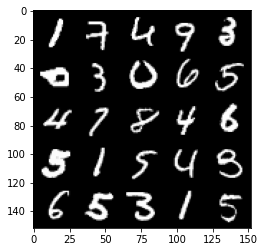

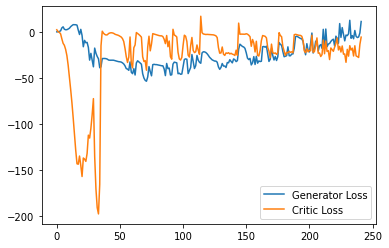

Step 4900: Generator loss: -0.17331699550151825, critic loss: -24.175030092239382


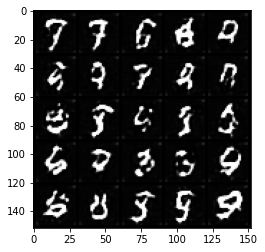

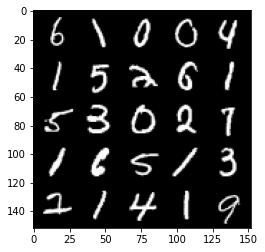

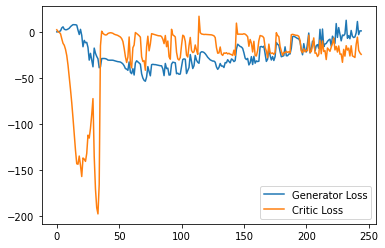

Step 4950: Generator loss: -0.15219033002853394, critic loss: -27.697394275188444


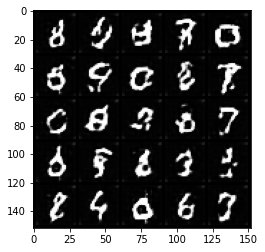

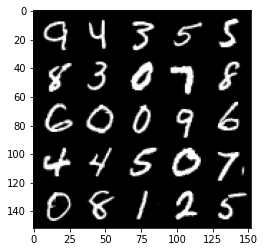

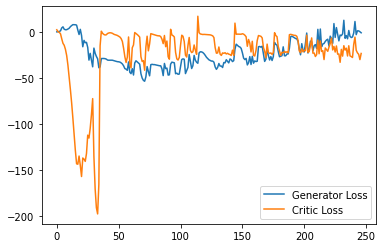

Step 5000: Generator loss: 3.409183660149574, critic loss: -22.496379714012146


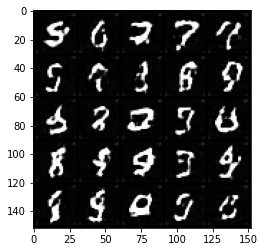

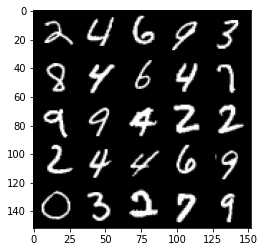

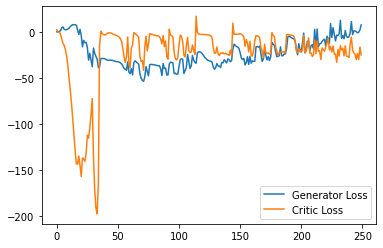

Step 5050: Generator loss: 7.758392672538758, critic loss: -19.329847529411314


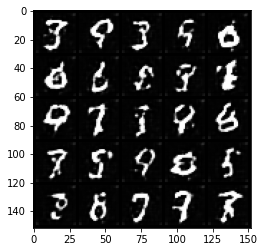

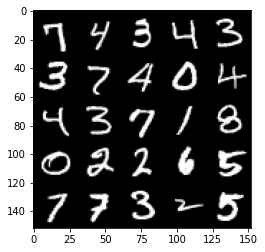

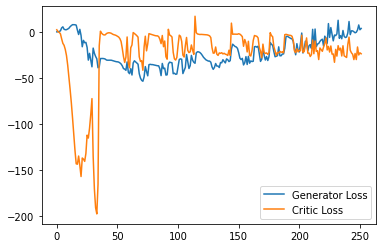

Step 5100: Generator loss: 3.2563077360391617, critic loss: -26.80681533741951


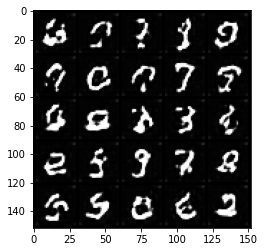

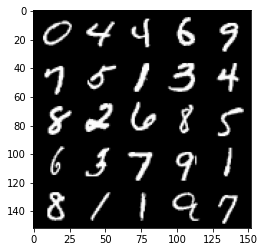

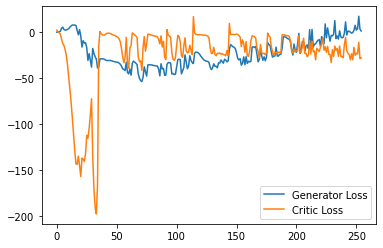

Step 5150: Generator loss: 4.43859031021595, critic loss: -28.59316045951843


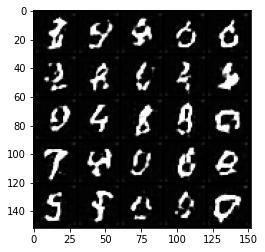

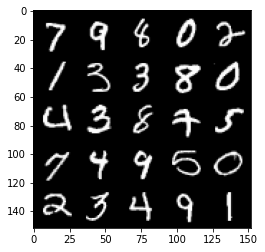

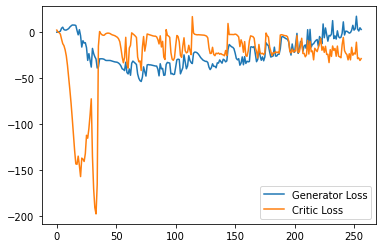

Step 5200: Generator loss: 14.46108937740326, critic loss: -8.66565573310852


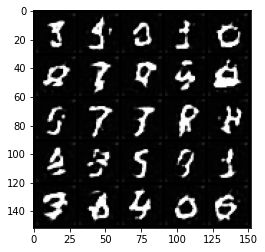

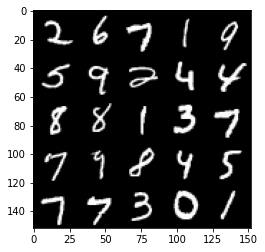

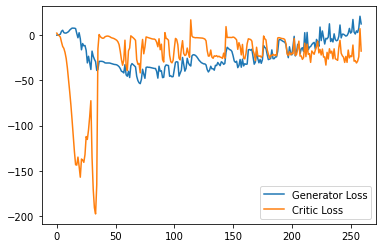

Step 5250: Generator loss: 6.846156132817268, critic loss: -27.53775384044647


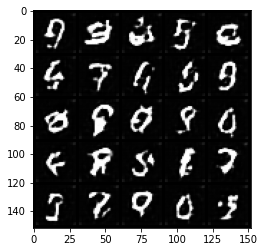

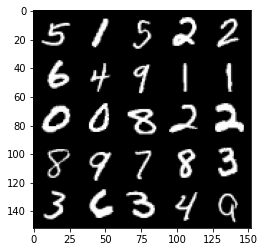

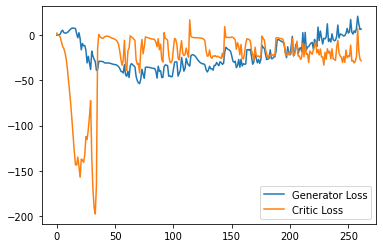

Step 5300: Generator loss: 7.122105065584183, critic loss: -23.36330517864228


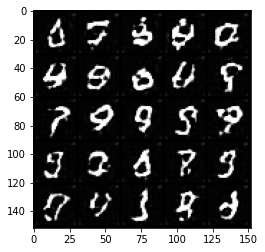

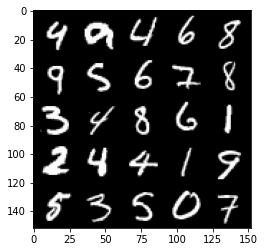

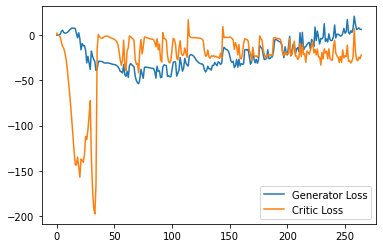

Step 5350: Generator loss: 17.938295035362245, critic loss: -16.29434313774109


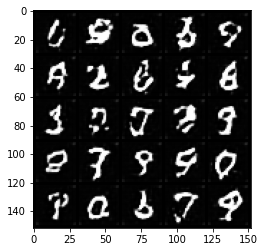

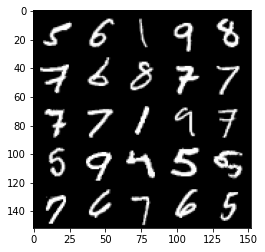

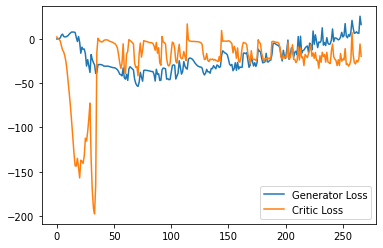

Step 5400: Generator loss: 10.331487330794335, critic loss: -24.653983777046207


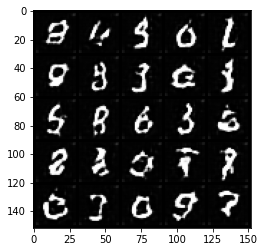

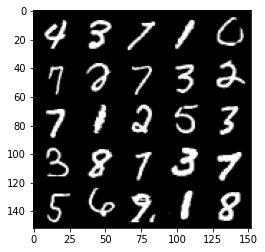

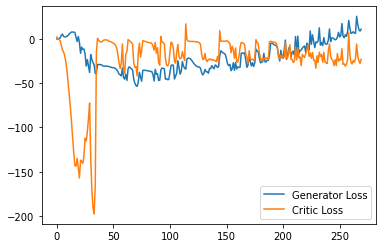

Step 5450: Generator loss: 16.953932824134828, critic loss: -15.664721113204955


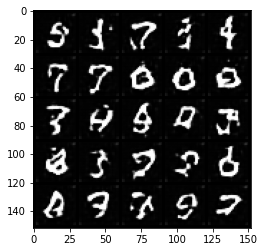

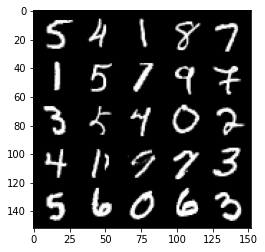

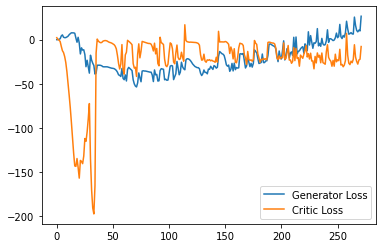

Step 5500: Generator loss: 12.509366221427918, critic loss: -24.357536978960034


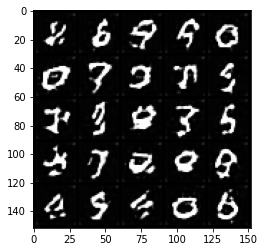

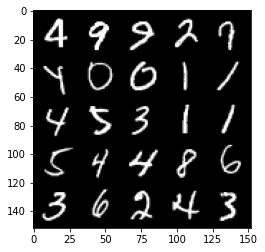

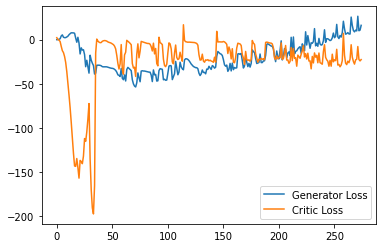

Step 5550: Generator loss: 10.798006799817085, critic loss: -28.45119000530243


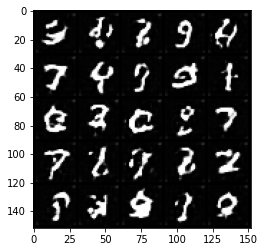

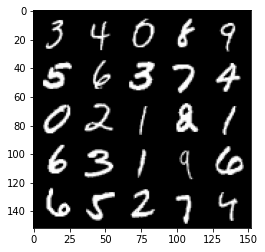

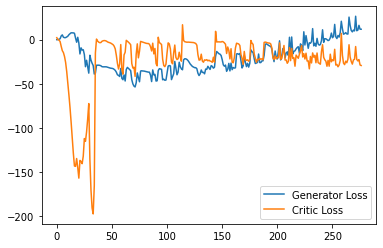

Step 5600: Generator loss: 16.452425136566163, critic loss: -21.55535897254944


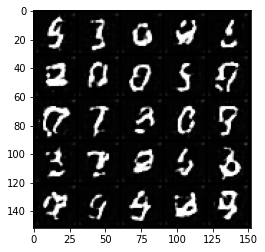

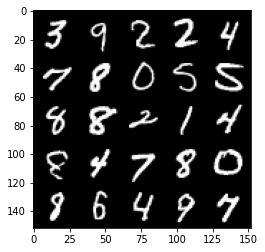

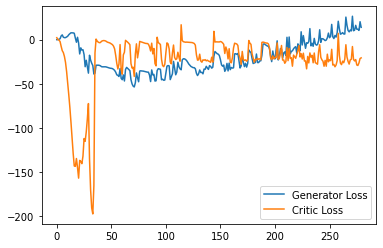

Step 5650: Generator loss: 13.34996963739395, critic loss: -18.0430441365242


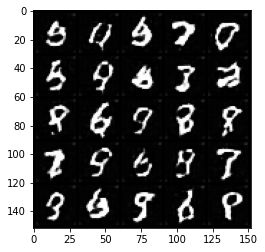

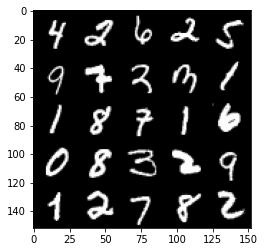

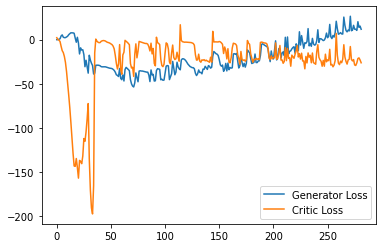

Step 5700: Generator loss: 27.400416450500487, critic loss: -5.021219702720642


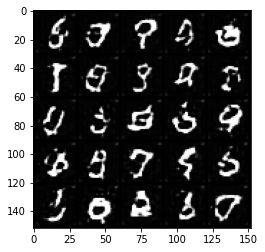

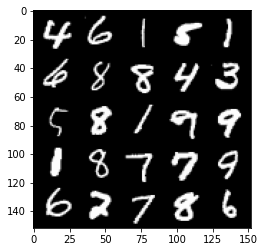

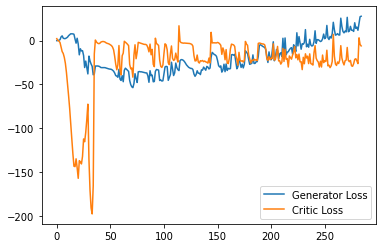

Step 5750: Generator loss: 12.422471383213997, critic loss: -26.112933197975167


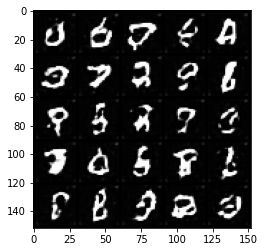

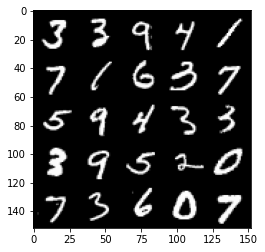

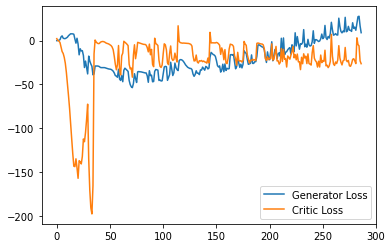

Step 5800: Generator loss: 16.942395827770234, critic loss: -27.489182281374937


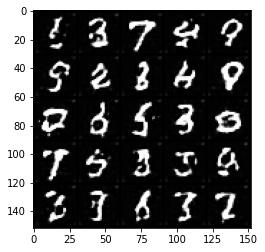

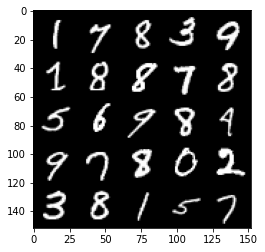

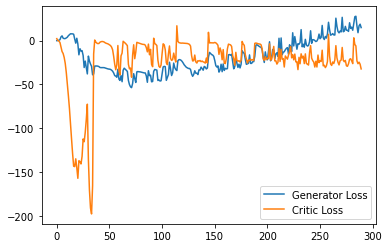

Step 5850: Generator loss: 15.72720159381628, critic loss: -24.229907810449596


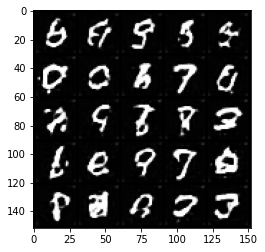

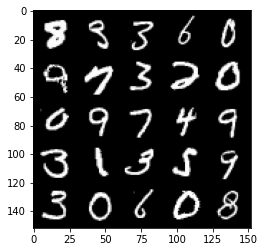

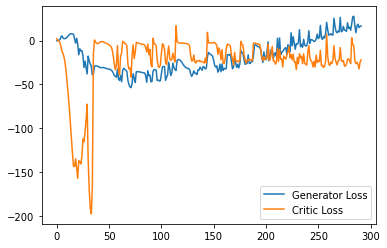

Step 5900: Generator loss: 16.16356349617243, critic loss: -26.14852278804779


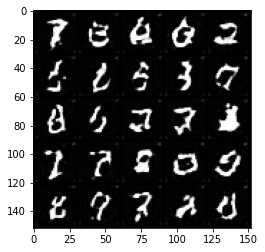

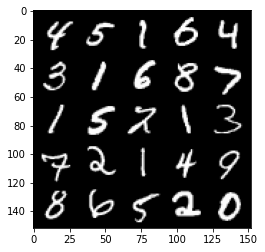

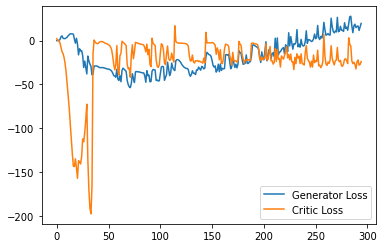

Step 5950: Generator loss: 26.386660537719727, critic loss: -8.154424426078796


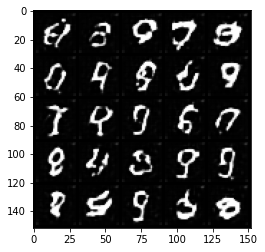

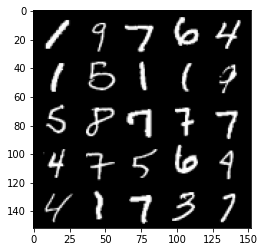

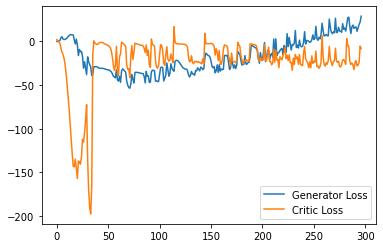

Step 6000: Generator loss: 20.565920457839965, critic loss: -17.855624767303468


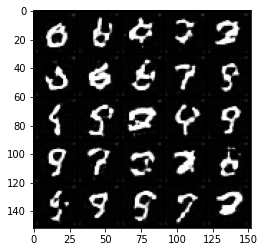

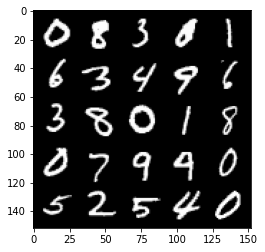

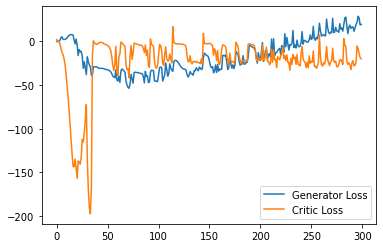

Step 6050: Generator loss: 29.356173033714295, critic loss: -13.284448080062866


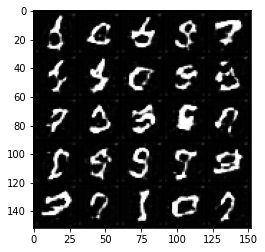

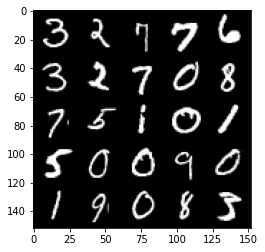

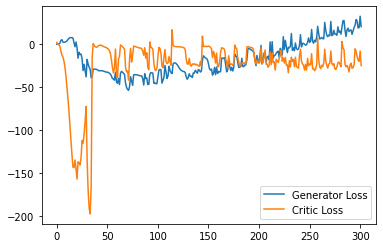

Step 6100: Generator loss: 26.43750461578369, critic loss: -6.943148492813117


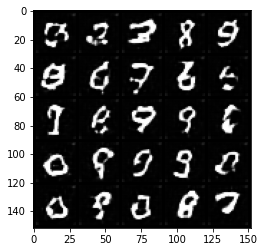

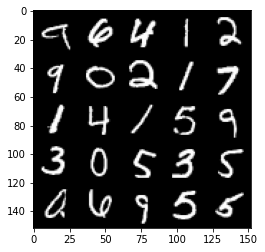

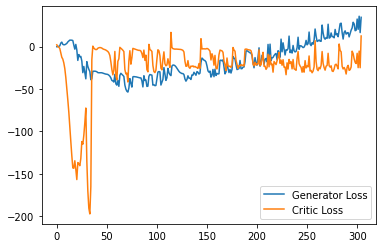

Step 6150: Generator loss: 32.256879596710206, critic loss: -10.05824403476715


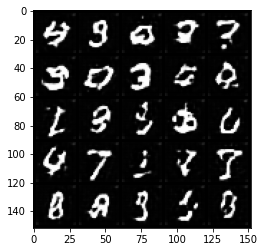

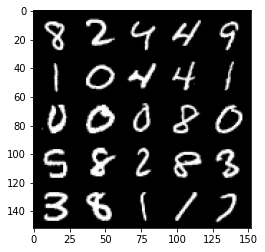

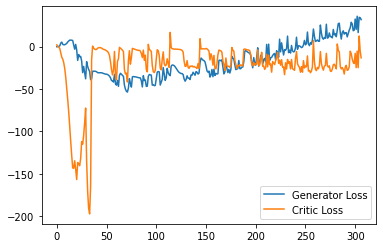

Step 6200: Generator loss: 24.343954257965088, critic loss: -18.675015883445738


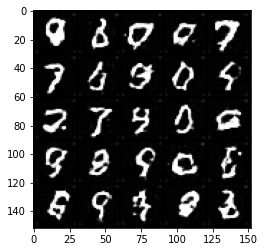

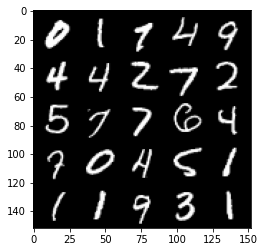

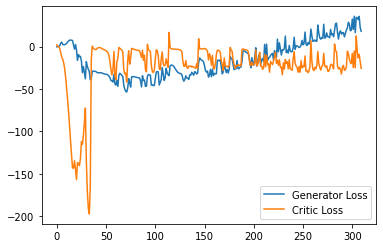

Step 6250: Generator loss: 20.866690220832826, critic loss: -24.328144775152218


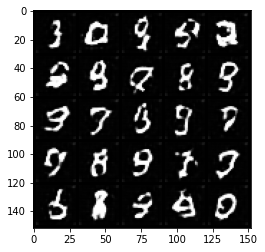

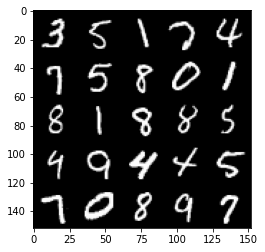

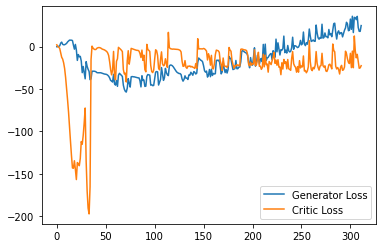

Step 6300: Generator loss: 25.892284479141235, critic loss: -22.886745946407324


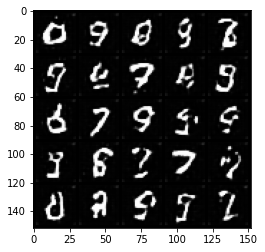

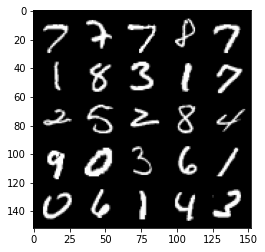

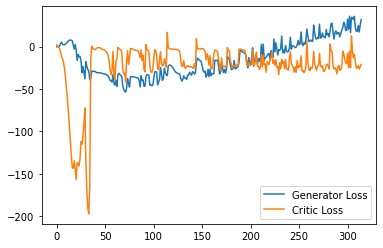

Step 6350: Generator loss: 16.93013373374939, critic loss: -25.309455158233636


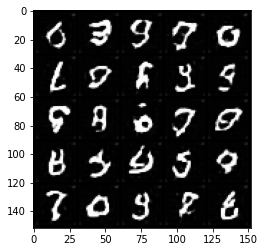

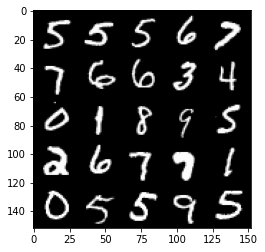

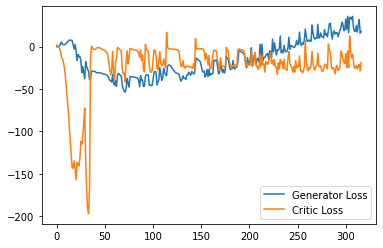

Step 6400: Generator loss: 27.522426528930666, critic loss: -20.58451144504547


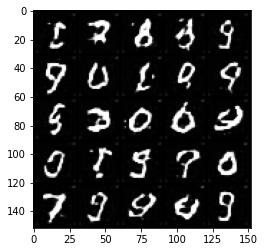

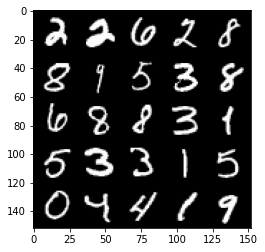

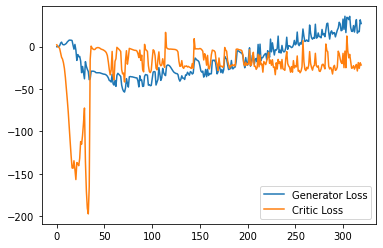

Step 6450: Generator loss: 26.83740436553955, critic loss: -23.56043950939178


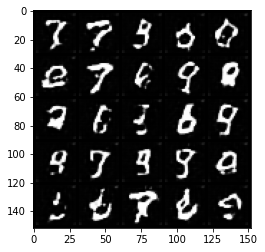

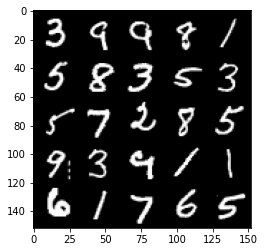

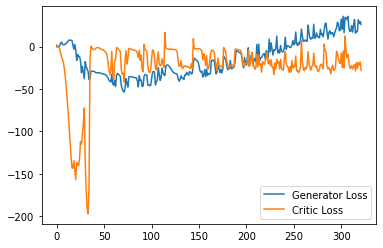

Step 6500: Generator loss: 23.688663351535798, critic loss: -21.829648220062257


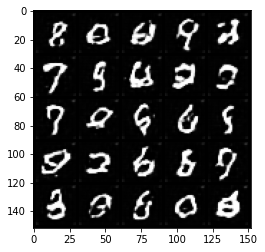

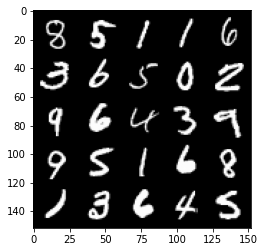

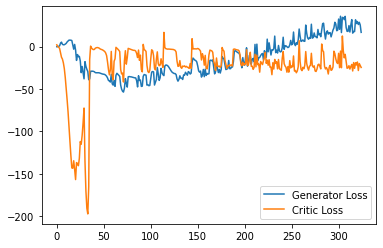

Step 6550: Generator loss: 20.691928915977478, critic loss: -27.17688876867295


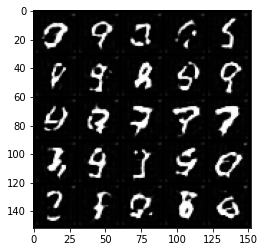

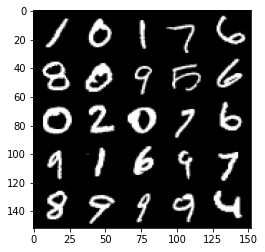

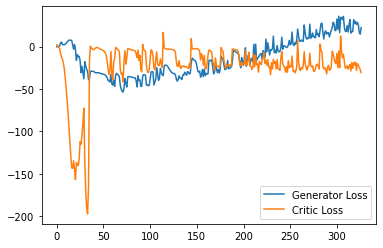

Step 6600: Generator loss: 25.39954528808594, critic loss: -23.44386076021194


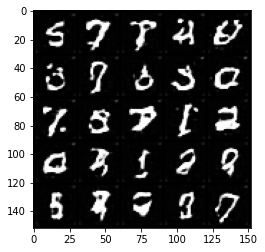

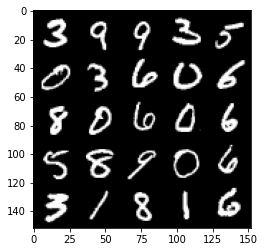

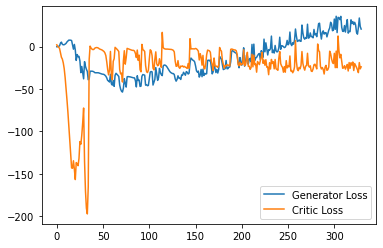

Step 6650: Generator loss: 29.060222854614256, critic loss: -20.68226623392105


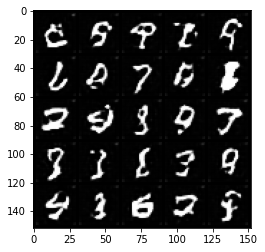

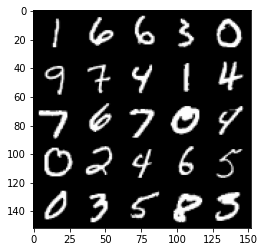

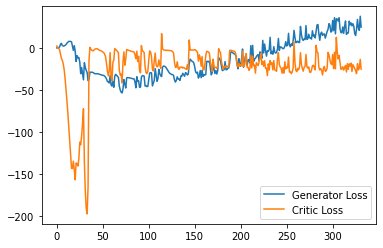

Step 6700: Generator loss: 35.663150005340576, critic loss: -0.8570412855148318


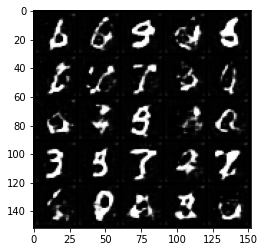

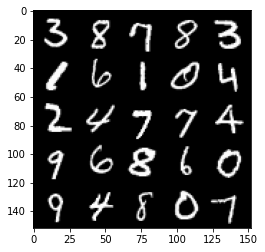

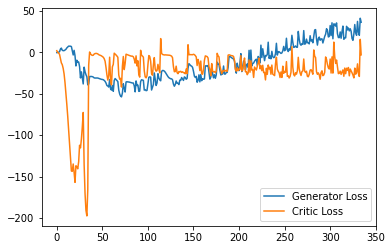

Step 6750: Generator loss: 35.02325080871582, critic loss: -7.790925464630128


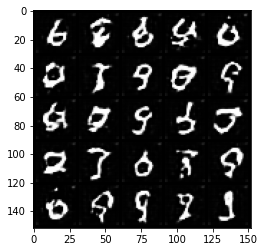

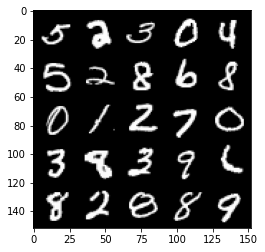

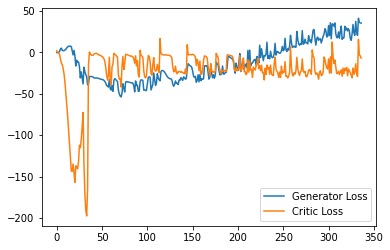

Step 6800: Generator loss: 27.590986137390136, critic loss: -22.316857331752775


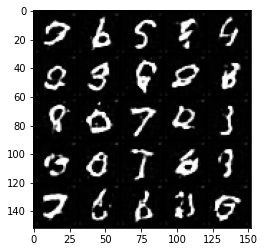

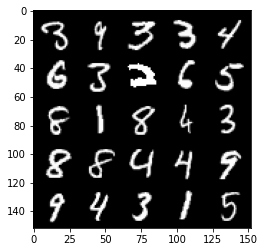

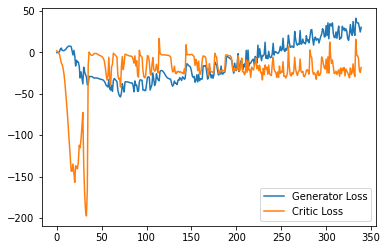

Step 6850: Generator loss: 29.46463191986084, critic loss: -27.228430958747857


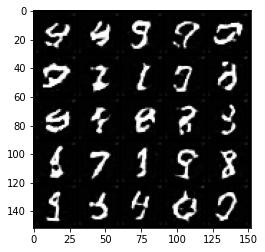

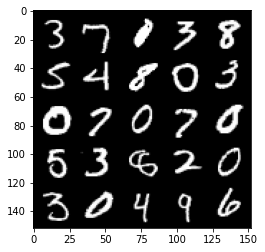

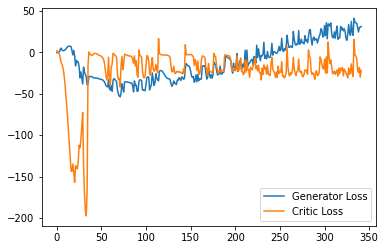

Step 6900: Generator loss: 28.00386763572693, critic loss: -23.443930556774138


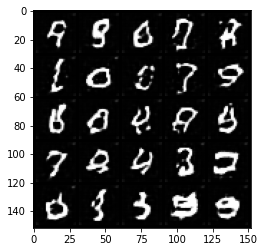

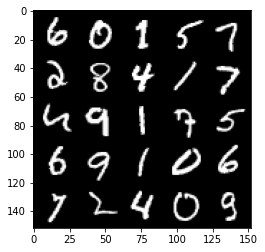

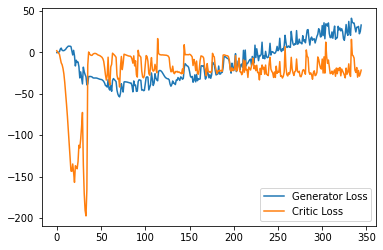

Step 6950: Generator loss: 38.01517805099488, critic loss: -17.358612908363344


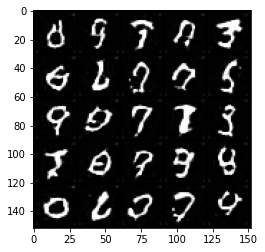

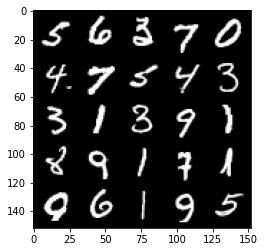

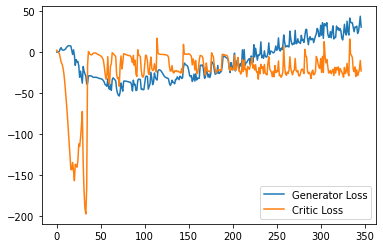

Step 7000: Generator loss: 29.307809705734254, critic loss: -16.737294704914092


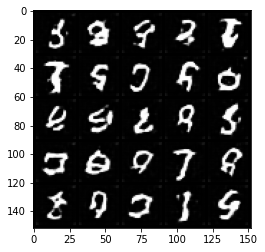

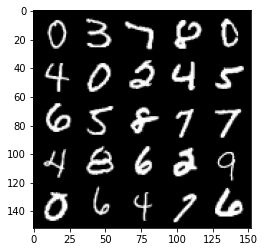

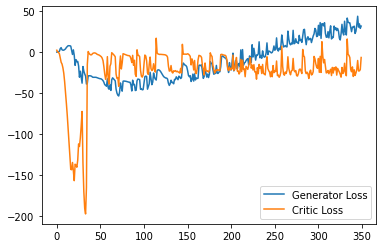

Step 7050: Generator loss: 26.87030973434448, critic loss: -27.818046659231175


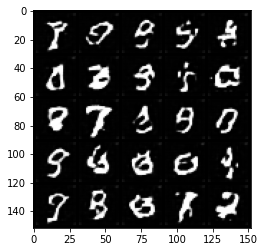

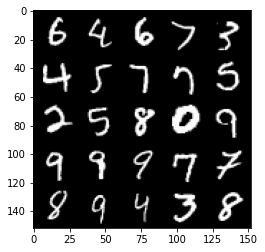

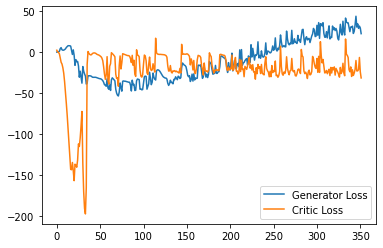

Step 7100: Generator loss: 30.323116092681886, critic loss: -24.243246567487716


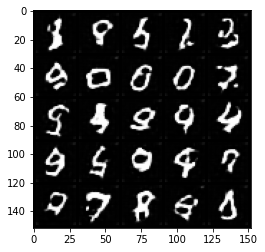

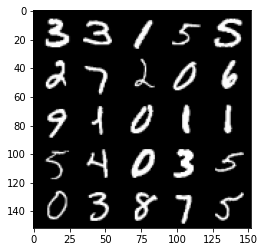

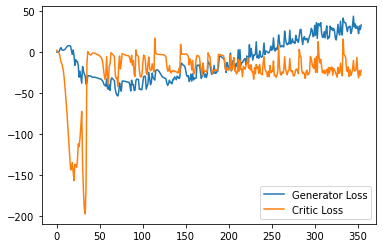

Step 7150: Generator loss: 40.43761129379273, critic loss: -11.636572332620624


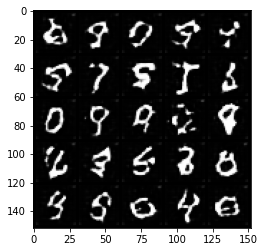

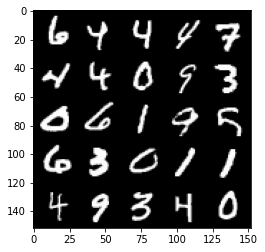

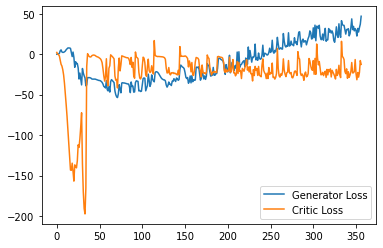

Step 7200: Generator loss: 41.140031795501706, critic loss: -18.52728805756568


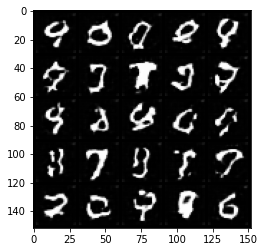

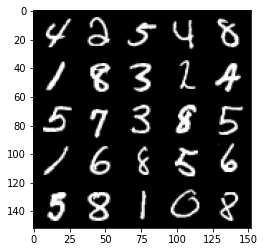

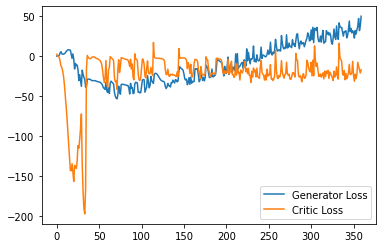

Step 7250: Generator loss: 34.742562999725344, critic loss: -21.888534611701967


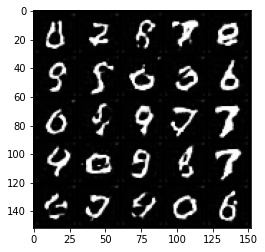

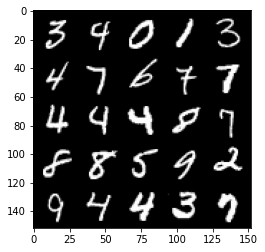

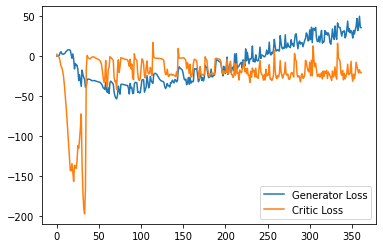

Step 7300: Generator loss: 36.12975004196167, critic loss: -21.874540449619293


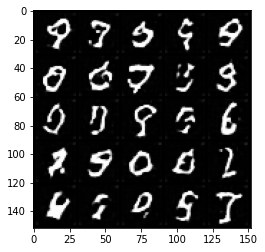

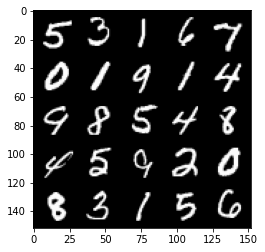

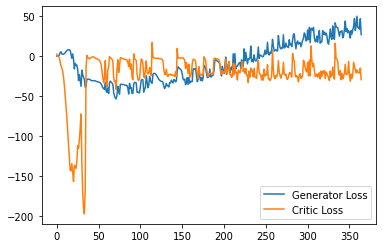

Step 7350: Generator loss: 40.98460706710816, critic loss: -20.907170664310456


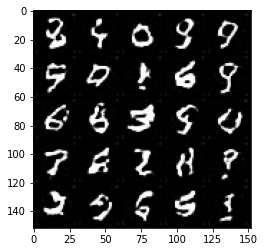

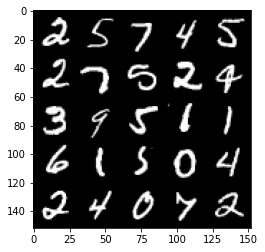

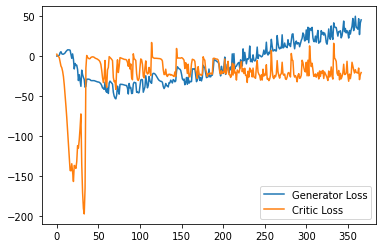

Step 7400: Generator loss: 46.2540532875061, critic loss: -13.244785175323484


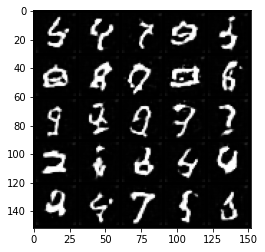

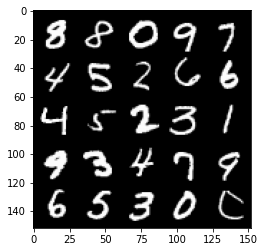

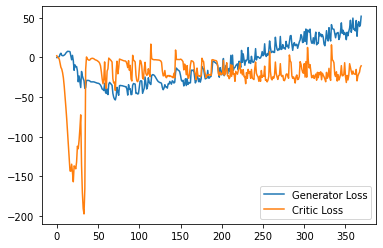

Step 7450: Generator loss: 42.46292896270752, critic loss: -13.408808061361315


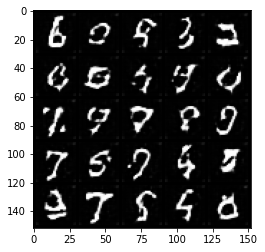

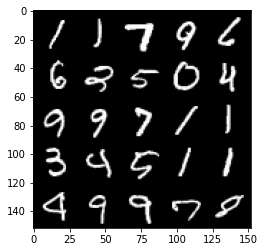

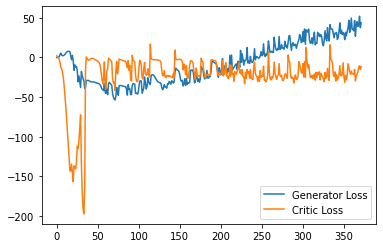

Step 7500: Generator loss: 48.57637538909912, critic loss: -21.468855337142944


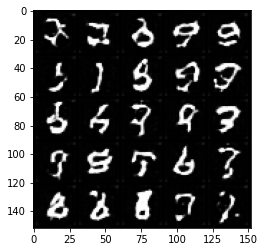

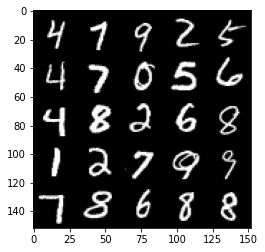

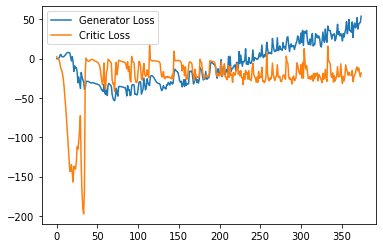

Step 7550: Generator loss: 43.931447219848636, critic loss: -14.618828342795368


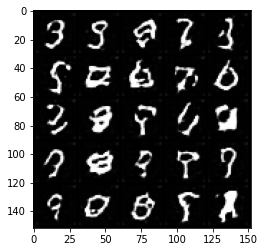

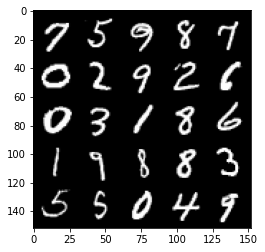

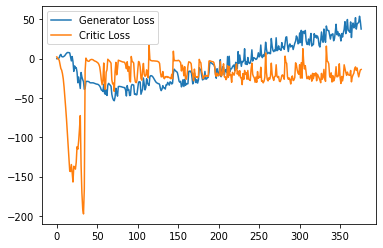

Step 7600: Generator loss: 36.643667697906494, critic loss: -25.55474648857116


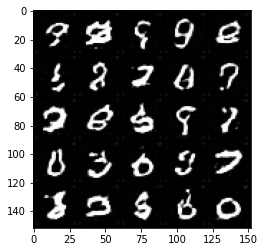

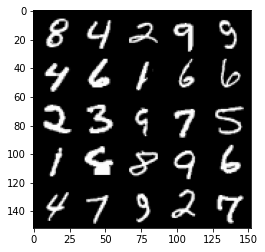

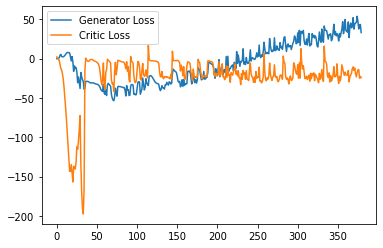

Step 7650: Generator loss: 39.70579359054565, critic loss: -23.338351817369457


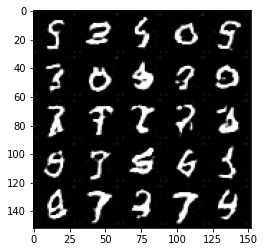

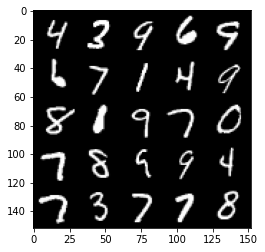

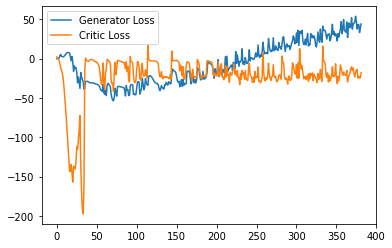

Step 7700: Generator loss: 41.49047855377197, critic loss: -21.448379022121426


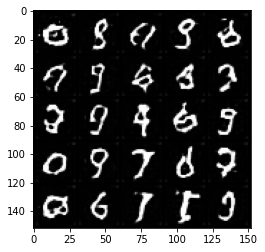

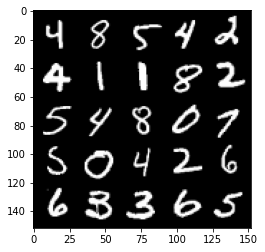

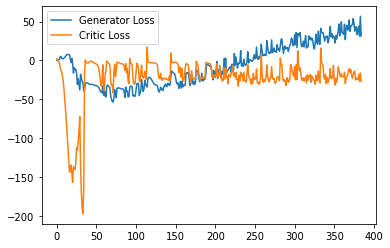

Step 7750: Generator loss: 49.57094875335693, critic loss: -13.864746979713436


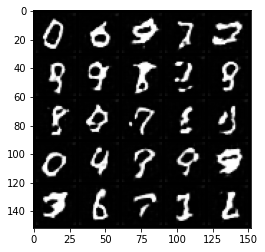

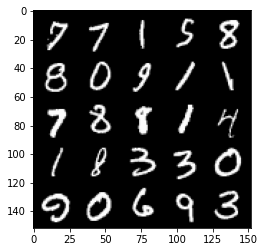

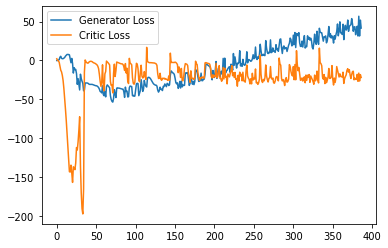

Step 7800: Generator loss: 46.52594303131104, critic loss: -19.998011893272405


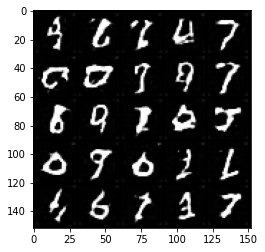

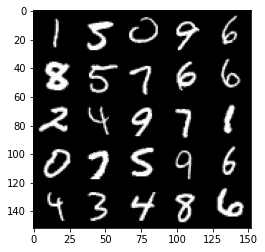

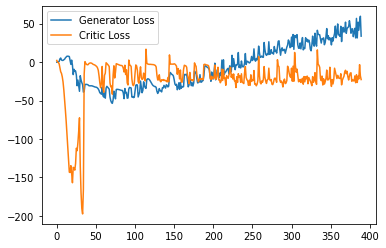

Step 7850: Generator loss: 46.62299285888672, critic loss: -21.961976778507232


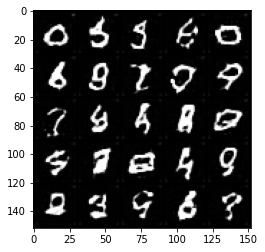

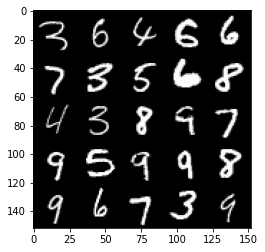

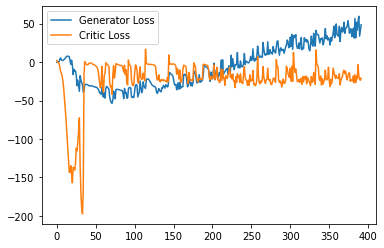

Step 7900: Generator loss: 47.18675395965576, critic loss: -16.28499113941193


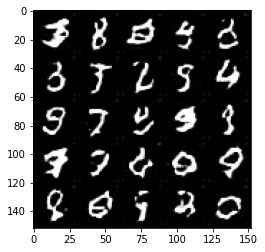

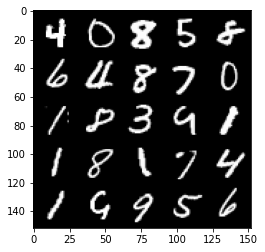

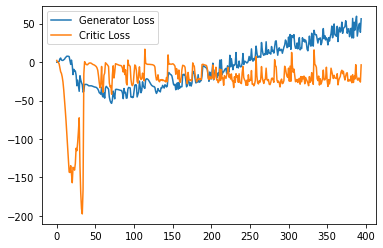

Step 7950: Generator loss: 41.718806953430175, critic loss: -25.01036513328553


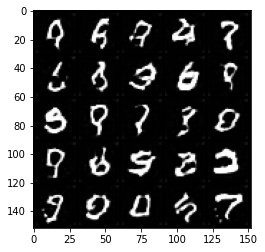

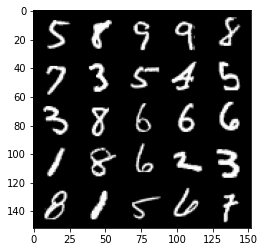

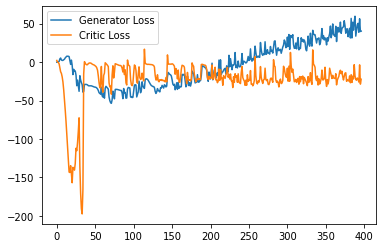

Step 8000: Generator loss: 50.54279857635498, critic loss: -18.63181131148339


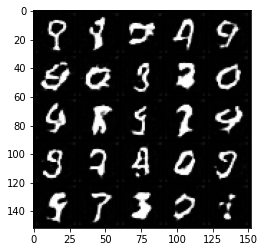

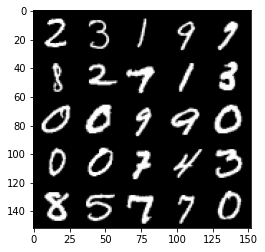

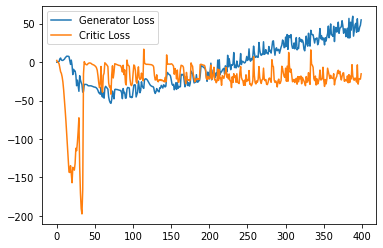

Step 8050: Generator loss: 49.83800022125244, critic loss: -19.382256979942323


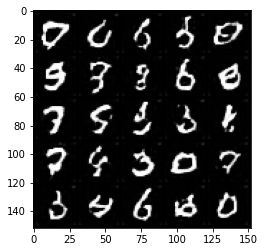

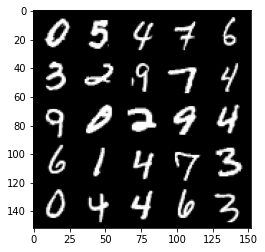

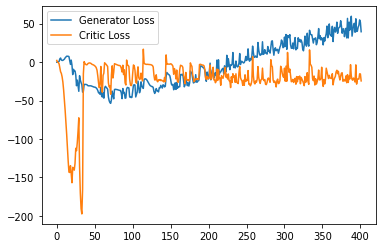

Step 8100: Generator loss: 45.75811168670654, critic loss: -21.164627089500424


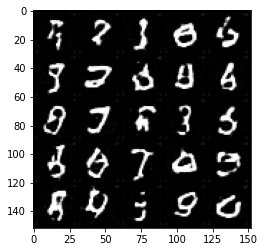

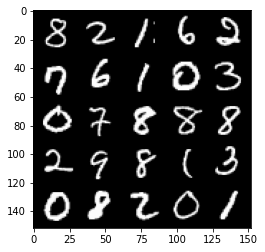

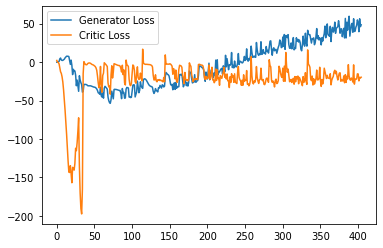

Step 8150: Generator loss: 45.441687774658206, critic loss: -25.35237574863434


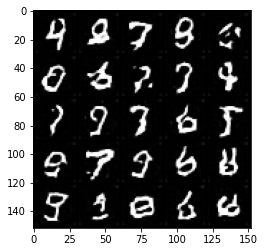

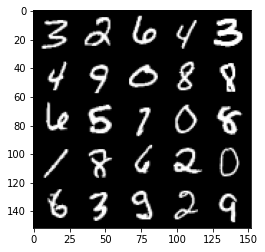

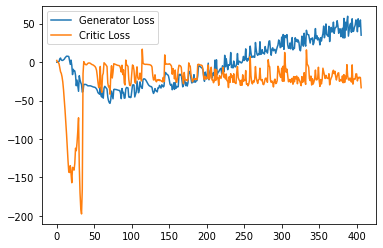

Step 8200: Generator loss: 41.000807514190676, critic loss: -15.250010792732235


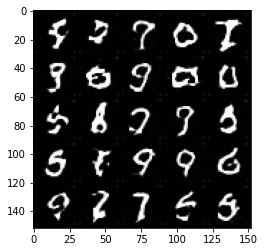

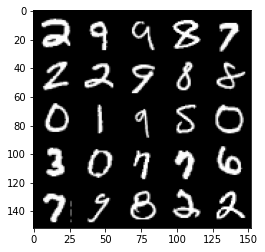

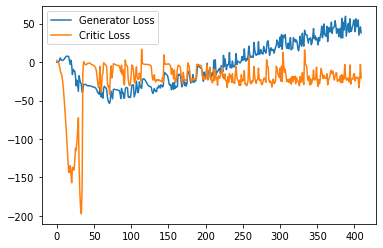

Step 8250: Generator loss: 57.44315425872803, critic loss: -20.253608092069626


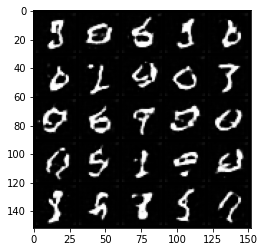

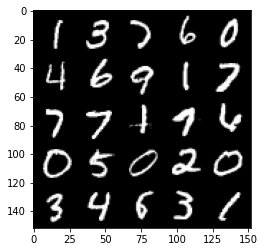

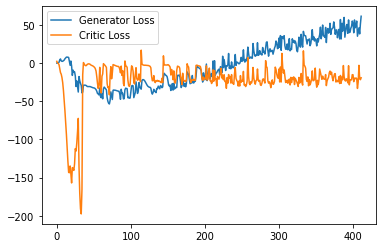

Step 8300: Generator loss: 36.89345752716064, critic loss: -32.19426084613801


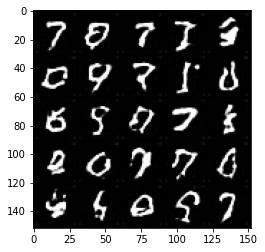

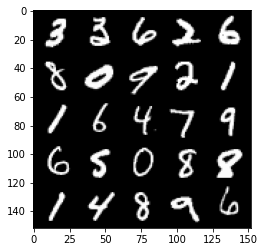

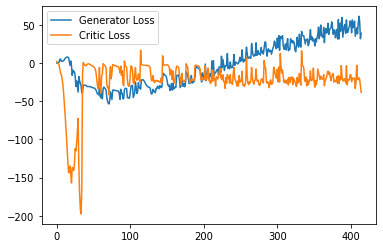

Step 8350: Generator loss: 46.67510879516602, critic loss: -23.275370863914496


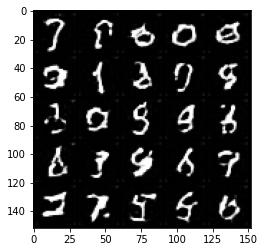

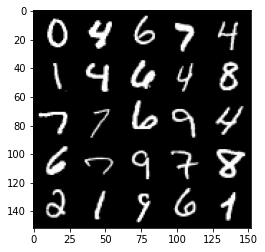

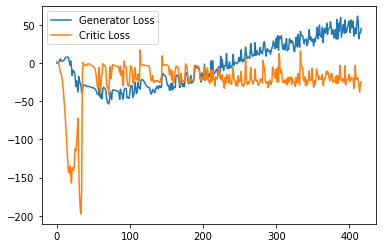

Step 8400: Generator loss: 43.483372364044186, critic loss: -27.63408237600327


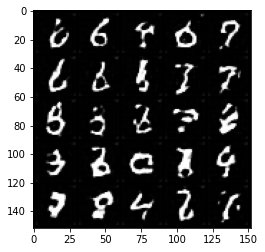

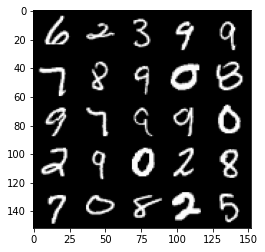

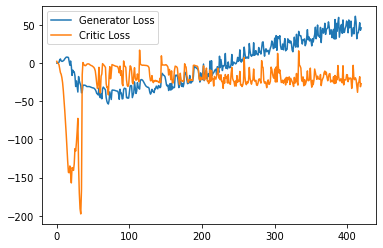

Step 8450: Generator loss: 46.1781050491333, critic loss: -28.283459685802463


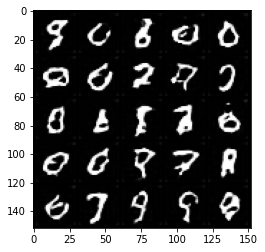

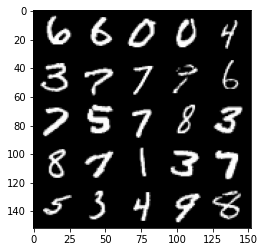

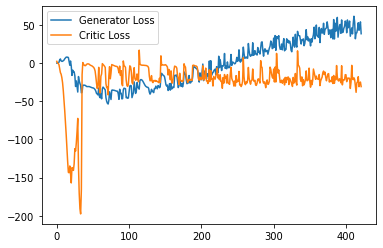

Step 8500: Generator loss: 61.452045860290525, critic loss: -20.78163228428363


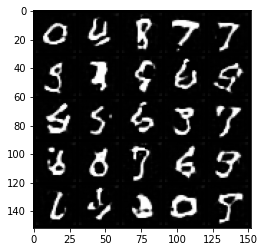

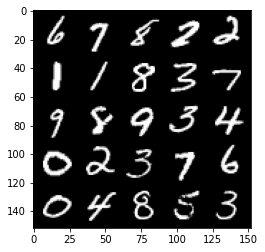

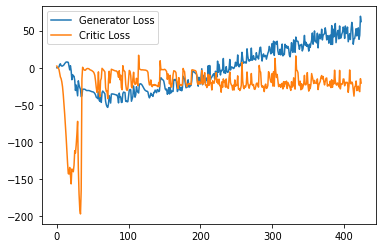

Step 8550: Generator loss: 46.11749866485596, critic loss: -24.9650026447773


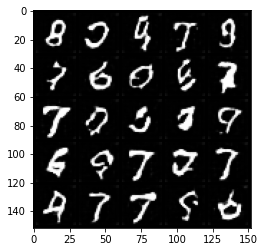

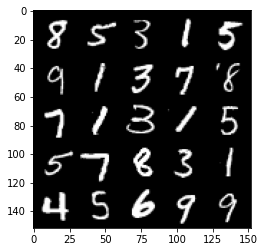

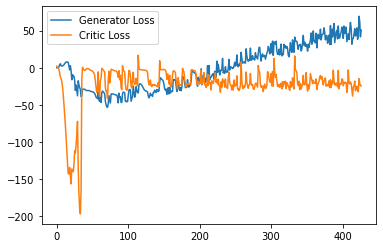

Step 8600: Generator loss: 50.22087265610695, critic loss: -16.075352739810945


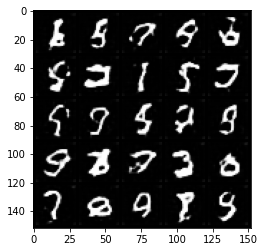

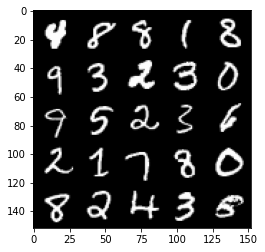

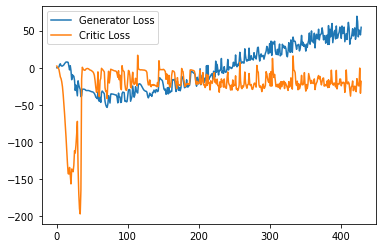

Step 8650: Generator loss: 56.283724327087405, critic loss: -23.581322846412665


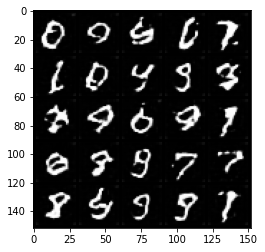

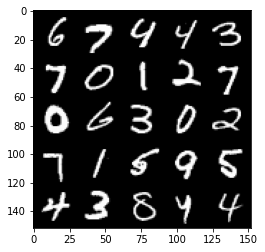

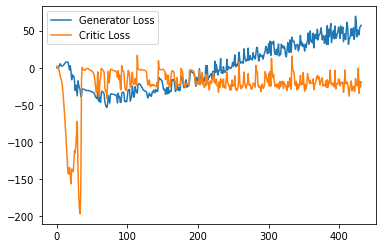

Step 8700: Generator loss: 47.47600246429443, critic loss: -27.690657083511336


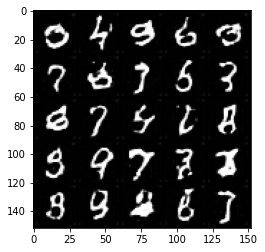

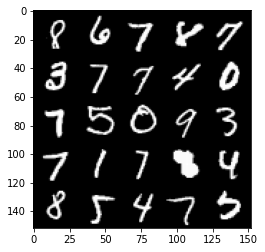

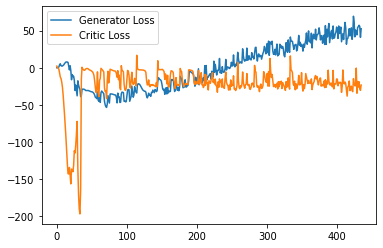

Step 8750: Generator loss: 55.281023292541505, critic loss: -21.059560542106627


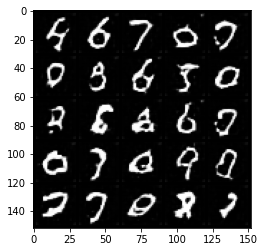

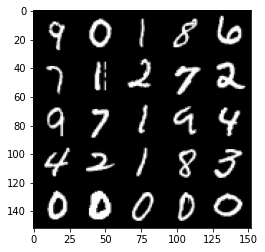

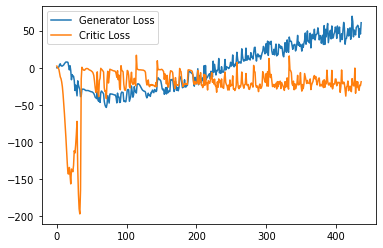

Step 8800: Generator loss: 40.74900152206421, critic loss: -31.226928829193113


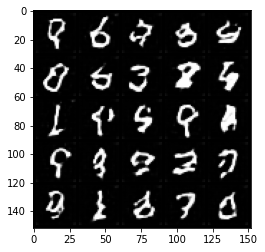

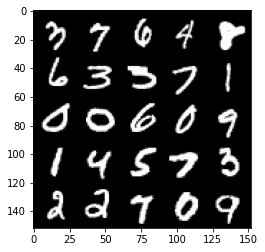

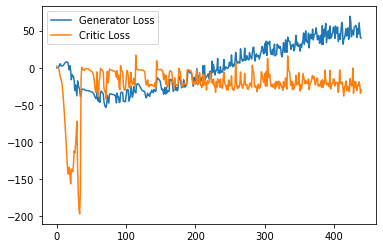

Step 8850: Generator loss: 57.626952209472655, critic loss: -11.305842482805254


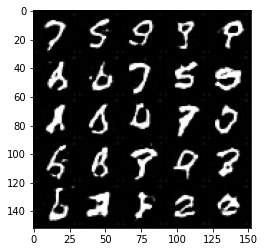

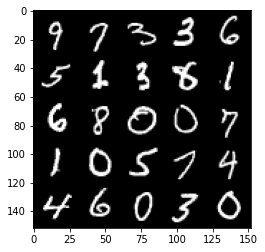

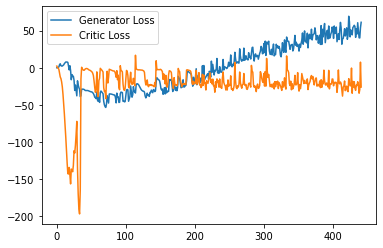

Step 8900: Generator loss: 53.65588119506836, critic loss: -24.962717132091527


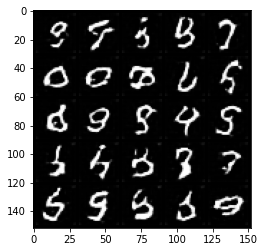

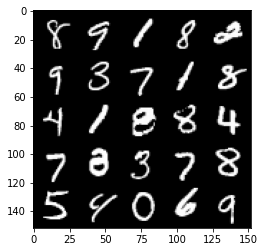

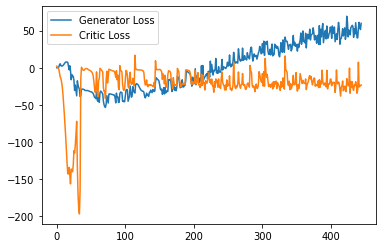

Step 8950: Generator loss: 61.678611221313474, critic loss: -19.504328407764437


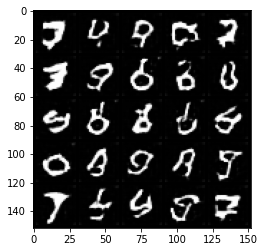

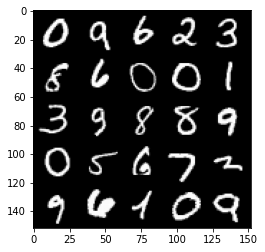

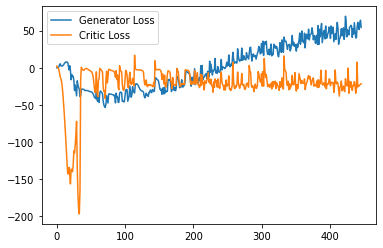

Step 9000: Generator loss: 53.73905101776123, critic loss: -25.973096418380734


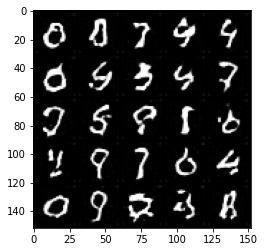

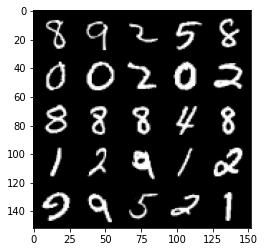

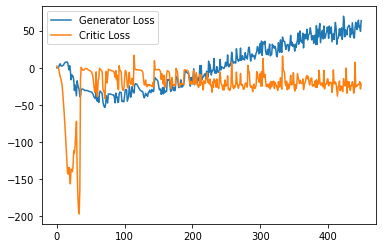

Step 9050: Generator loss: 57.003840103149415, critic loss: -23.316685411930095


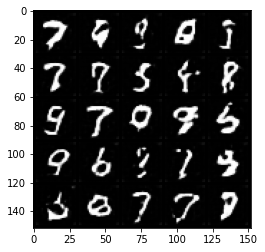

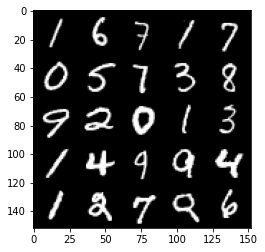

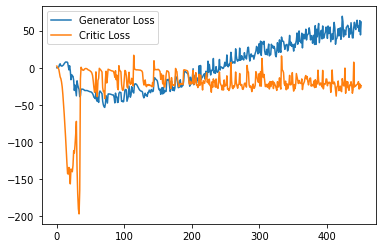

Step 9100: Generator loss: 54.19782485961914, critic loss: -19.572327907562258


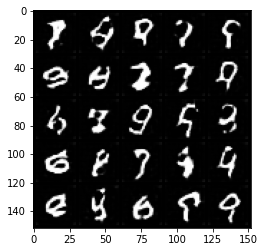

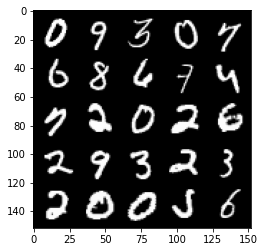

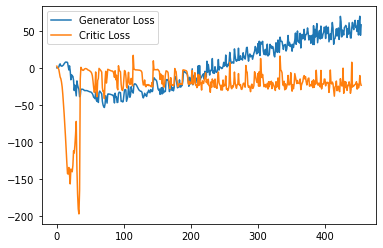

Step 9150: Generator loss: 58.924898300170895, critic loss: -17.856003950595863


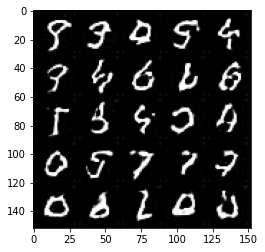

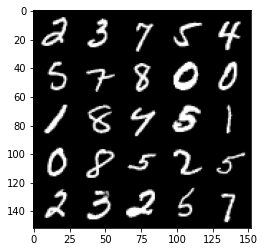

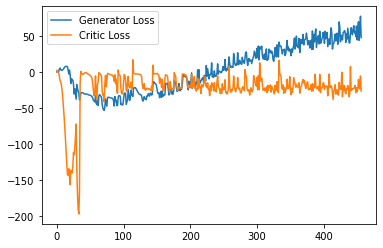

Step 9200: Generator loss: 64.77447219848632, critic loss: -9.279019214153289


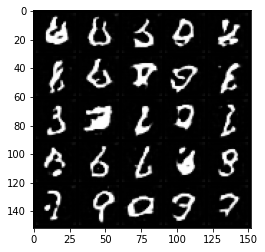

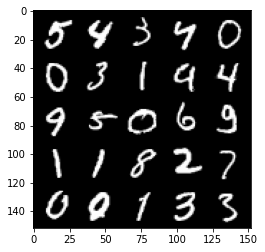

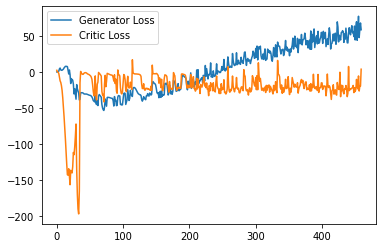

Step 9250: Generator loss: 55.09381025314331, critic loss: -23.028348321437832


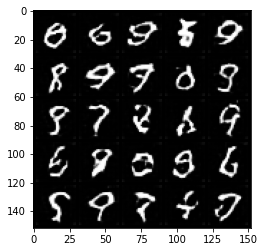

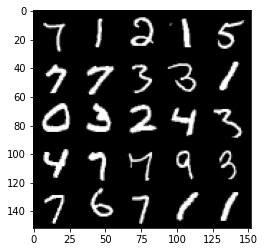

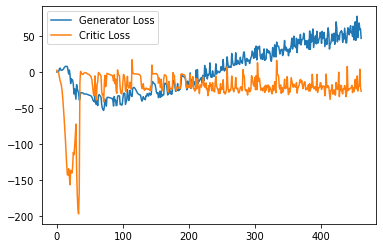

Step 9300: Generator loss: 65.20769207000733, critic loss: -21.453233882427217


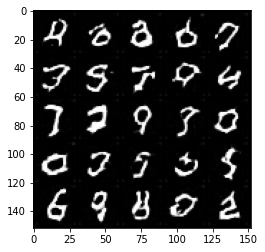

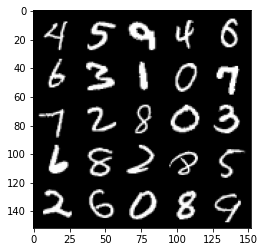

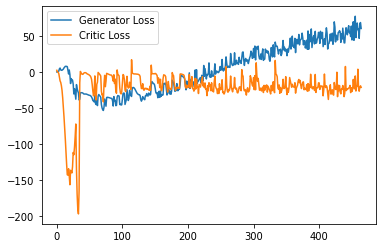

Step 9350: Generator loss: 52.096950721740725, critic loss: -25.464421042442318


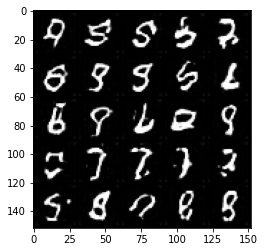

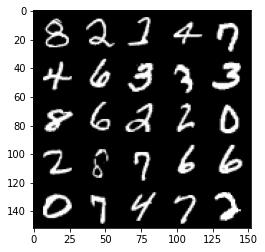

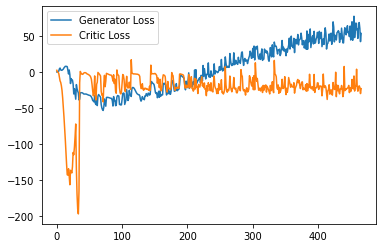

Step 9400: Generator loss: 57.34003623962403, critic loss: -17.30052654647827


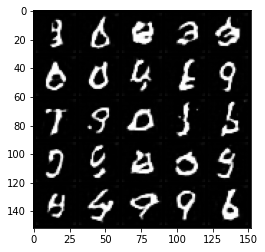

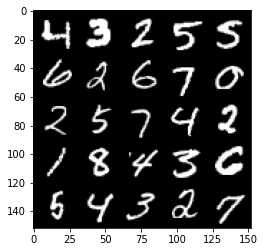

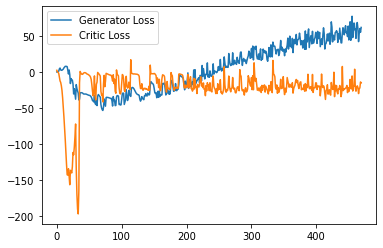

Step 9450: Generator loss: 64.4741928100586, critic loss: -14.875978892803193


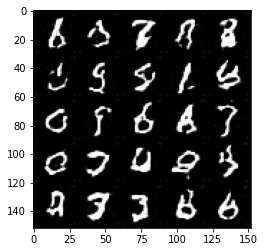

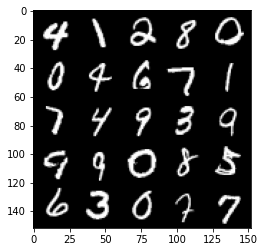

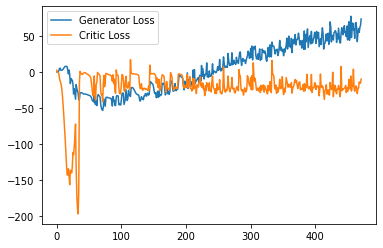

Step 9500: Generator loss: 66.62016815185547, critic loss: -8.70055299282074


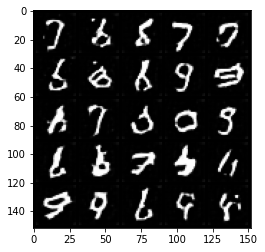

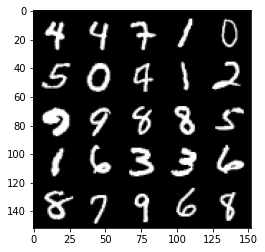

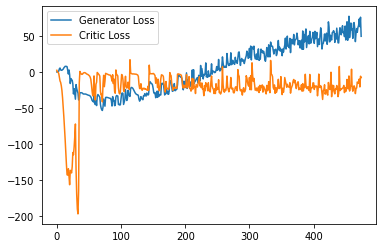

Step 9550: Generator loss: 68.33656852722169, critic loss: -19.553491313695908


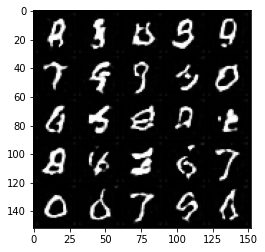

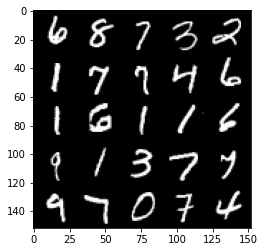

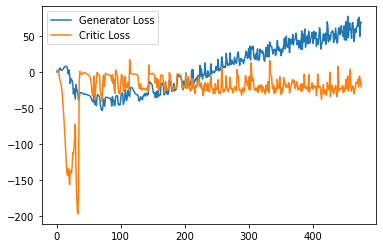

Step 9600: Generator loss: 61.59085014343262, critic loss: -4.0096791901588436


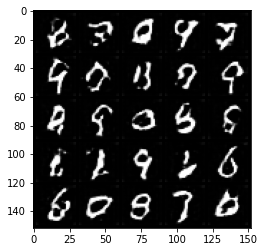

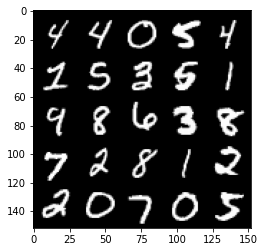

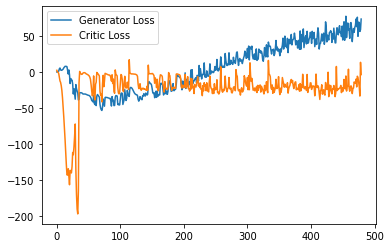

Step 9650: Generator loss: 70.26518878936767, critic loss: -14.73087402009964


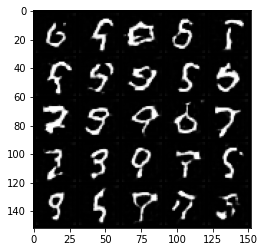

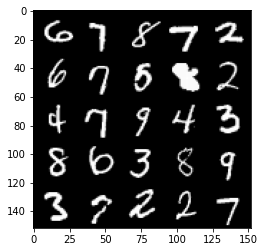

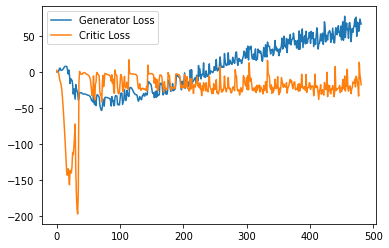

Step 9700: Generator loss: 48.243564414978025, critic loss: -26.120762539625176


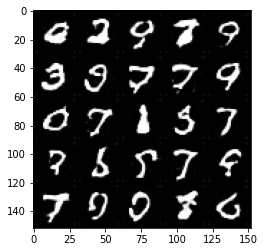

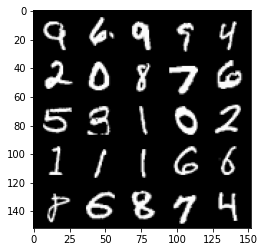

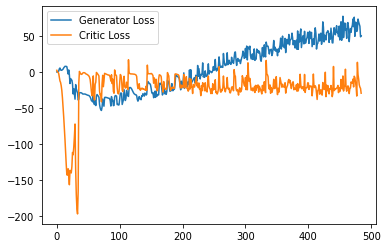

Step 9750: Generator loss: 58.50560344696045, critic loss: -28.213741238832476


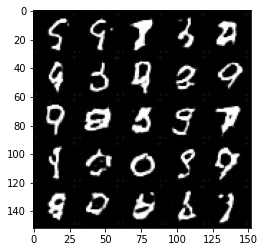

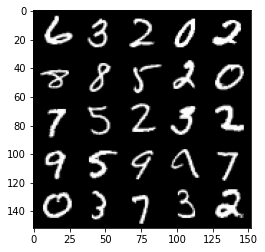

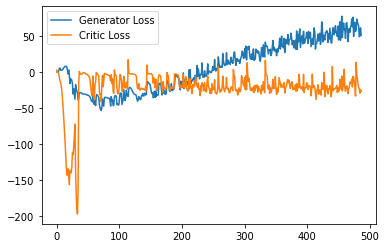

Step 9800: Generator loss: 67.02887775421142, critic loss: -16.72980175328255


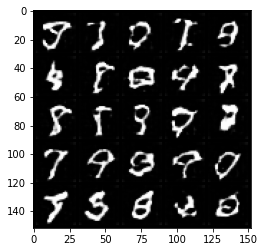

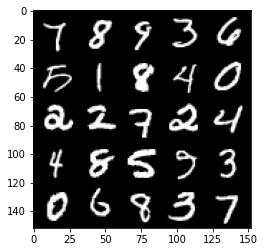

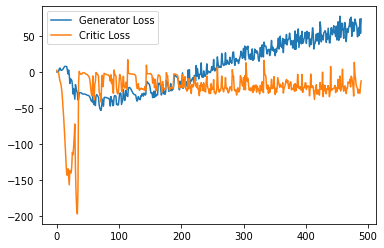

Step 9850: Generator loss: 67.52748622894288, critic loss: -14.604883381366733


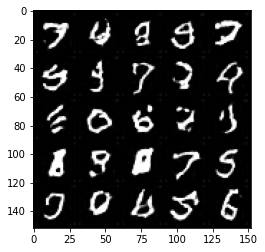

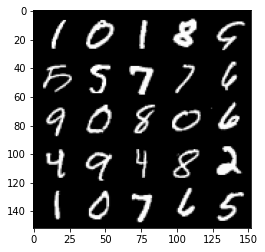

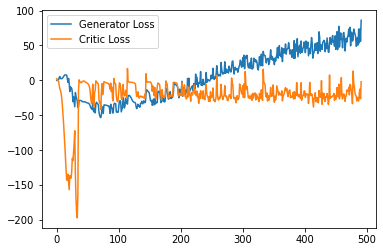

Step 9900: Generator loss: 61.863190746307374, critic loss: -23.4905744895935


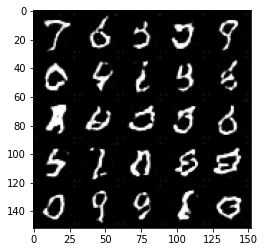

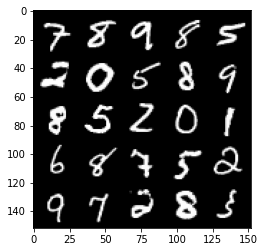

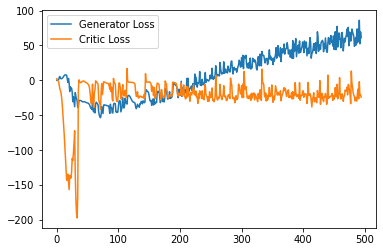

Step 9950: Generator loss: 61.965052909851075, critic loss: -20.286311035633084


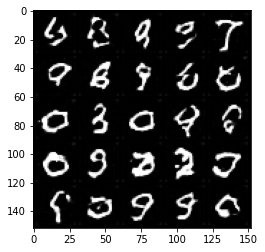

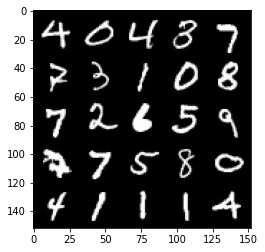

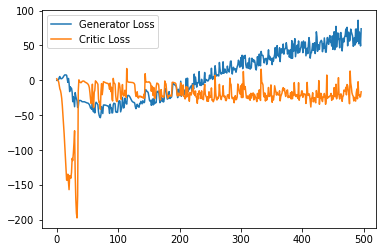

Step 10000: Generator loss: 55.184258193969725, critic loss: -16.512689725160595


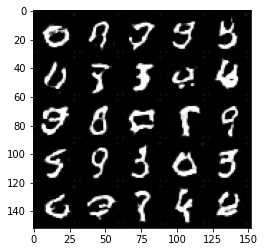

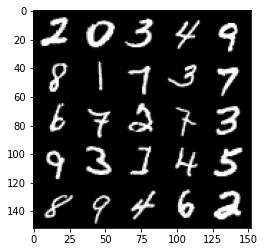

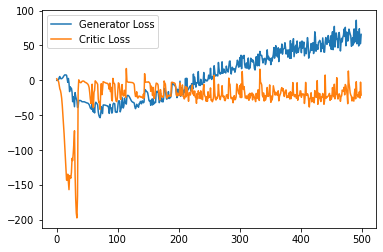

Step 10050: Generator loss: 69.59443229675293, critic loss: -17.96426314520836


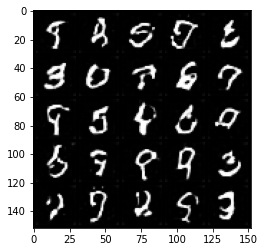

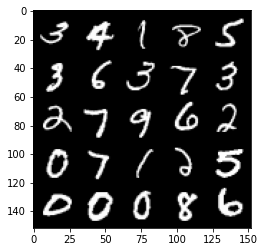

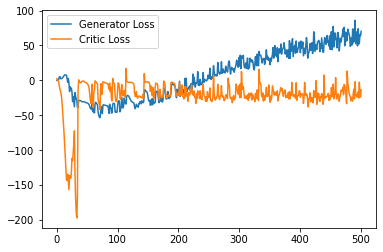

Step 10100: Generator loss: 70.15589302062989, critic loss: -20.425195704936982


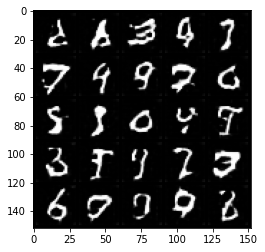

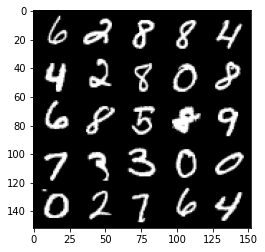

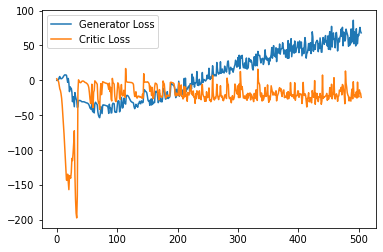

Step 10150: Generator loss: 66.4754434967041, critic loss: -18.83525743460655


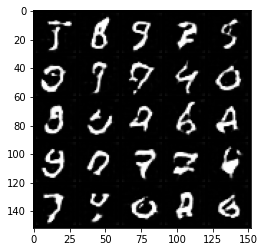

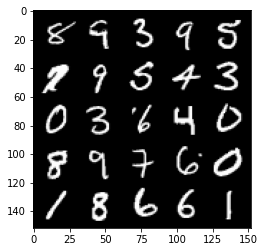

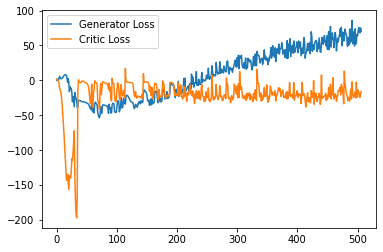

Step 10200: Generator loss: 59.36314891815186, critic loss: -18.465467895030976


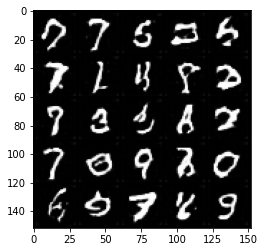

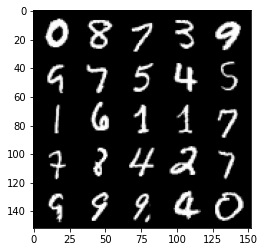

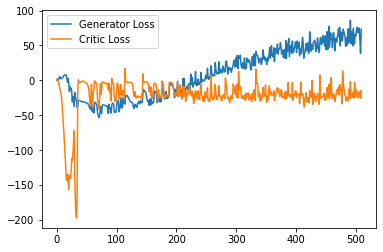

Step 10250: Generator loss: 67.47139347076416, critic loss: -16.49953251552582


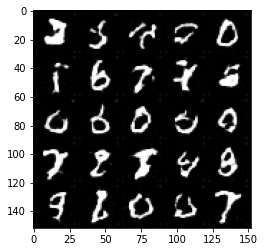

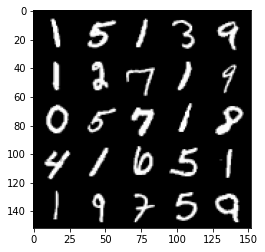

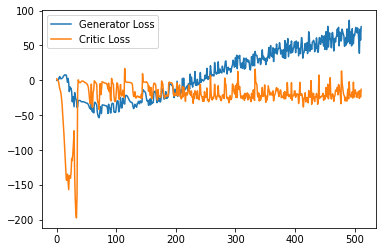

Step 10300: Generator loss: 57.70838001251221, critic loss: -21.228894731044775


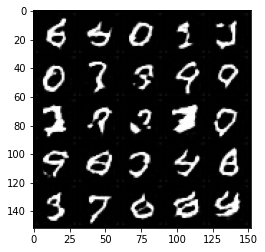

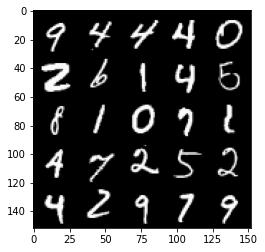

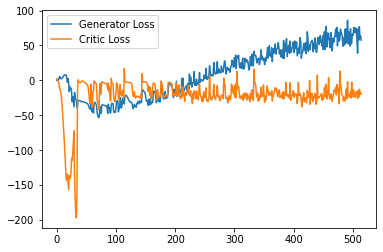

Step 10350: Generator loss: 59.79477962493897, critic loss: -25.253329973220826


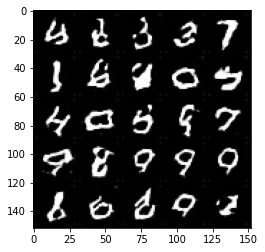

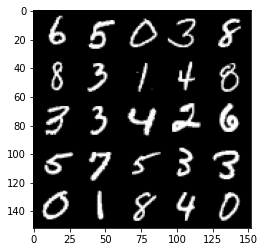

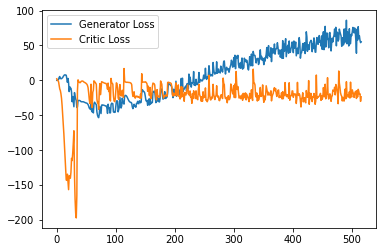

Step 10400: Generator loss: 70.3369681930542, critic loss: -20.853473366737372


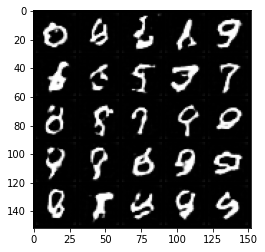

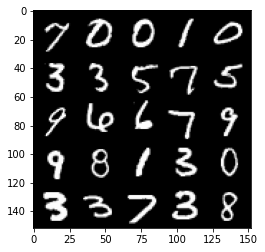

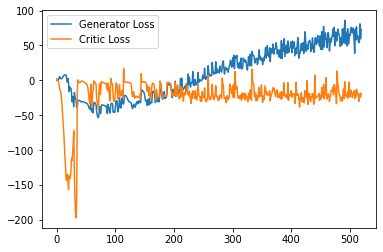

Step 10450: Generator loss: 65.1557286453247, critic loss: -20.988067108631135


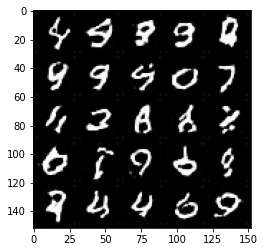

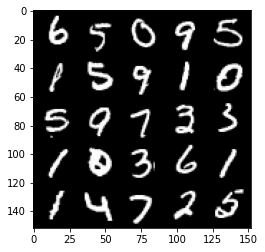

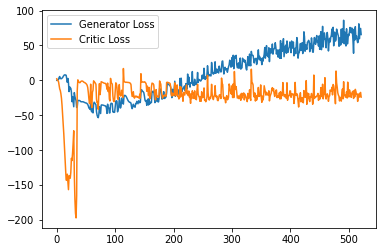

Step 10500: Generator loss: 67.12191379547119, critic loss: -20.841295463085174


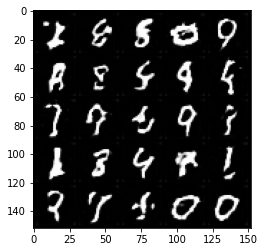

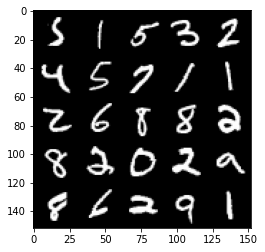

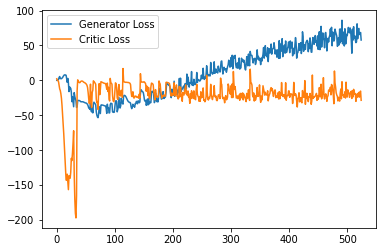

Step 10550: Generator loss: 62.00443603515625, critic loss: -25.503585024118426


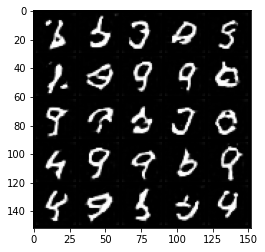

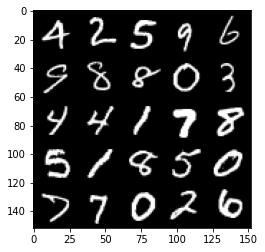

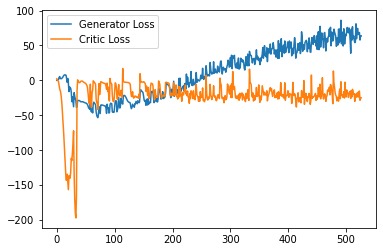

Step 10600: Generator loss: 72.73748413085937, critic loss: -24.179955040931706


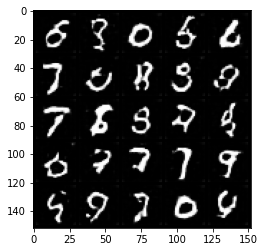

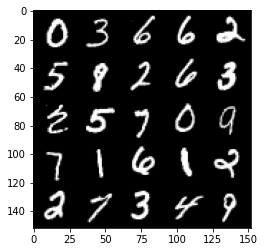

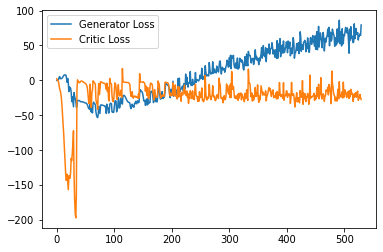

Step 10650: Generator loss: 59.063132247924806, critic loss: -28.164828351497654


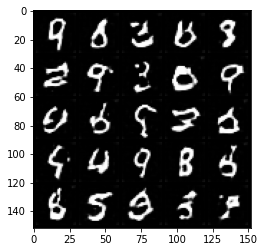

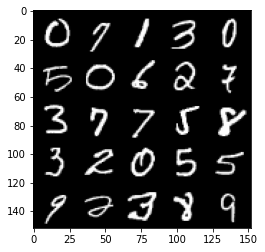

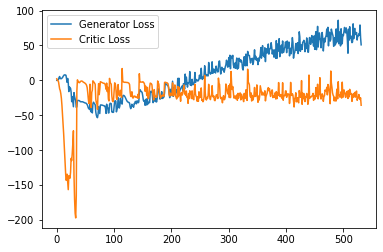

Step 10700: Generator loss: 67.59264488220215, critic loss: -19.63215887761116


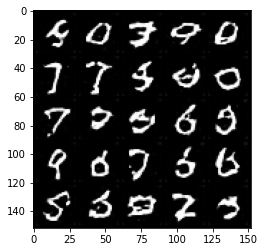

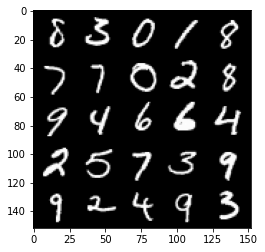

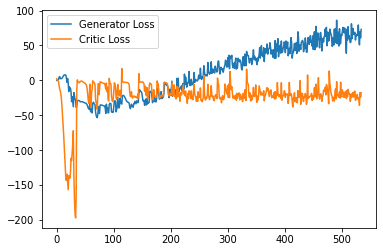

Step 10750: Generator loss: 71.43728538513183, critic loss: -24.856873112678528


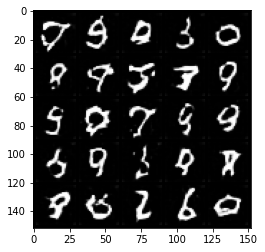

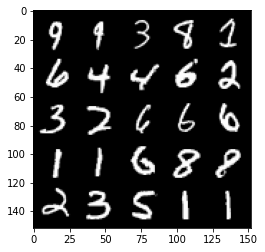

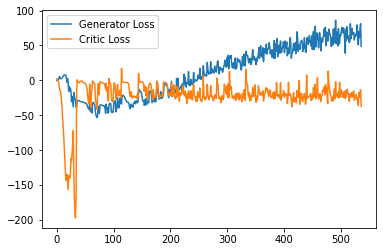

Step 10800: Generator loss: 62.05759887695312, critic loss: -24.37389070749283


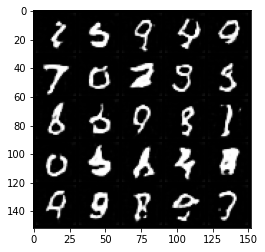

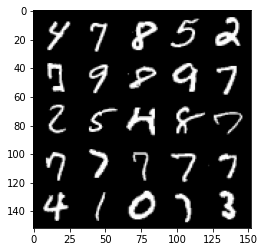

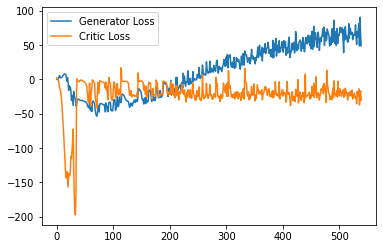

Step 10850: Generator loss: 75.42347667694092, critic loss: -24.500206981658938


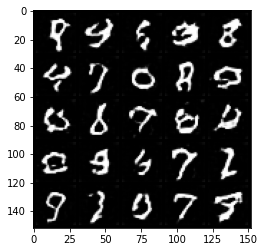

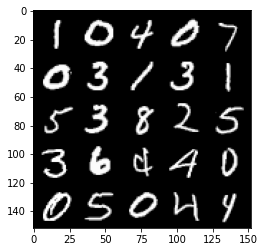

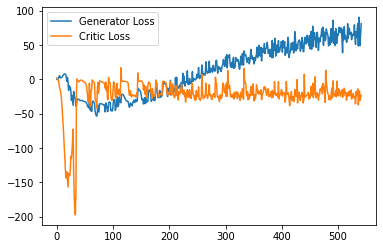

Step 10900: Generator loss: 70.6883869934082, critic loss: -11.321321113109589


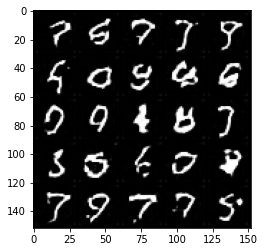

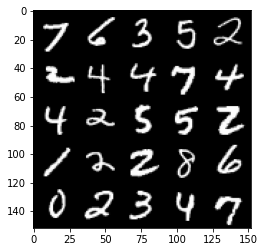

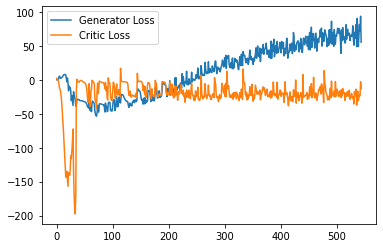

Step 10950: Generator loss: 77.96005210876464, critic loss: -17.239254121303556


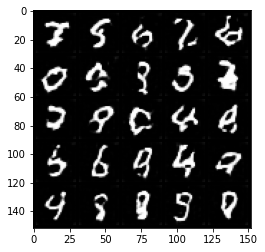

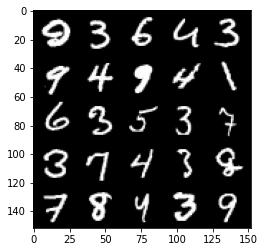

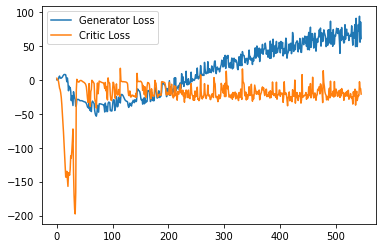

Step 11000: Generator loss: 74.3002850341797, critic loss: -17.402745241641995


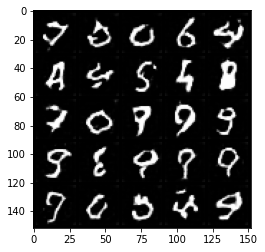

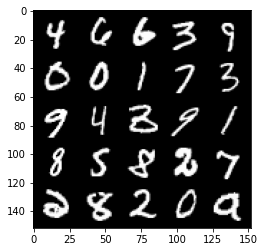

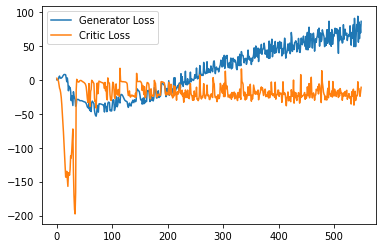

Step 11050: Generator loss: 53.46574691772461, critic loss: -35.38111377763748


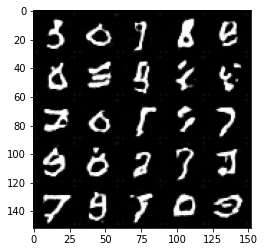

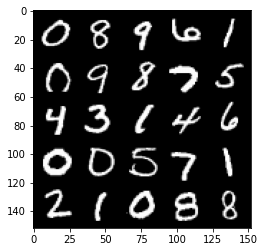

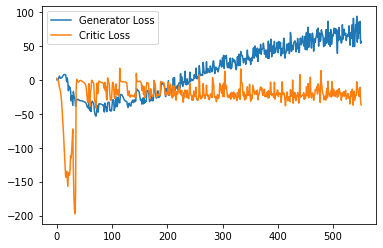

Step 11100: Generator loss: 78.6245011138916, critic loss: 0.817987800121307


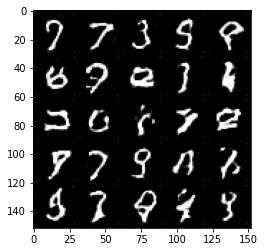

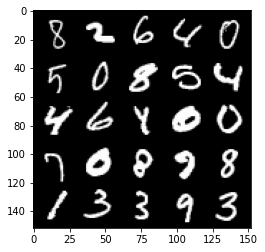

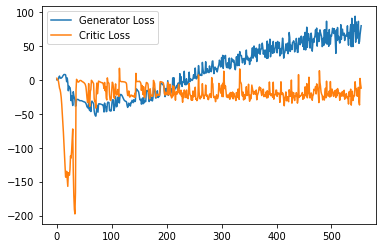

Step 11150: Generator loss: 73.98093654632568, critic loss: -26.47999374580383


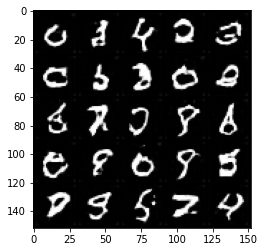

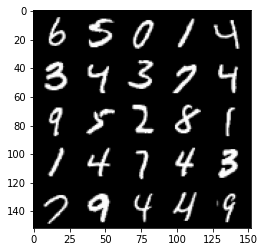

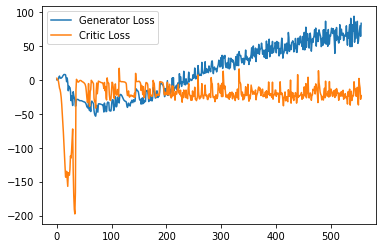

Step 11200: Generator loss: 58.05569438934326, critic loss: -31.345400155544283


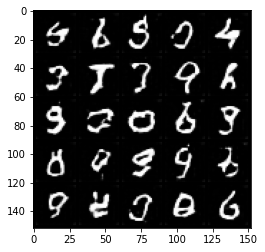

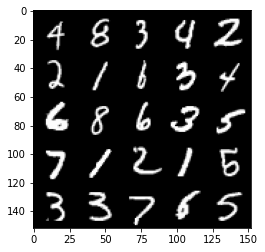

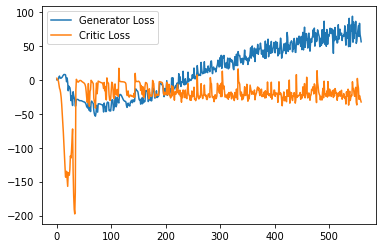

Step 11250: Generator loss: 67.07201697349548, critic loss: -23.120978899478914


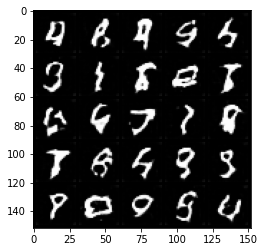

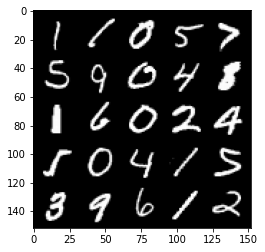

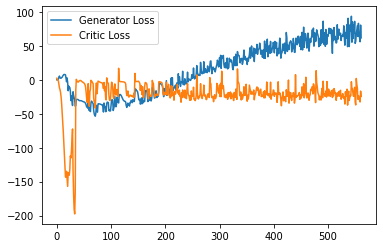

Step 11300: Generator loss: 77.8611689376831, critic loss: -26.923325725078584


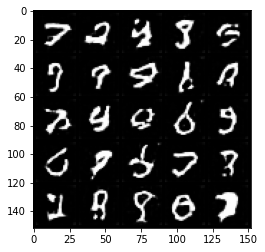

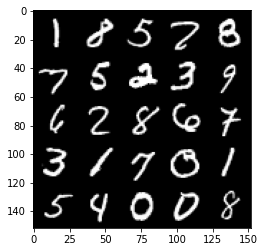

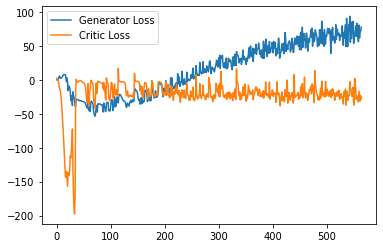

Step 11350: Generator loss: 78.42252758026123, critic loss: -25.02295219993591


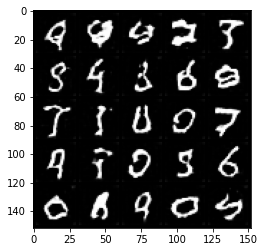

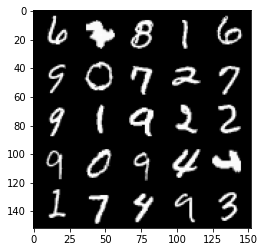

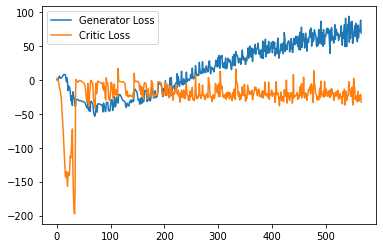

Step 11400: Generator loss: 78.68499813079833, critic loss: -17.543254382133483


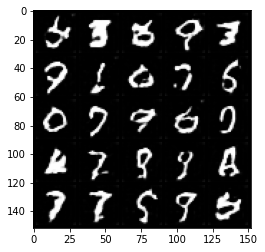

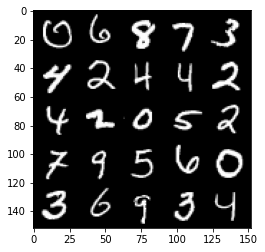

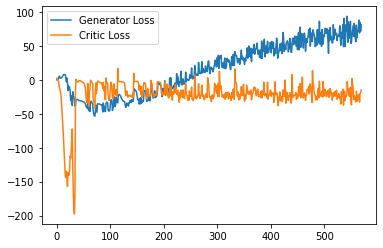

Step 11450: Generator loss: 73.70770328521729, critic loss: -23.364984219074245


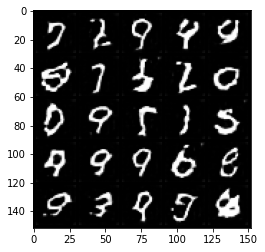

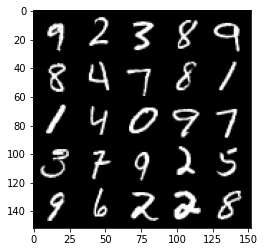

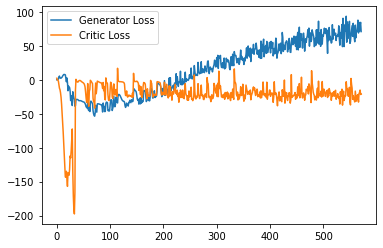

Step 11500: Generator loss: 74.75542541503906, critic loss: -20.808541839599613


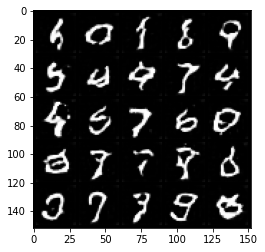

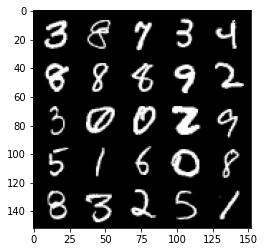

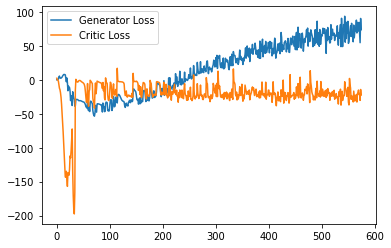

Step 11550: Generator loss: 73.90573265075683, critic loss: -24.32724749851226


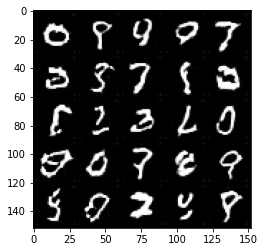

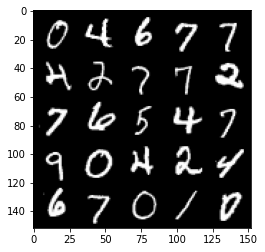

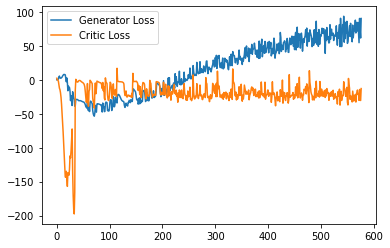

Step 11600: Generator loss: 83.11750701904298, critic loss: -17.253104732990263


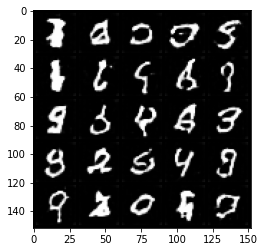

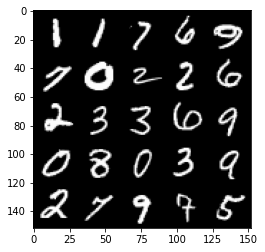

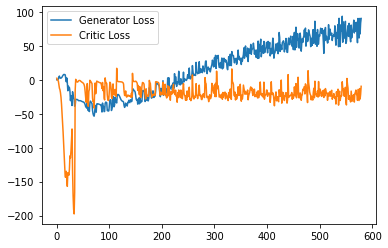

Step 11650: Generator loss: 67.92098411560059, critic loss: -26.498427742004395


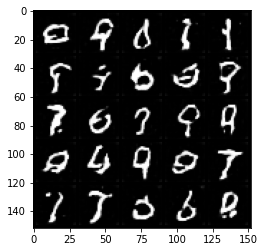

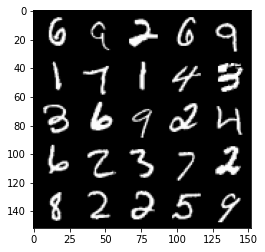

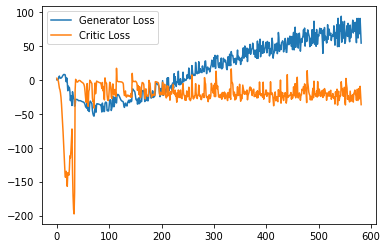

Step 11700: Generator loss: 84.00680007934571, critic loss: -18.836120586395268


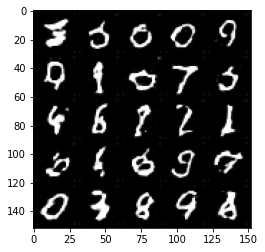

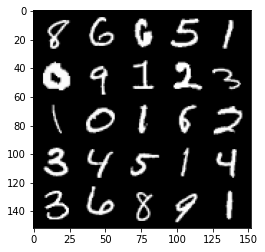

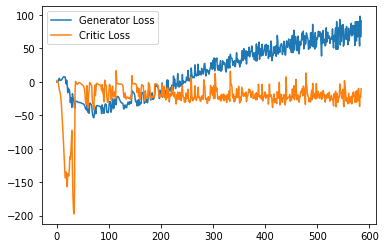

Step 11750: Generator loss: 63.910497131347654, critic loss: -22.700307722330095


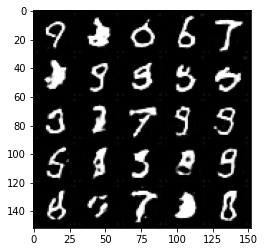

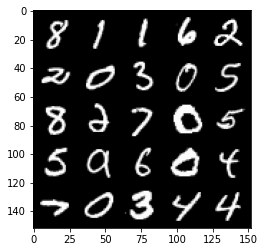

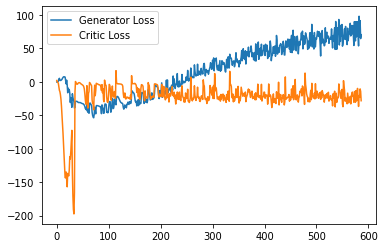

Step 11800: Generator loss: 73.9761120223999, critic loss: -26.130727505445478


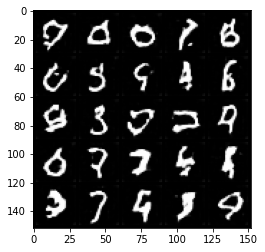

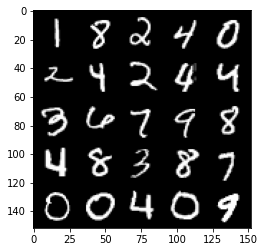

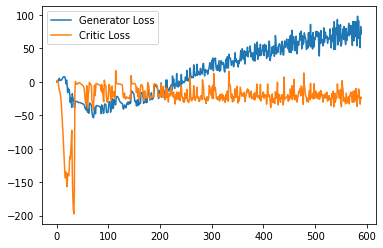

Step 11850: Generator loss: 77.01125377655029, critic loss: -25.830302657127376


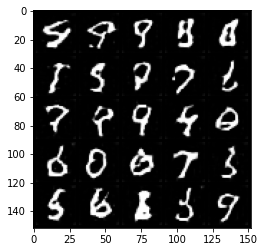

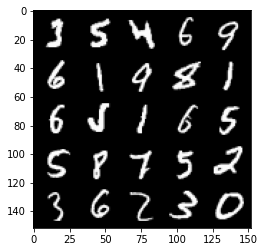

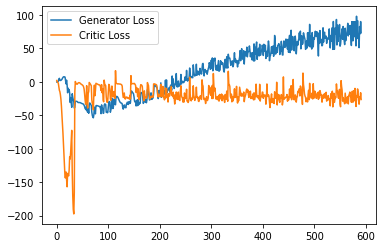

Step 11900: Generator loss: 82.4161213684082, critic loss: -25.47588389778137


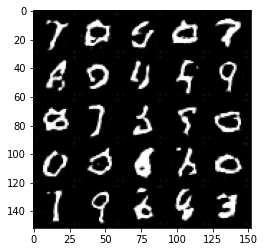

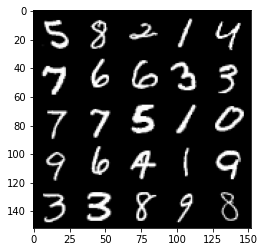

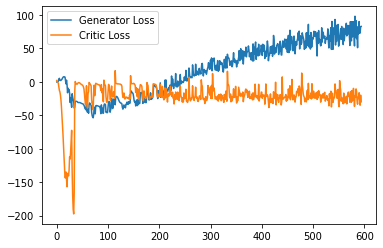

Step 11950: Generator loss: 86.27385154724121, critic loss: -20.58024390268326


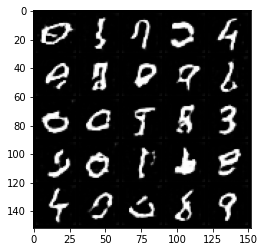

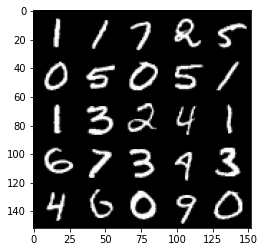

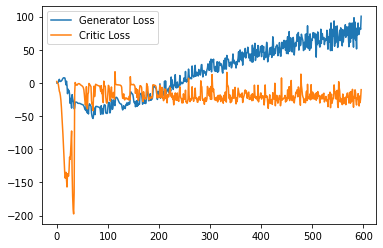

Step 12000: Generator loss: 86.41461181640625, critic loss: -15.163379666805259


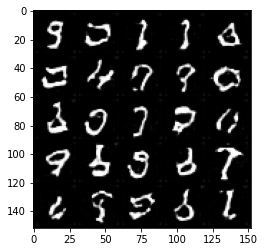

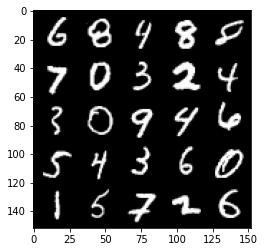

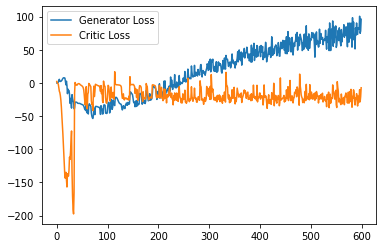

Step 12050: Generator loss: 75.67181396484375, critic loss: -25.828058951616285


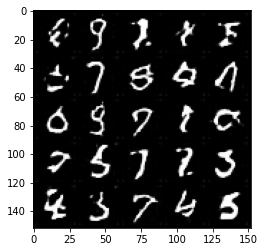

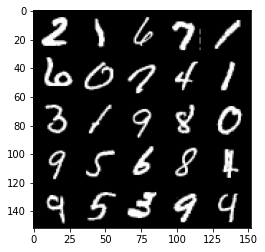

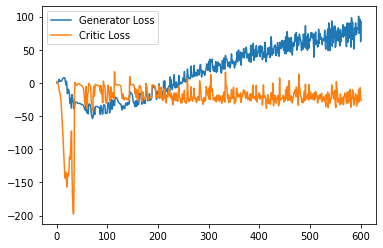

Step 12100: Generator loss: 74.45409301757813, critic loss: -17.843607296943663


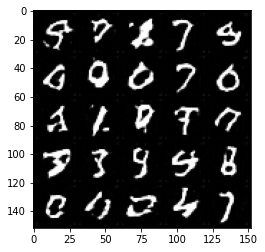

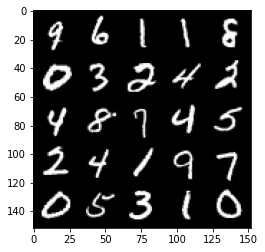

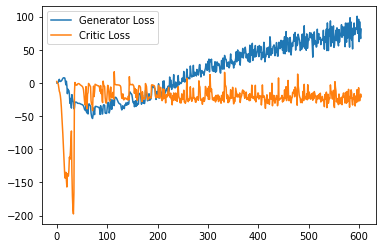

Step 12150: Generator loss: 85.16274768829345, critic loss: -16.08597916674614


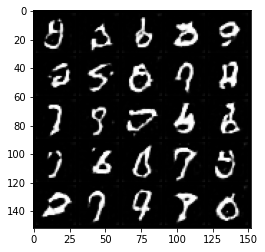

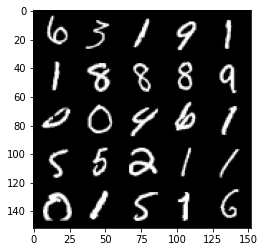

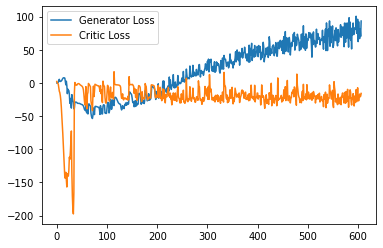

Step 12200: Generator loss: 72.5397646331787, critic loss: -23.129836081504823


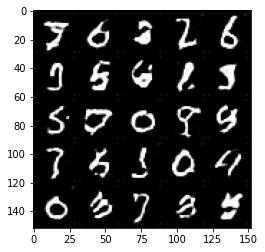

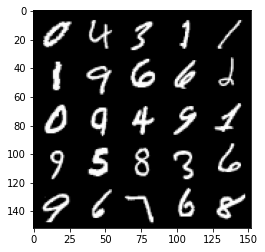

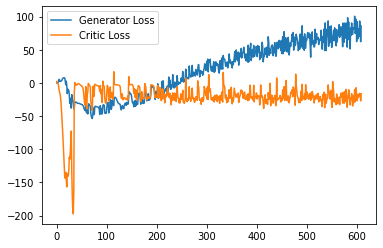

Step 12250: Generator loss: 81.96849044799805, critic loss: -16.481602387428282


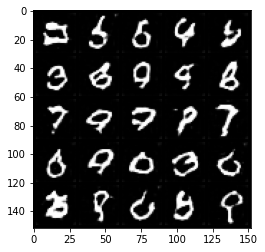

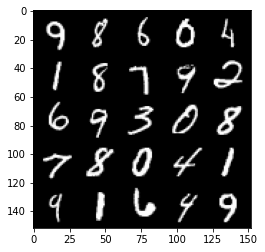

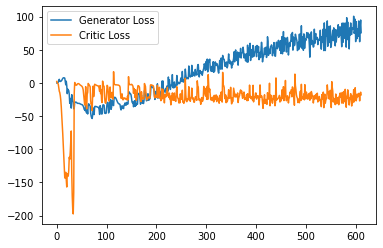

Step 12300: Generator loss: 88.23773147583007, critic loss: -25.172344068050382


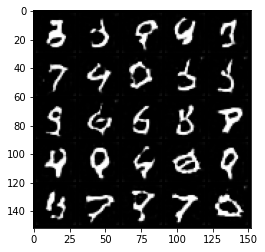

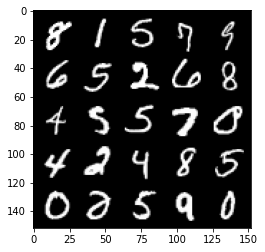

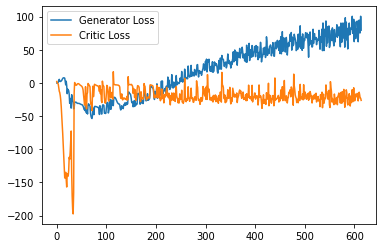

Step 12350: Generator loss: 79.21026489257812, critic loss: -20.512921269416807


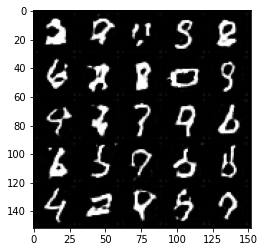

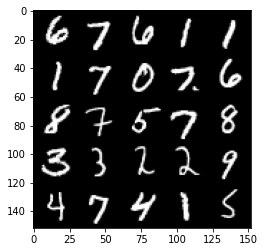

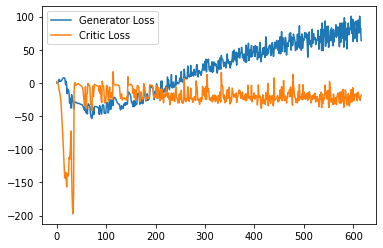

Step 12400: Generator loss: 77.68700038909913, critic loss: -22.678255477547644


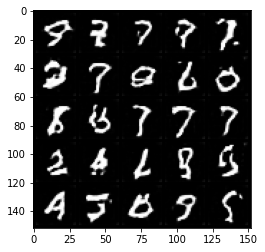

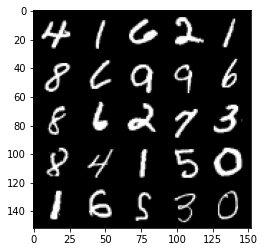

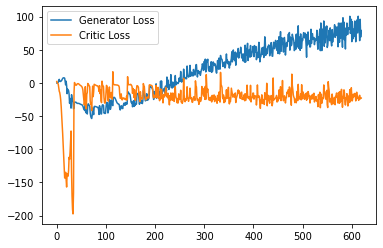

Step 12450: Generator loss: 93.35332702636718, critic loss: -10.857429751873015


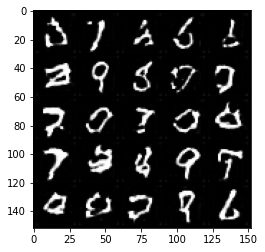

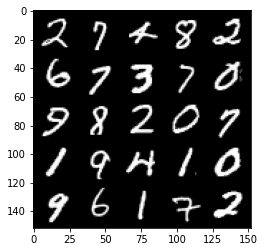

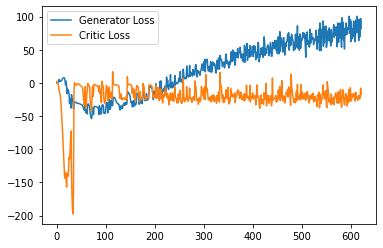

Step 12500: Generator loss: 82.54089736938477, critic loss: -20.094162882089616


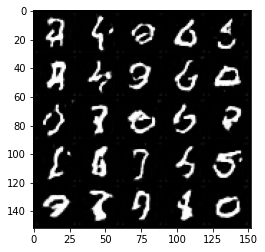

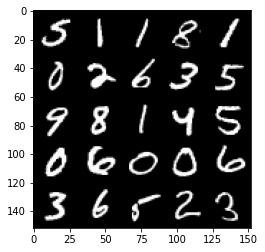

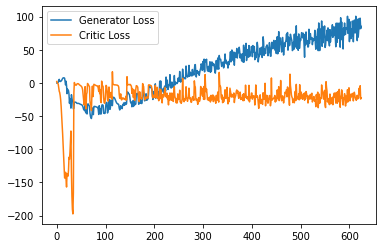

Step 12550: Generator loss: 83.900739402771, critic loss: -18.729045943498612


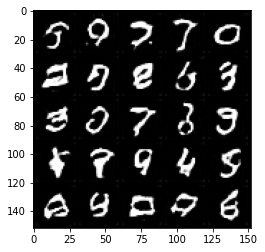

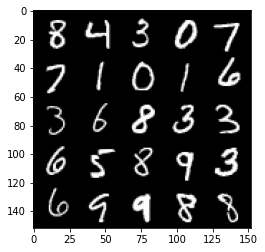

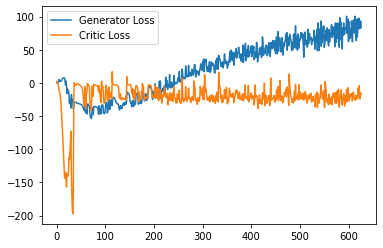

Step 12600: Generator loss: 81.74674026489258, critic loss: -23.841044029951103


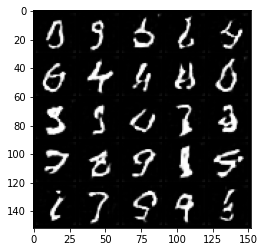

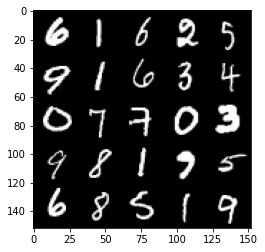

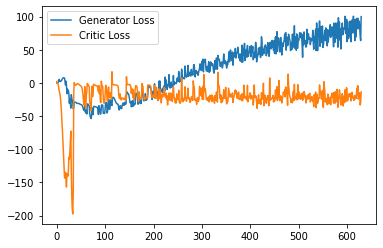

Step 12650: Generator loss: 80.4479387664795, critic loss: -22.96408603000641


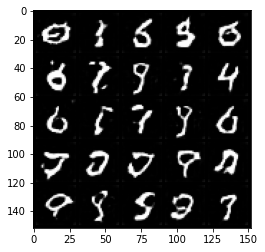

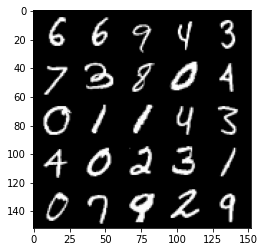

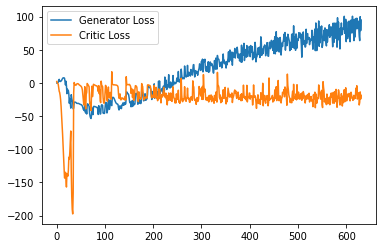

Step 12700: Generator loss: 81.9454991531372, critic loss: -26.065465575218205


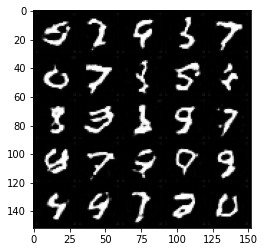

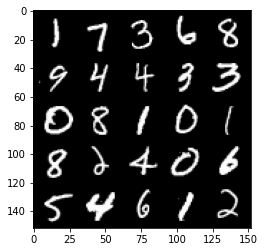

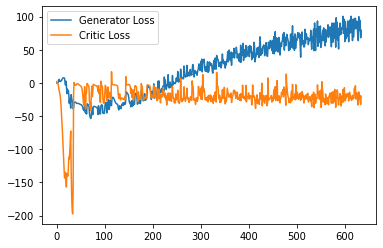

Step 12750: Generator loss: 80.45868011474609, critic loss: -25.97030032444


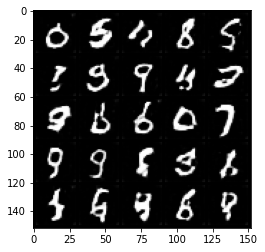

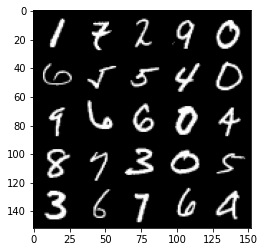

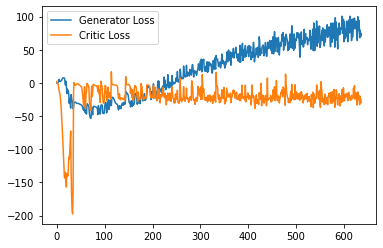

Step 12800: Generator loss: 79.43418083190917, critic loss: -24.709959774971015


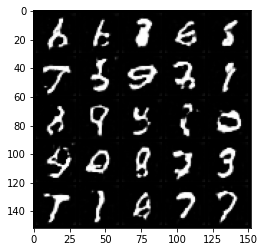

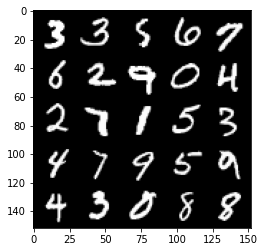

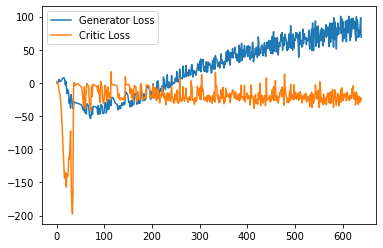

Step 12850: Generator loss: 89.2760894393921, critic loss: -42.41686502170563


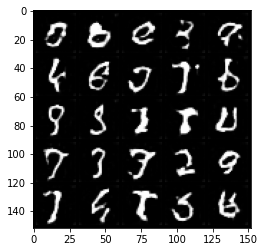

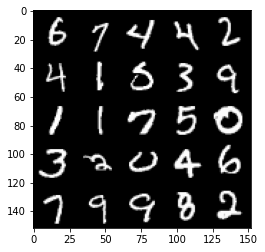

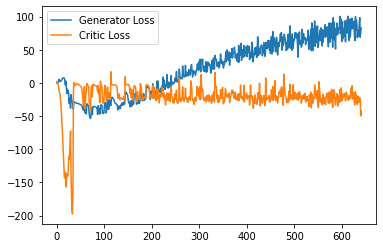

Step 12900: Generator loss: 84.89034198760986, critic loss: -17.059063353836535


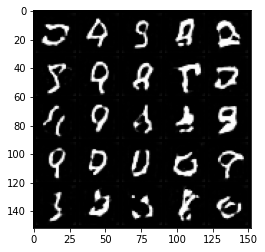

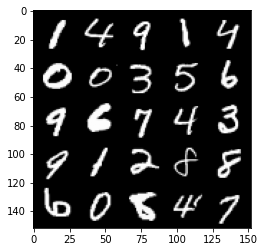

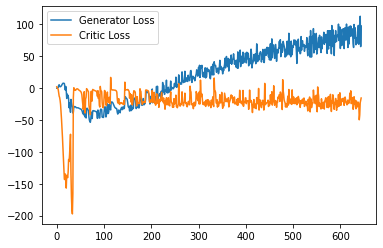

Step 12950: Generator loss: 81.2434693145752, critic loss: -25.907159502506257


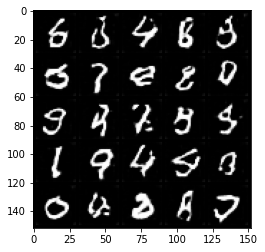

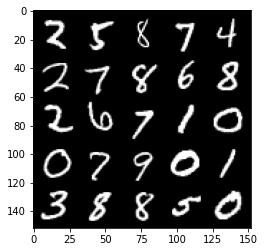

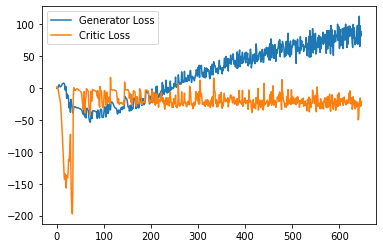

Step 13000: Generator loss: 91.13893051147461, critic loss: -18.460757599830625


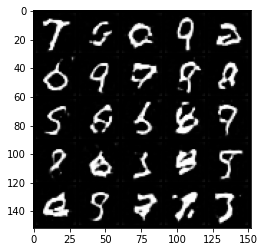

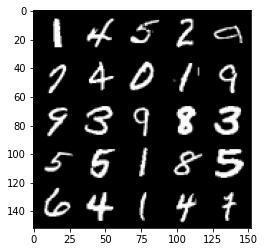

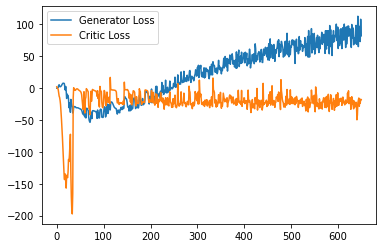

Step 13050: Generator loss: 83.20268043518067, critic loss: -26.63927122175694


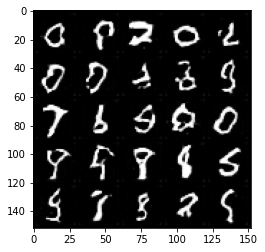

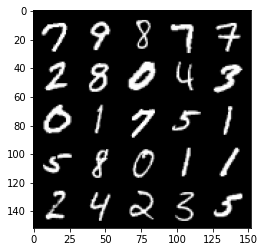

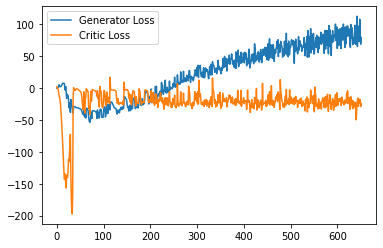

Step 13100: Generator loss: 87.12759216308594, critic loss: -18.74731306552887


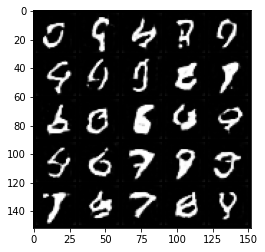

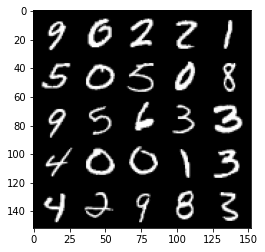

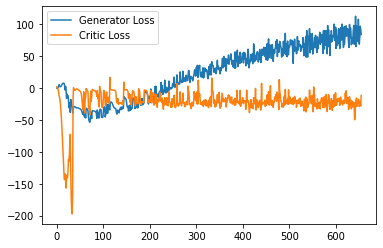

Step 13150: Generator loss: 91.14351272583008, critic loss: -15.006186725854873


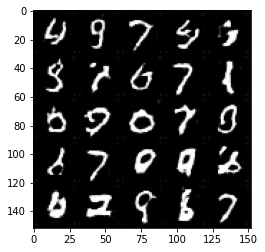

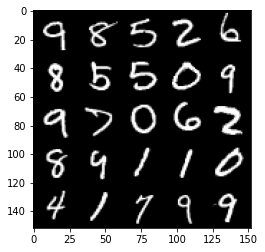

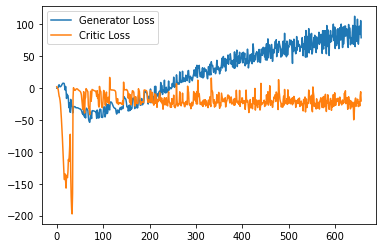

Step 13200: Generator loss: 86.15863887786865, critic loss: -15.951241428852084


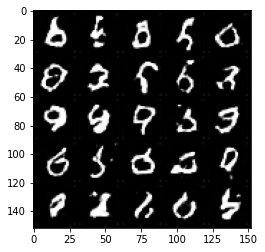

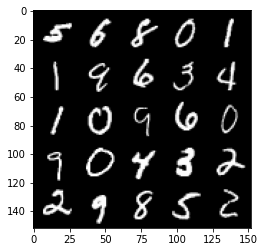

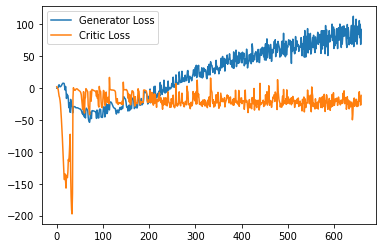

Step 13250: Generator loss: 96.81288082122802, critic loss: -22.353087640285494


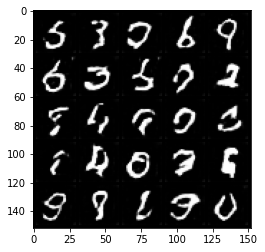

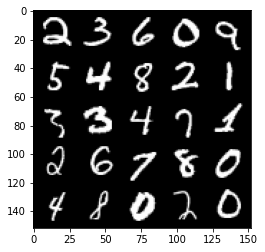

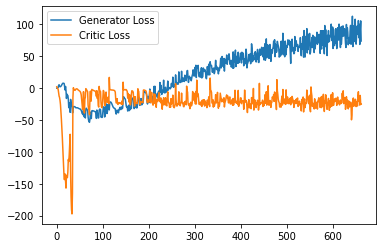

Step 13300: Generator loss: 81.54794441223144, critic loss: -18.202687249183658


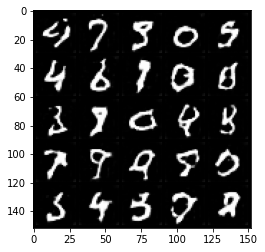

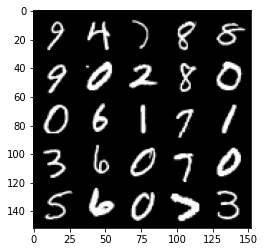

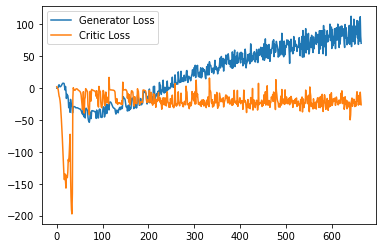

Step 13350: Generator loss: 89.41577156066894, critic loss: -17.834295661926276


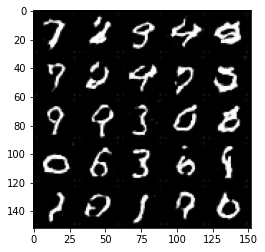

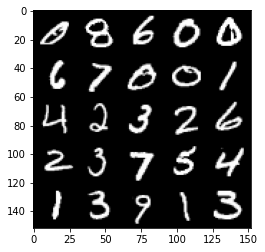

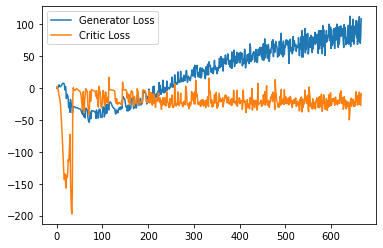

Step 13400: Generator loss: 90.14400146484375, critic loss: -16.87921678757668


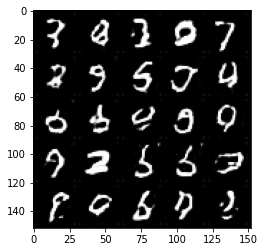

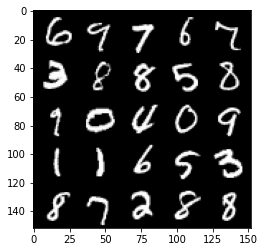

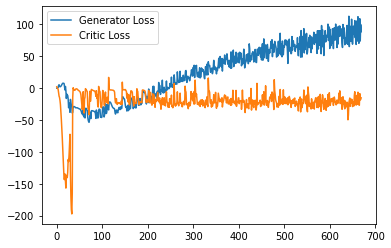

Step 13450: Generator loss: 92.09220764160156, critic loss: -2.8843161265850084


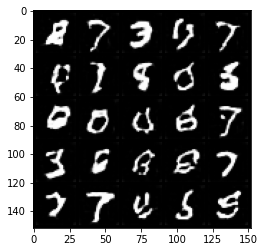

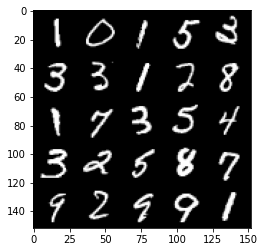

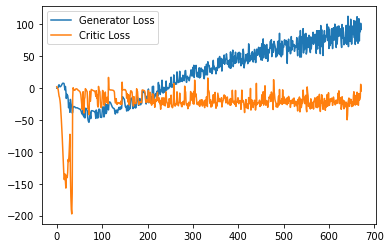

Step 13500: Generator loss: 90.97686866760255, critic loss: -16.868540625452987


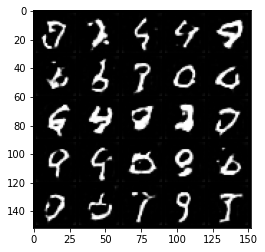

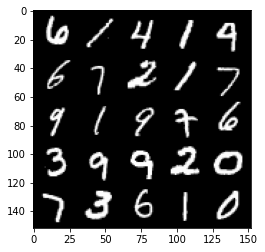

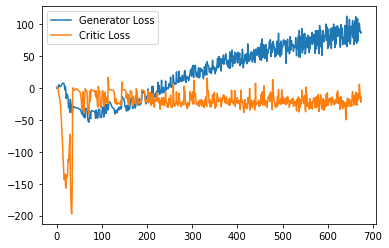

Step 13550: Generator loss: 86.26577423095704, critic loss: -19.658121185779574


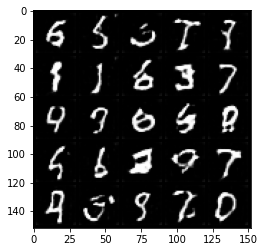

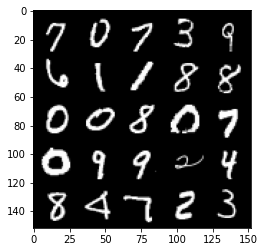

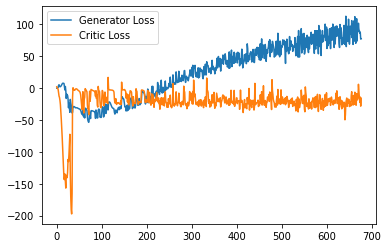

Step 13600: Generator loss: 78.57864776611328, critic loss: -23.942750831604002


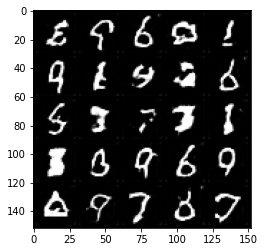

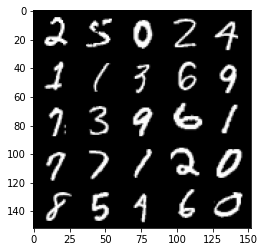

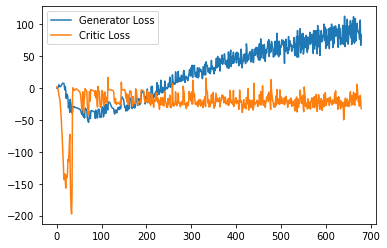

Step 13650: Generator loss: 92.55110466003418, critic loss: -19.59321460580826


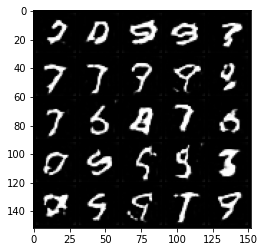

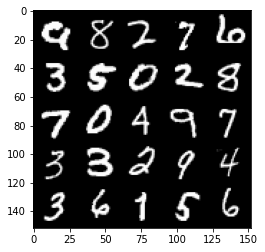

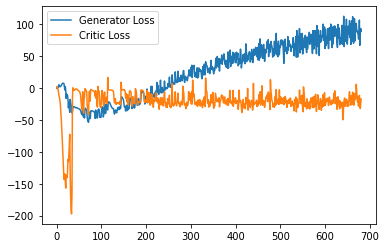

Step 13700: Generator loss: 99.39798515319825, critic loss: -22.60197730827331


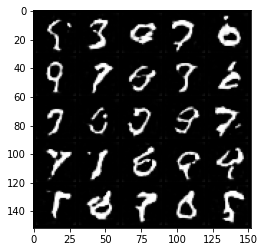

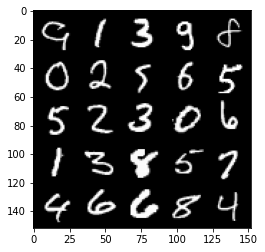

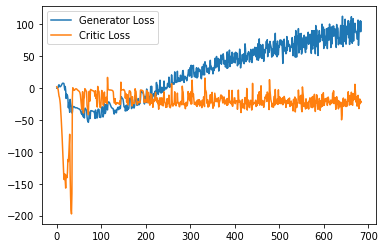

Step 13750: Generator loss: 74.63680671691894, critic loss: -22.393124421596532


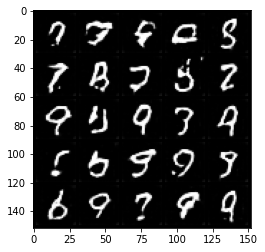

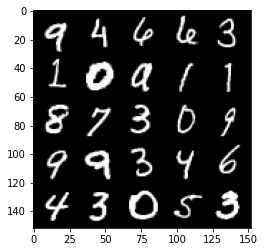

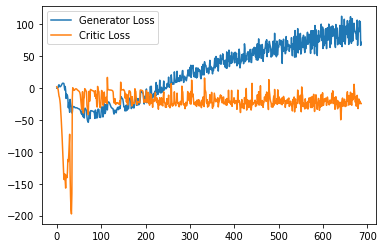

Step 13800: Generator loss: 98.33355865478515, critic loss: -23.409884172439575


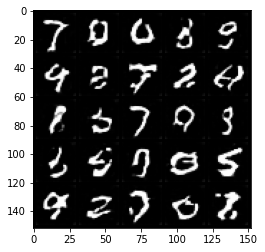

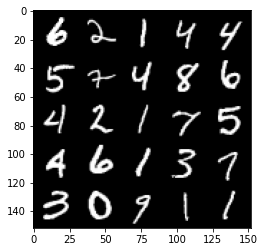

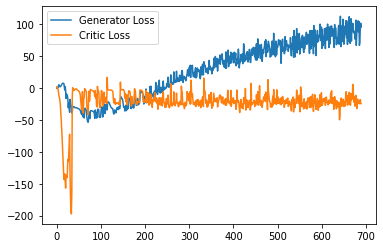

Step 13850: Generator loss: 88.56862754821778, critic loss: -16.59452689504623


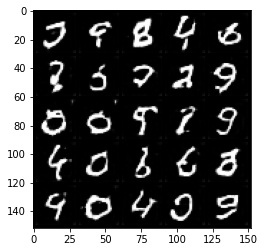

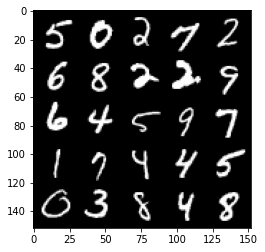

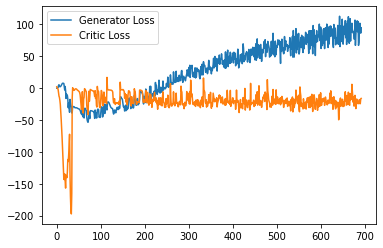

Step 13900: Generator loss: 98.45120014190674, critic loss: -13.74862114191055


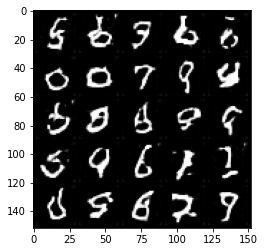

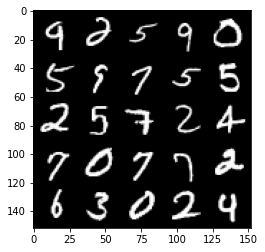

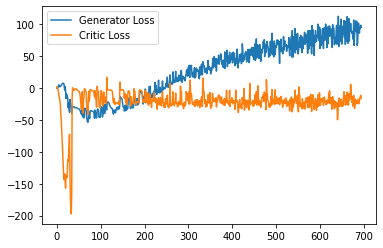

Step 13950: Generator loss: 91.60066223144531, critic loss: -24.493854597091673


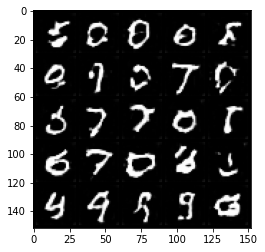

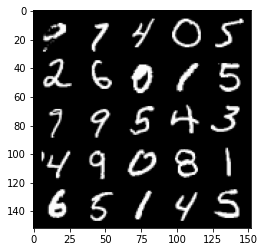

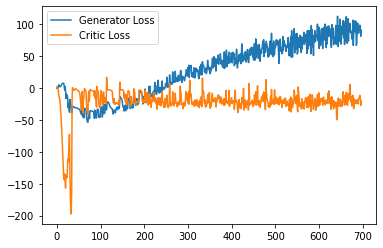

Step 14000: Generator loss: 84.43635025024415, critic loss: -21.00223945808411


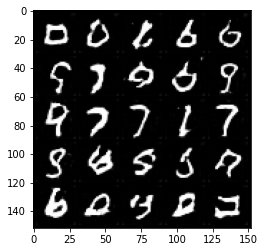

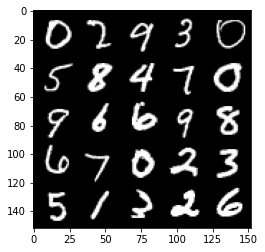

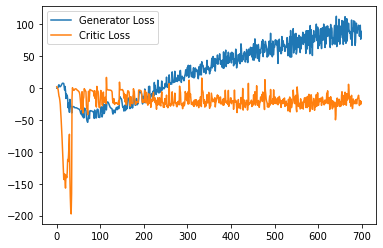

Step 14050: Generator loss: 91.60395736694336, critic loss: -27.884740981101984


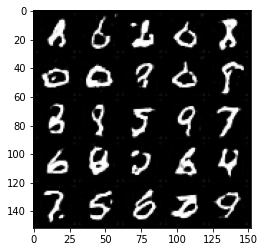

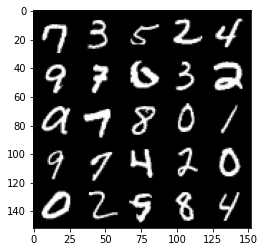

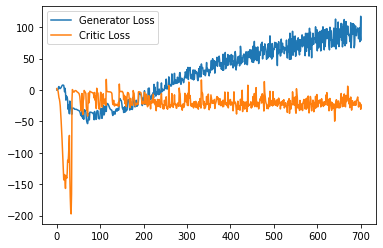

Step 14100: Generator loss: 97.01270225524902, critic loss: -23.010545710802077


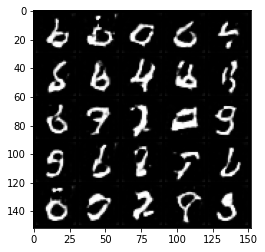

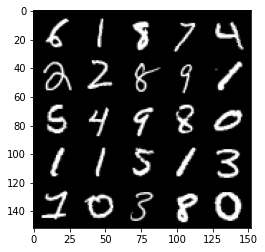

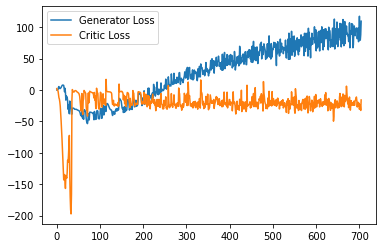

Step 14150: Generator loss: 96.2865599822998, critic loss: -24.177817121982574


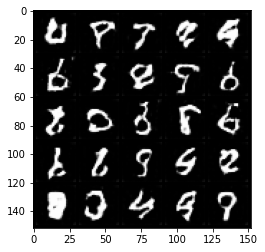

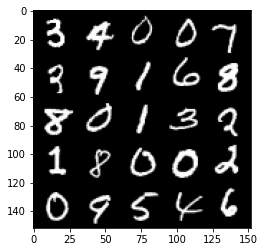

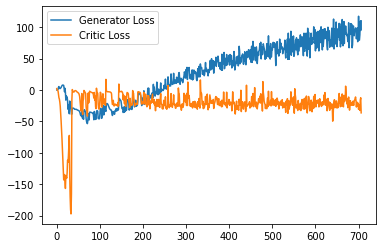

Step 14200: Generator loss: 79.87607864379883, critic loss: -22.276931226968763


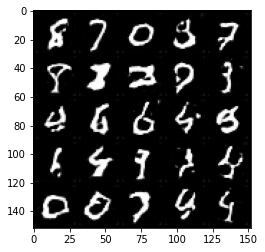

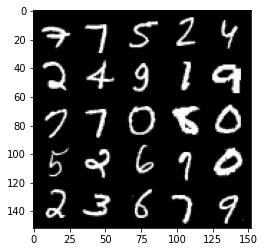

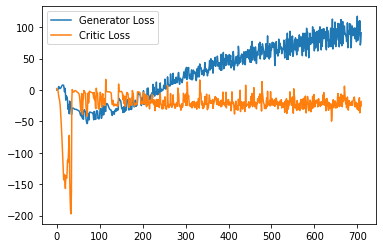

Step 14250: Generator loss: 98.10550384521484, critic loss: -15.99049431991577


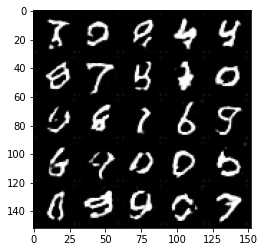

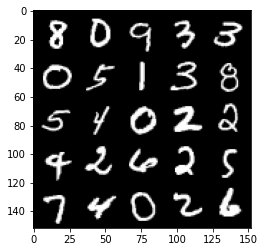

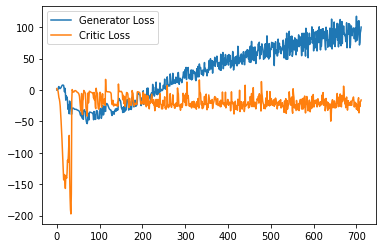

Step 14300: Generator loss: 97.46618808746338, critic loss: -19.123882479190822


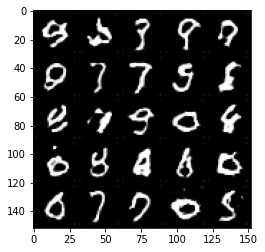

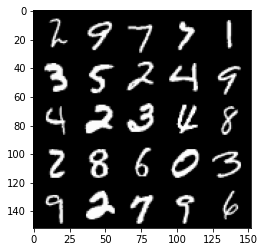

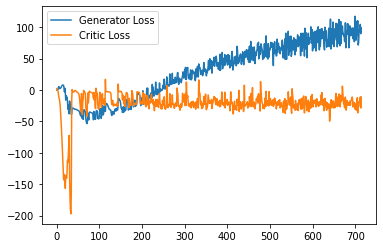

Step 14350: Generator loss: 93.67128585815429, critic loss: -21.801430986881254


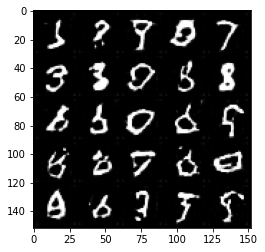

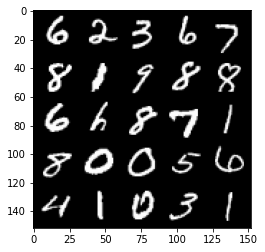

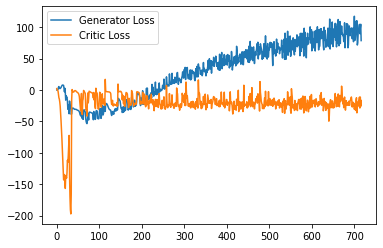

Step 14400: Generator loss: 82.25170265197754, critic loss: -23.44895100736618


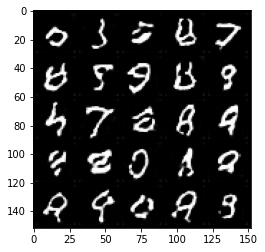

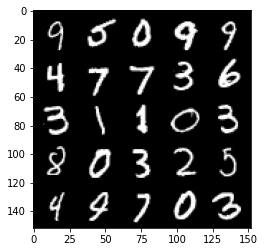

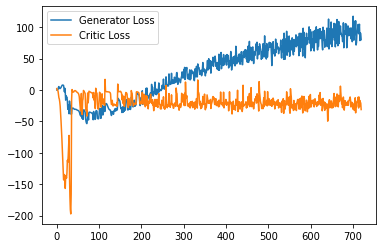

Step 14450: Generator loss: 79.80705917358398, critic loss: -27.745521785736088


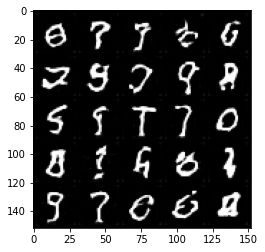

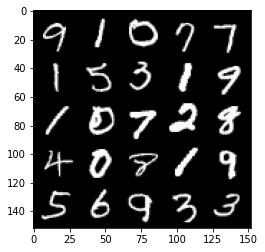

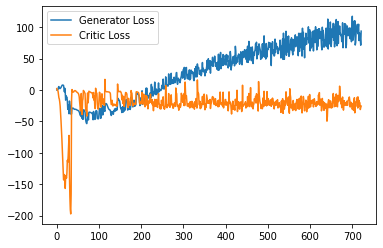

Step 14500: Generator loss: 100.56220695495605, critic loss: -23.6914847073555


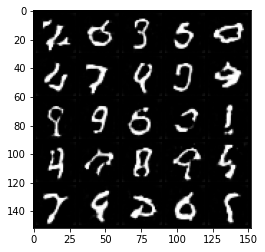

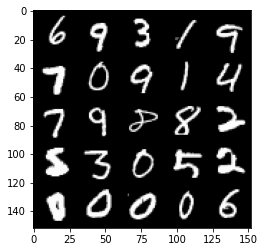

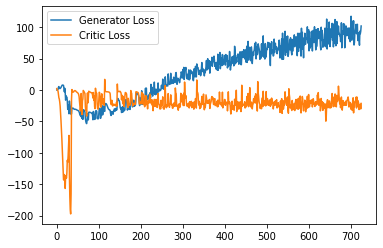

Step 14550: Generator loss: 99.95004852294922, critic loss: -16.726613755226136


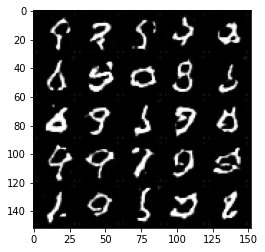

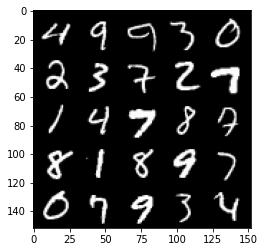

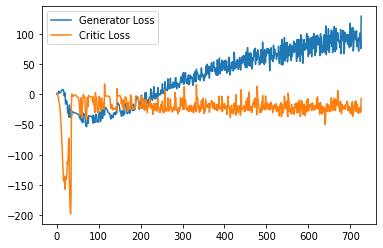

Step 14600: Generator loss: 77.62493225097656, critic loss: -10.374727952480313


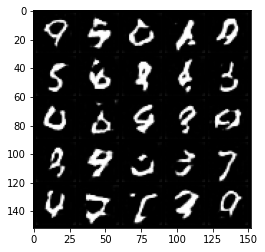

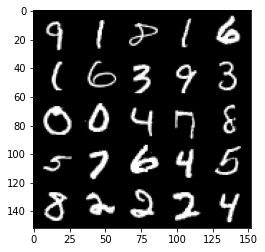

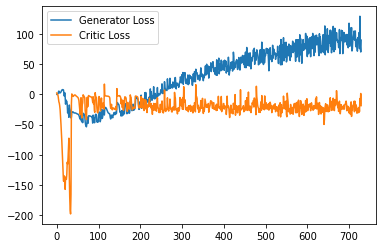

Step 14650: Generator loss: 103.9946240234375, critic loss: -18.945960850000382


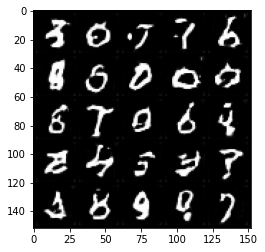

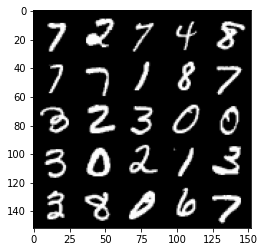

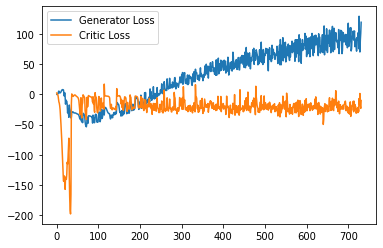

Step 14700: Generator loss: 91.31493083953858, critic loss: -23.203018400430686


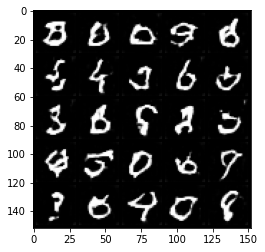

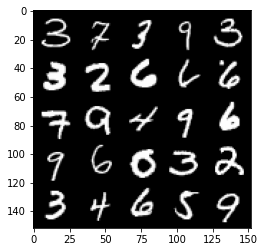

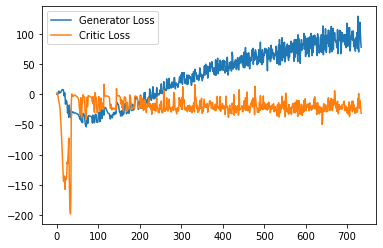

Step 14750: Generator loss: 92.42972244262695, critic loss: -24.761113324165343


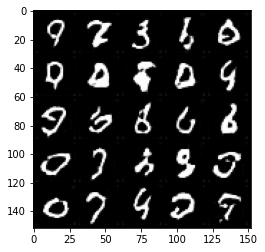

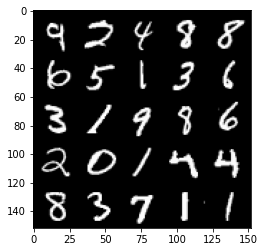

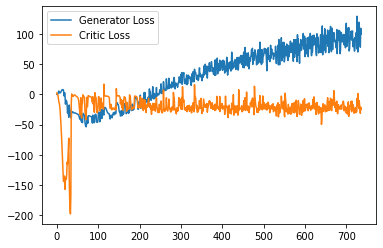

Step 14800: Generator loss: 99.26853141784667, critic loss: -27.00178155708314


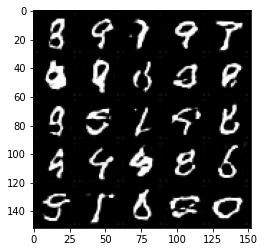

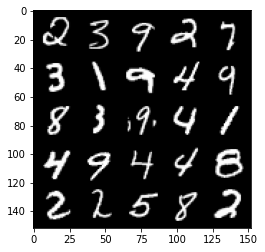

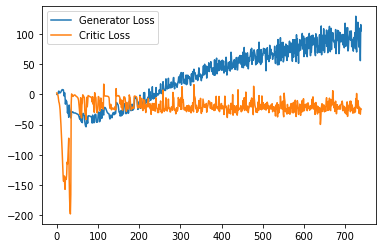

Step 14850: Generator loss: 102.21119522094726, critic loss: -21.292319511890415


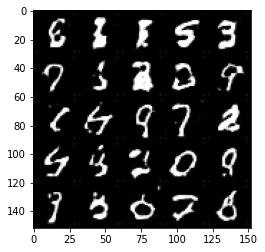

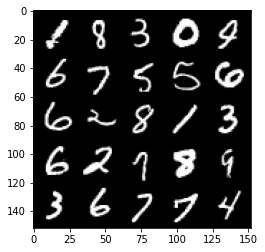

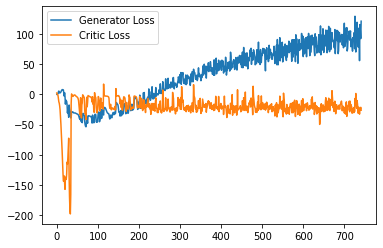

Step 14900: Generator loss: 94.14519268035889, critic loss: -25.772709007263177


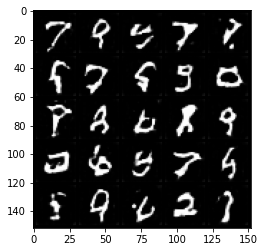

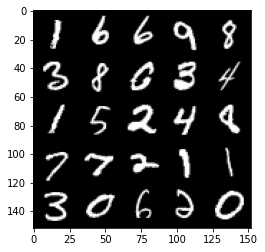

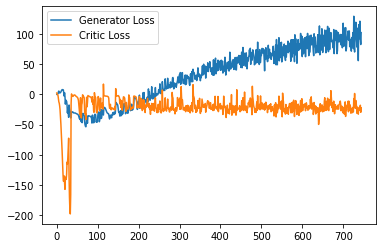

Step 14950: Generator loss: 99.72150482177734, critic loss: -23.091144298076625


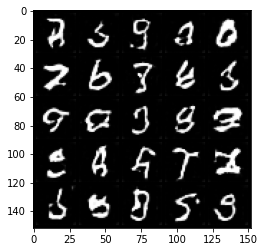

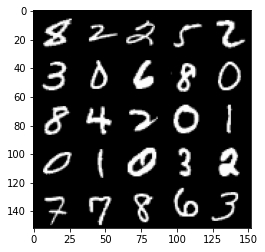

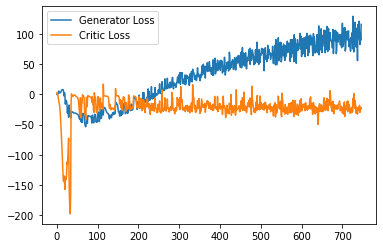

Step 15000: Generator loss: 101.56602485656738, critic loss: -25.459714742660527


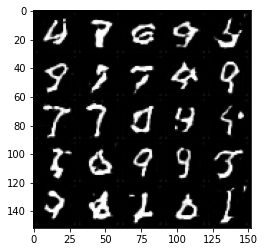

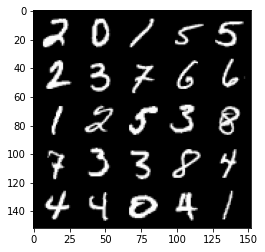

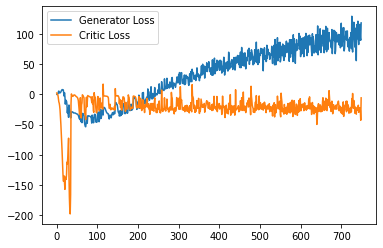

Step 15050: Generator loss: 99.77685371398925, critic loss: -17.510040103912353


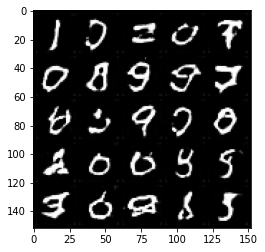

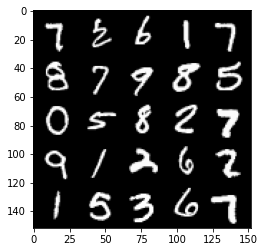

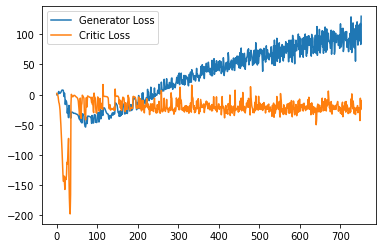

Step 15100: Generator loss: 101.76792266845703, critic loss: -25.267027034282687


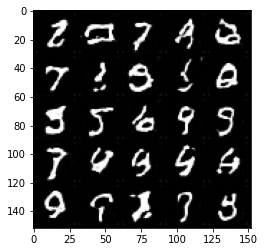

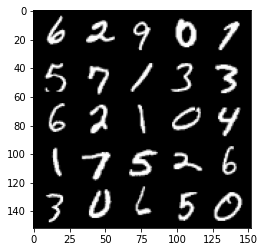

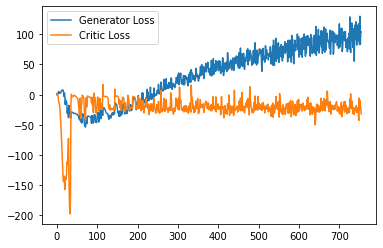

Step 15150: Generator loss: 100.80121734619141, critic loss: -20.497966003537176


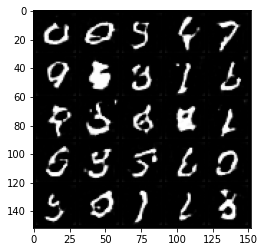

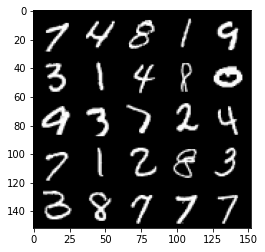

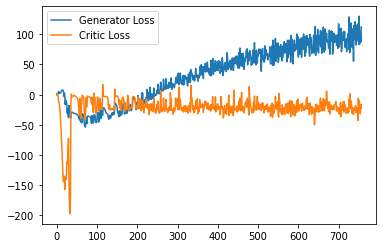

Step 15200: Generator loss: 73.59215141296387, critic loss: -31.453574288845065


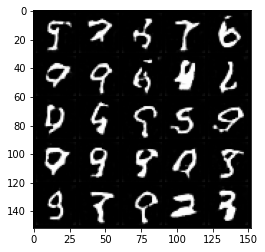

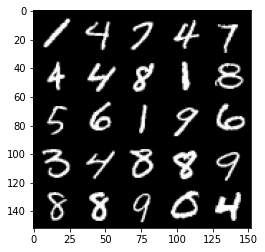

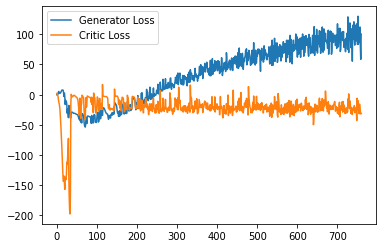

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
